# Memory 2 Agents

### Setup

In [30]:
from pyCRLD.Environments.Base import ebase

from fastcore.utils import *
from fastcore.test import *

from pyCRLD.Environments.MultipleObsSocialDilemma import MultipleObsSocialDilemma

from pyCRLD.Agents.POStrategyActorCritic import POstratAC
from pyCRLD.Utils import FlowPlot as fp

from pyCRLD.Environments.HistoryEmbedding import HistoryEmbedded, ObsActHistsIx, hOset

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

In [31]:
# def generate_obs_matrix_from_obs_set(descriptions):
#     num_states = len(descriptions)  # Total number of states
#     matrix = np.zeros((num_states, num_states))  # Initialize the observation matrix

#     # Iterate over each description for both observed and comparing state
#     for i, observed_desc in enumerate(descriptions):
#         observed_parts = observed_desc.strip('|').split(',')
#         for j, comparing_desc in enumerate(descriptions):
#             comparing_parts = comparing_desc.strip('|').split(',')
#             match = True  # Assume it's a match until proven otherwise
            
#             # Check for full observability in the observed description
#             full_obs = all(part != '.' for part in observed_parts)
            
#             if full_obs:
#                 # Direct comparison for fully observable states
#                 match = observed_parts == comparing_parts
#             else:
#                 # For partially observable states, '.' is treated as a wildcard
#                 for obs_part, comp_part in zip(observed_parts, comparing_parts):
#                     if obs_part != '.' and obs_part != comp_part:
#                         match = False
#                         break
            
#             # Assigning probability based on the match
#             matrix[i, j] = 1 if match else 0

#     # Normalize the probabilities in each row
#     for i in range(num_states):
#         row_sum = np.sum(matrix[i])
#         if row_sum > 0:
#             matrix[i] /= row_sum

#     return matrix

def generate_obs_matrix_from_obs_set(descriptions):
    num_states = len(descriptions)  # Total number of states
    matrix = np.zeros((num_states, num_states))  # Initialize the observation matrix

    # Identify if each description is fully or partially observed
    is_fully_observed = []
    for desc in descriptions:
        num_of_states = desc.count('c') + desc.count('d')
        if num_of_states == desc.count(','):
            is_fully_observed.append(True)
        else:
            is_fully_observed.append(False)

    # Iterate over each description for both observed and comparing state
    for i, observed_desc in enumerate(descriptions):
        for j, comparing_desc in enumerate(descriptions):
            if is_fully_observed[i] and i == j:
                matrix[i][j] = 1  # Fully observed states match only themselves
            elif not is_fully_observed[i]:
                observed_parts = observed_desc.replace('|', ',').split(',')
                comparing_parts = comparing_desc.replace('|', ',').split(',')
                match = True
                for obs_part, comp_part in zip(observed_parts, comparing_parts):
                    if obs_part != '.' and comp_part != '.' and obs_part != comp_part:
                        match = False
                        break
                if match:
                    matrix[i][j] = 1

    # Normalize the probabilities in each row
    for i in range(num_states):
        row_sum = np.sum(matrix[i])
        if row_sum > 0:
            matrix[i] /= row_sum

    return matrix

In [1786]:
# Create a fully observable environment
env = MultipleObsSocialDilemma(rewards=1, temptations=1.2, suckers_payoffs=-0.5, punishments=0, observation_value=[1, 1])

### Case0: agents have full observability

In [1563]:
# Define a history object
memo_ipd = HistoryEmbedded(env, h=(2,2,2))

In [1652]:
# Generate agents
mae = POstratAC(env=memo_ipd, learning_rates=0.1, discount_factors=0.9)

In [1653]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('case0.npy', Xntisa_array)
np.save('case0.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [1654]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [1655]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 975


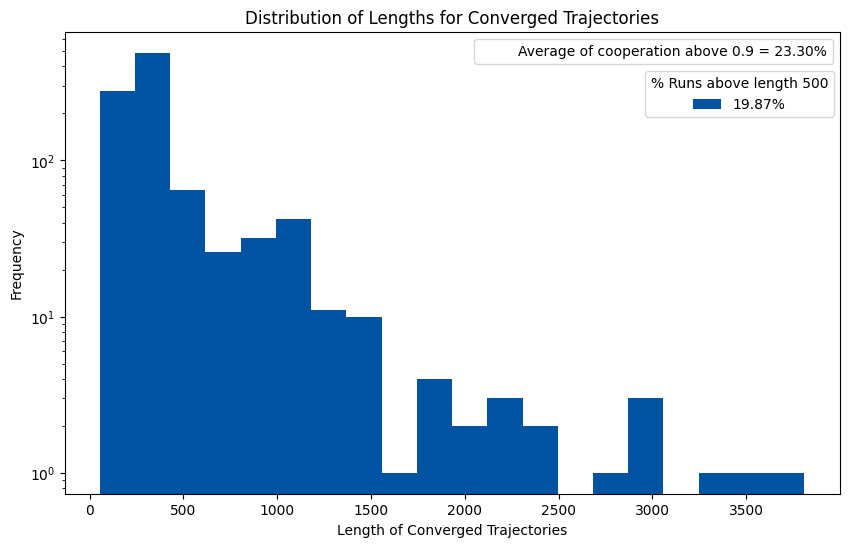

In [1656]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Plotting
plt.figure(figsize=(10, 6))
plt.hist(length_n, bins=20, log=True, color='#0254a3', label='19.87%')
plt.title('Distribution of Lengths for Converged Trajectories')
info_patch1 = plt.Line2D([0], [0], color='none', label='Average of cooperation above 0.9 = 23.30%')
first_legend = plt.legend(handles=[info_patch1], loc='upper right')
plt.gca().add_artist(first_legend)
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.legend(loc='upper left', bbox_to_anchor=(.74, .93), title="% Runs above length 500")
plt.savefig('distribution_full_obs.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI ensuring legend is included
plt.show()

In [1657]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([ 25,  50, 169, 173, 216, 302, 320, 321, 405, 431, 503, 517, 530,
       561, 641, 690, 726, 741, 742, 750, 757, 758, 760, 861, 876])

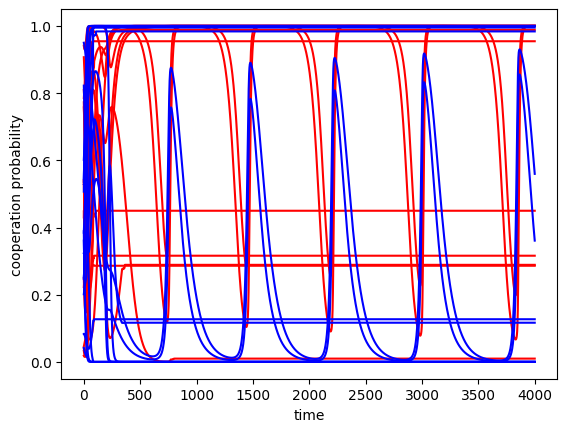

In [1658]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [1659]:
mae.obsdist(x)

Array([[0.06830116, 0.05047251, 0.05565878, 0.05286177, 0.04234815,
        0.06779902, 0.04818288, 0.10465748, 0.04834716, 0.06706414,
        0.04592999, 0.04133487, 0.06829777, 0.07765187, 0.05290447,
        0.10818804],
       [0.06830116, 0.05047251, 0.05565878, 0.05286177, 0.04234815,
        0.06779902, 0.04818288, 0.10465748, 0.04834716, 0.06706414,
        0.04592999, 0.04133487, 0.06829777, 0.07765187, 0.05290447,
        0.10818804]], dtype=float32)

Text(0, 0.5, 'average reward')

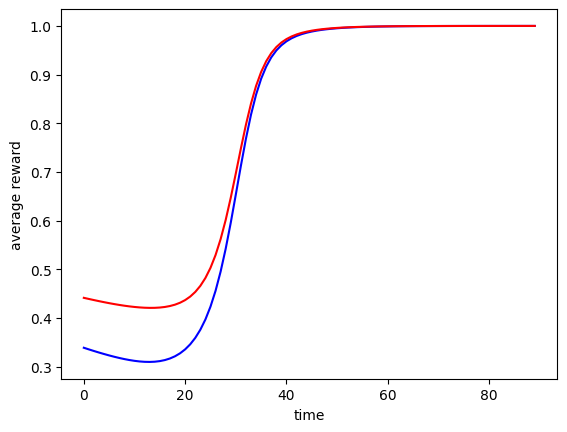

In [1660]:
Rti = np.array([mae.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

In [1661]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(975, 2, 16, 2)

In [1662]:
finalRni = np.array([mae.Ri(Xisa) for Xisa in finalXnisa])

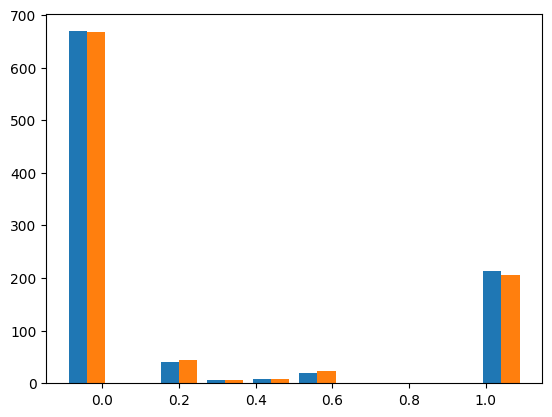

In [1663]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

In [1664]:
# Count the number of trajectories below length 520
below_520 = sum(1 for length in length_n if length < 500)

# Count the number of trajectories of length 520 or more
at_or_above_520 = len(length_n) - below_520

# Calculate percentage of each category
percentage_below_520 = (below_520 / len(length_n)) * 100
percentage_at_or_above_520 = (at_or_above_520 / len(length_n)) * 100

percentage_below_520, percentage_at_or_above_520

(82.97435897435898, 17.025641025641026)

rate.    below 500               above 500       agent 0              agent 1

0.65 (94.05737704918032, 5.942622950819672) 13.524590163934427  13.114754098360656

0.65 (93.92712550607287, 6.0728744939271255) 13.259109311740891 13.663967611336034

1.15 (76.4519535374868, 23.5480464625132) 20.802534318901795     20.4857444561774

1.35 (70.44025157232704, 29.559748427672954) 20.802534318901795   20.4857444561774

1.65 (66.56472986748216, 33.43527013251784) 19.571865443425075 18.654434250764528

2.5 (55.11247443762781, 44.88752556237219) 21.779141104294478 22.597137014314928

5 (42.44984160506864, 57.55015839493136) 23.020063357972546 20.16895459345301

10 (23.295454545454543, 76.70454545454545) 22.15909090909091 20.0

0.9 (82.97435897435898, 17.025641025641026) 22.87179487179487 21.641025641025642

**Percentage going to cooperation:**

In [1665]:
np.mean(finalRni[:,0] > 0.9) * 100

22.87179487179487

In [1666]:
np.mean(finalRni[:,1] > 0.9) * 100

21.641025641025642

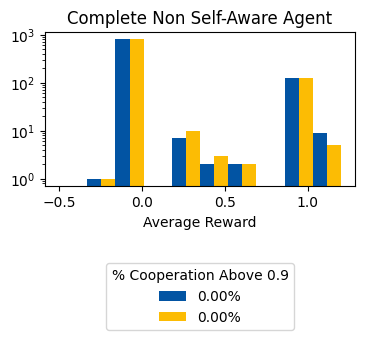

In [1526]:
plt.figure(figsize=(4, 2)) 
plt.hist([(finalRni[:,0]), (finalRni[:,1])], color=['#0254a3', '#fcbc04'], label=['0.00%','0.00%'], range=(-.5, 1.2), rwidth=35, log=True)
plt.title('Complete Non Self-Aware Agent')
plt.legend(loc='center', bbox_to_anchor=(.5, -0.72), title="% Cooperation Above 0.9")
plt.xlabel('Average Reward');

### Case1: Agents only remember what they did

In [1667]:
# Define a history object
memo_ipd = HistoryEmbedded(env, h=(2,2,2))

In [1668]:
memo_ipd.Oset[0] =  ['c,.,.|c,.,.|',
                     'c,.,.|c,.,.|',
                     'c,.,.|d,.,.|',
                     'c,.,.|d,.,.|',
                     'c,.,.|c,.,.|',
                     'c,.,.|c,.,.|',
                     'c,.,.|d,.,.|',
                     'c,.,.|d,.,.|',
                     'd,.,.|c,.,.|',
                     'd,.,.|c,.,.|',
                     'd,.,.|d,.,.|',
                     'd,.,.|d,.,.|',
                     'd,.,.|c,.,.|',
                     'd,.,.|c,.,.|',
                     'd,.,.|d,.,.|',
                     'd,.,.|d,.,.|']

In [1669]:
memo_ipd.Oset[1] =  ['.,c,.|.,c,.|',
                     '.,c,.|.,d,.|',
                     '.,c,.|.,c,.|',
                     '.,c,.|.,d,.|',
                     '.,d,.|.,c,.|',
                     '.,d,.|.,d,.|',
                     '.,d,.|.,c,.|',
                     '.,d,.|.,d,.|',
                     '.,c,.|.,c,.|',
                     '.,c,.|.,d,.|',
                     '.,c,.|.,c,.|',
                     '.,c,.|.,d,.|',
                     '.,d,.|.,c,.|',
                     '.,d,.|.,d,.|',
                     '.,d,.|.,c,.|',
                     '.,d,.|.,d,.|']

In [1670]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd.O[0] = generate_obs_matrix_from_obs_set(memo_ipd.Oset[0])
memo_ipd.O[1] = generate_obs_matrix_from_obs_set(memo_ipd.Oset[1])

In [1671]:
# Checking the observation set
memo_ipd.O

array([[[0.25, 0.25, 0.  , 0.  , 0.25, 0.25, 0.  , 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.25, 0.25, 0.  , 0.  , 0.25, 0.25, 0.  , 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.25, 0.25, 0.  , 0.  , 0.25, 0.25, 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.25, 0.25, 0.  , 0.  , 0.25, 0.25, 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.25, 0.25, 0.  , 0.  , 0.25, 0.25, 0.  , 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.25, 0.25, 0.  , 0.  , 0.25, 0.25, 0.  , 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.25, 0.25, 0.  , 0.  , 0.25, 0.25, 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.25, 0.25, 0.  , 0.  , 0.25, 0.25, 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.25, 0.25,
         0.

In [1672]:
# Modify state set, so it represents the current game
state_set = []
for i in range(len(memo_ipd.Oset[0])):
    sub_set = f"a0 = {memo_ipd.Oset[0][i]} a1 = {memo_ipd.Oset[1][i]}"
    state_set.append(sub_set)
state_set

['a0 = c,.,.|c,.,.| a1 = .,c,.|.,c,.|',
 'a0 = c,.,.|c,.,.| a1 = .,c,.|.,d,.|',
 'a0 = c,.,.|d,.,.| a1 = .,c,.|.,c,.|',
 'a0 = c,.,.|d,.,.| a1 = .,c,.|.,d,.|',
 'a0 = c,.,.|c,.,.| a1 = .,d,.|.,c,.|',
 'a0 = c,.,.|c,.,.| a1 = .,d,.|.,d,.|',
 'a0 = c,.,.|d,.,.| a1 = .,d,.|.,c,.|',
 'a0 = c,.,.|d,.,.| a1 = .,d,.|.,d,.|',
 'a0 = d,.,.|c,.,.| a1 = .,c,.|.,c,.|',
 'a0 = d,.,.|c,.,.| a1 = .,c,.|.,d,.|',
 'a0 = d,.,.|d,.,.| a1 = .,c,.|.,c,.|',
 'a0 = d,.,.|d,.,.| a1 = .,c,.|.,d,.|',
 'a0 = d,.,.|c,.,.| a1 = .,d,.|.,c,.|',
 'a0 = d,.,.|c,.,.| a1 = .,d,.|.,d,.|',
 'a0 = d,.,.|d,.,.| a1 = .,d,.|.,c,.|',
 'a0 = d,.,.|d,.,.| a1 = .,d,.|.,d,.|']

In [1691]:
# Generate agents
mae = POstratAC(env=memo_ipd, learning_rates=0.1, discount_factors=10)

In [1692]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case1.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case1.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [1693]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [1694]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 423


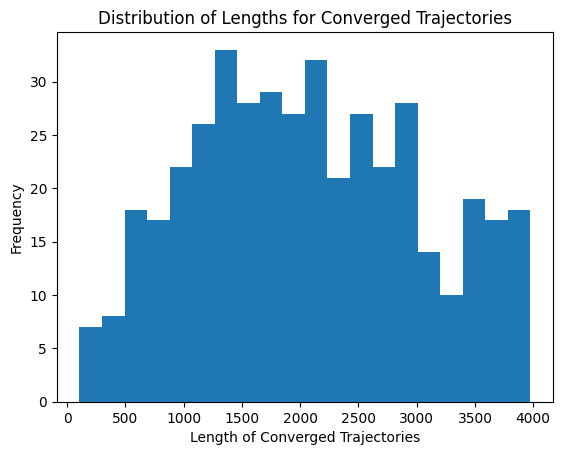

In [1695]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Analyze the distribution of final strategies' lengths if necessary
plt.hist(length_n, bins=20)
plt.title('Distribution of Lengths for Converged Trajectories')
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.show()

In [1705]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([  1,   2,   4,   5,   7,   9,  10,  11,  12,  14,  15,  16,  17,
        19,  22,  23,  28,  29,  30,  31,  33,  36,  37,  38,  39,  40,
        41,  45,  46,  50,  51,  52,  55,  59,  60,  62,  63,  64,  66,
        69,  70,  72,  73,  74,  75,  78,  79,  80,  82,  83,  84,  85,
        87,  91,  93,  94,  95,  97,  99, 100, 104, 105, 106, 108, 109,
       110, 111, 112, 113, 114, 115, 117, 119, 120, 121, 122, 123, 124,
       126, 129, 130, 134, 135, 136, 137, 141, 142, 143, 145, 146, 148,
       151, 152, 153, 154, 155, 157, 160, 161, 164, 165, 166, 167, 169,
       171, 172, 176, 178, 179, 181, 182, 184, 185, 186, 187, 189, 191,
       192, 194, 197, 198, 204, 206, 207, 208, 212, 215, 217, 219, 221,
       222, 224, 225, 226, 229, 231, 232, 233, 235, 236, 239, 240, 243,
       244, 247, 251, 252, 253, 255, 257, 258, 259, 260, 262, 263, 264,
       265, 268, 270, 272, 274, 275, 276, 277, 281, 283, 285, 287, 289,
       290, 291, 292, 293, 294, 296, 297, 298, 301, 303, 304, 30

In [1706]:
# Count the number of trajectories below length 520
below_520 = sum(1 for length in length_n if length < 500)

# Count the number of trajectories of length 520 or more
at_or_above_520 = len(length_n) - below_520

# Calculate percentage of each category
percentage_below_520 = (below_520 / len(length_n)) * 100
percentage_at_or_above_520 = (at_or_above_520 / len(length_n)) * 100

percentage_below_520, percentage_at_or_above_520

(3.546099290780142, 96.45390070921985)

In [1707]:
np.mean(finalRni[:,0] > 0.9) * 100

22.87179487179487

In [1708]:
np.mean(finalRni[:,1] > 0.9) * 100

21.641025641025642

rate belo 500 above 500         agen 1         agen 2
0.9 (100.0, 0.0)           22.87179487179487. 21.641025641025642
2 
10 (3.546099290780142, 96.45390070921985)

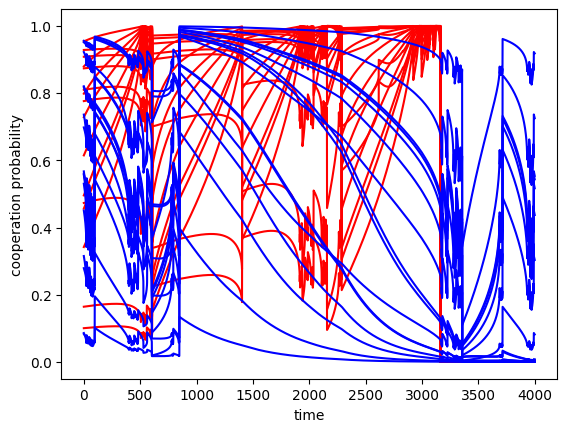

In [1709]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [534]:
mae.obsdist(x)

Array([[0.06015269, 0.06015263, 0.07228633, 0.07228635, 0.06015265,
        0.06015265, 0.07228635, 0.07228635, 0.07228634, 0.07228634,
        0.04527467, 0.04527467, 0.07228634, 0.07228634, 0.04527467,
        0.04527467],
       [0.07151242, 0.06626099, 0.07151242, 0.06626099, 0.06626101,
        0.0459656 , 0.06626101, 0.0459656 , 0.07151242, 0.06626099,
        0.07151242, 0.06626099, 0.06626101, 0.0459656 , 0.06626101,
        0.0459656 ]], dtype=float32)

Text(0, 0.5, 'average reward')

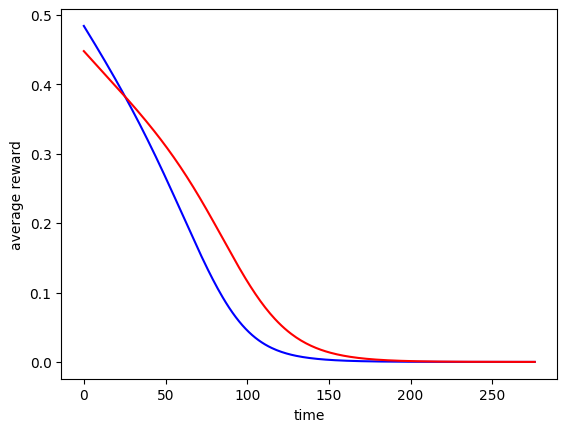

In [535]:
Rti = np.array([mae.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

In [536]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(1000, 2, 16, 2)

In [537]:
finalRni = np.array([mae.Ri(Xisa) for Xisa in finalXnisa])

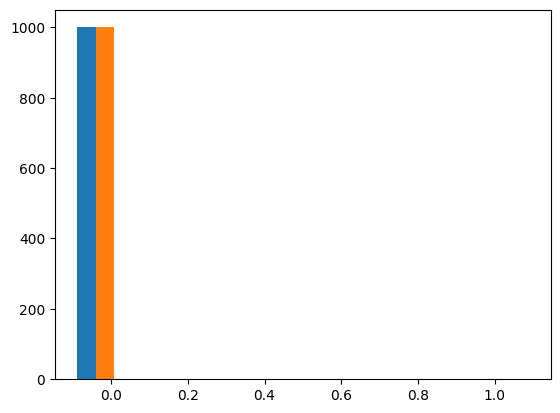

In [538]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [539]:
np.mean(finalRni[:,0] > 0.9) * 100

0.0

In [549]:
np.mean(finalRni[:,1] > 0.9) * 100

0.0

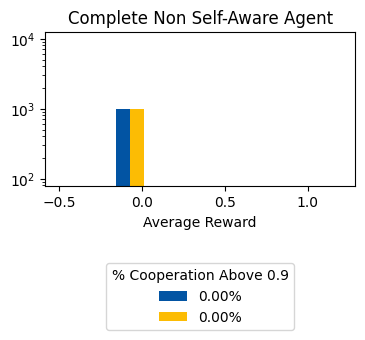

In [576]:
plt.figure(figsize=(4, 2)) 
plt.hist([(finalRni[:,0]), (finalRni[:,1])], color=['#0254a3', '#fcbc04'], label=['0.00%','0.00%'], range=(-.5, 1.2), rwidth=35, log=True)
plt.title('Complete Non Self-Aware Agent')
plt.legend(loc='center', bbox_to_anchor=(.5, -0.72), title="% Cooperation Above 0.9")
plt.xlabel('Average Reward');

In [540]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

Shape of the data for Agent 0: (2341, 2, 4, 2)
Shape of the data for Agent 1: (1941, 2, 4, 2)


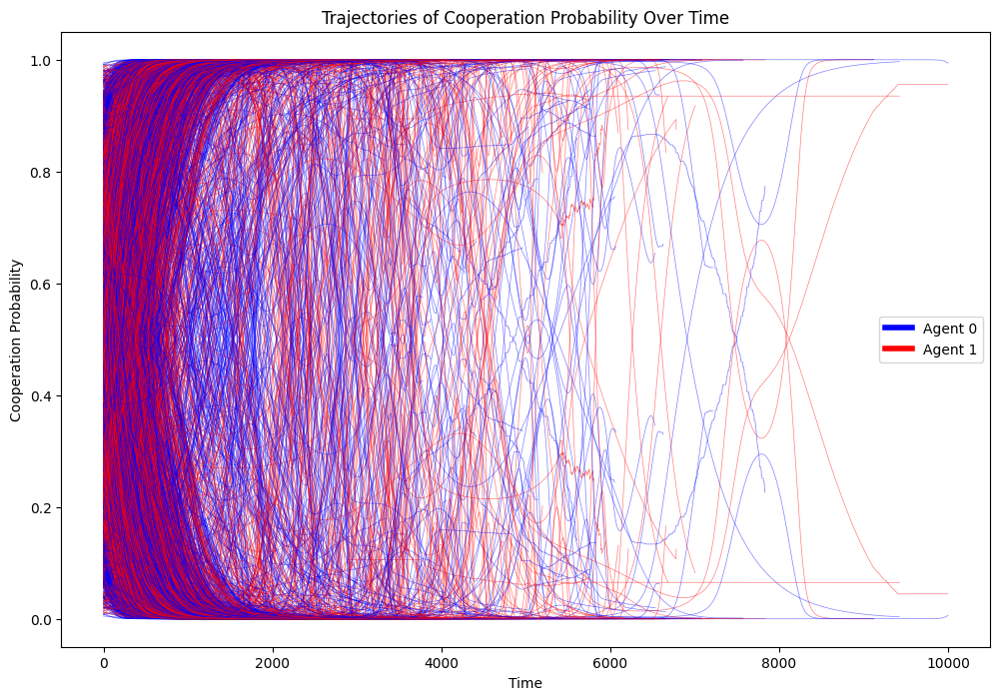

In [312]:
# Setup the plot
plt.figure(figsize=(12, 8))

# Define colors for clarity and reusability
colors = {'Agent 0': 'blue', 'Agent 1': 'red'}

# Check the shape of the data and print it
print("Shape of the data for Agent 0:", strategy_time_series[0].shape)
print("Shape of the data for Agent 1:", strategy_time_series[1].shape)

# Assume the data shape is (number of steps, number of variables, number of agents)
# We need to select which variable to plot, e.g., the first variable
variable_index = 0

# Loop through each simulation
for series in strategy_time_series:
    # Plot each trajectory for agent 0
    plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)
    # Plot each trajectory for agent 1
    plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)

# Adding plot labels and title
plt.xlabel('Time')
plt.ylabel('Cooperation Probability')
plt.title('Trajectories of Cooperation Probability Over Time')

# Create custom handles for the legend
custom_lines = [Line2D([0], [0], color=colors['Agent 0'], lw=4),
                Line2D([0], [0], color=colors['Agent 1'], lw=4)]

# Set the legend with custom handles
plt.legend(custom_lines, ['Agent 0', 'Agent 1'])

# Show the plot
plt.show()


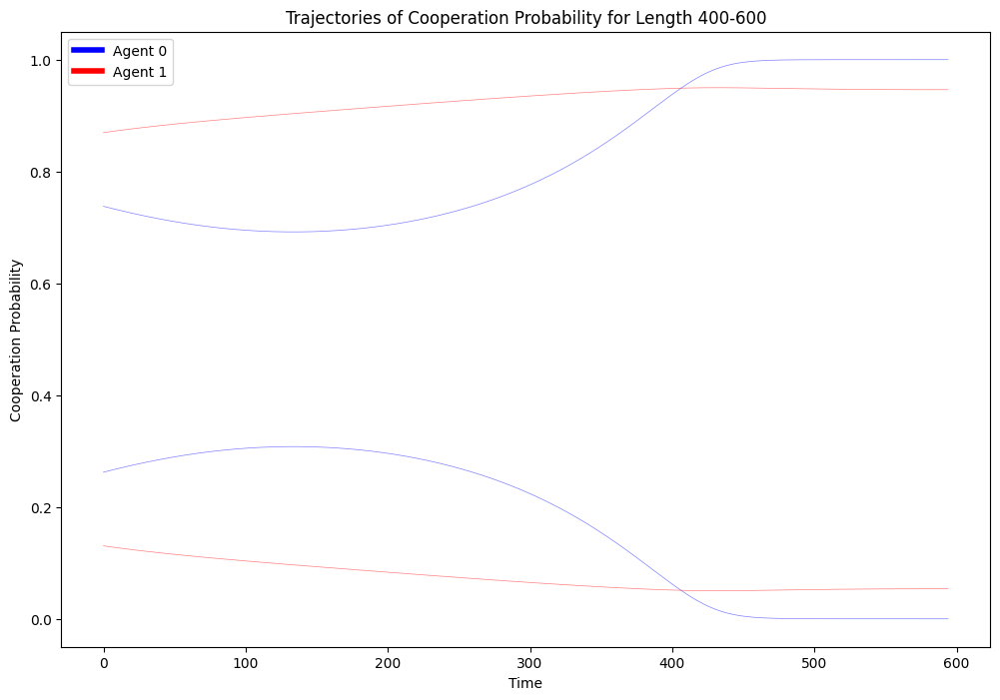

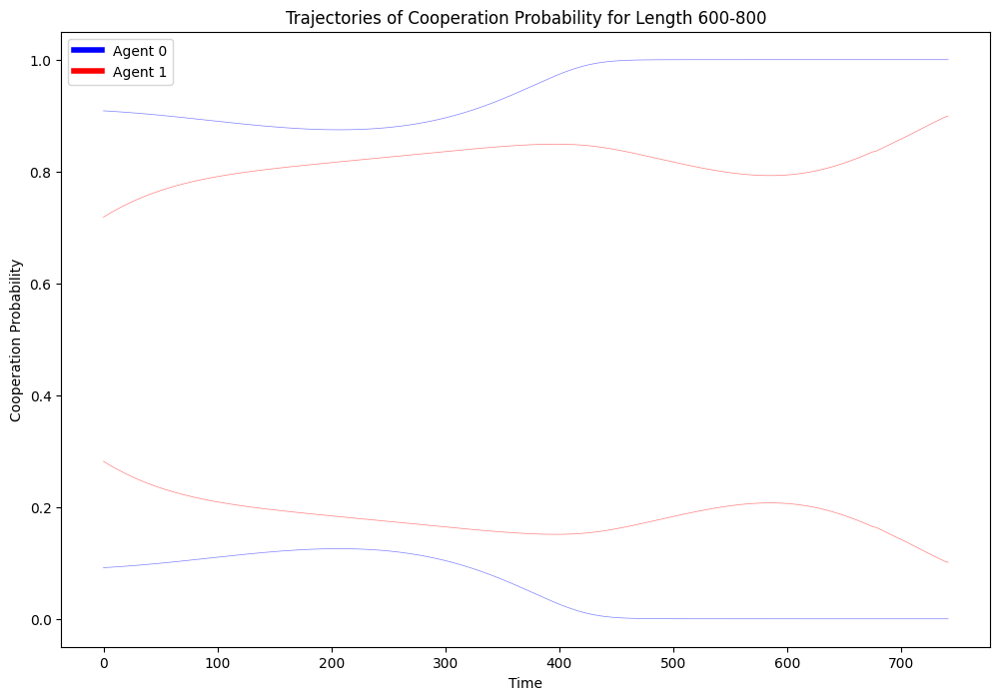

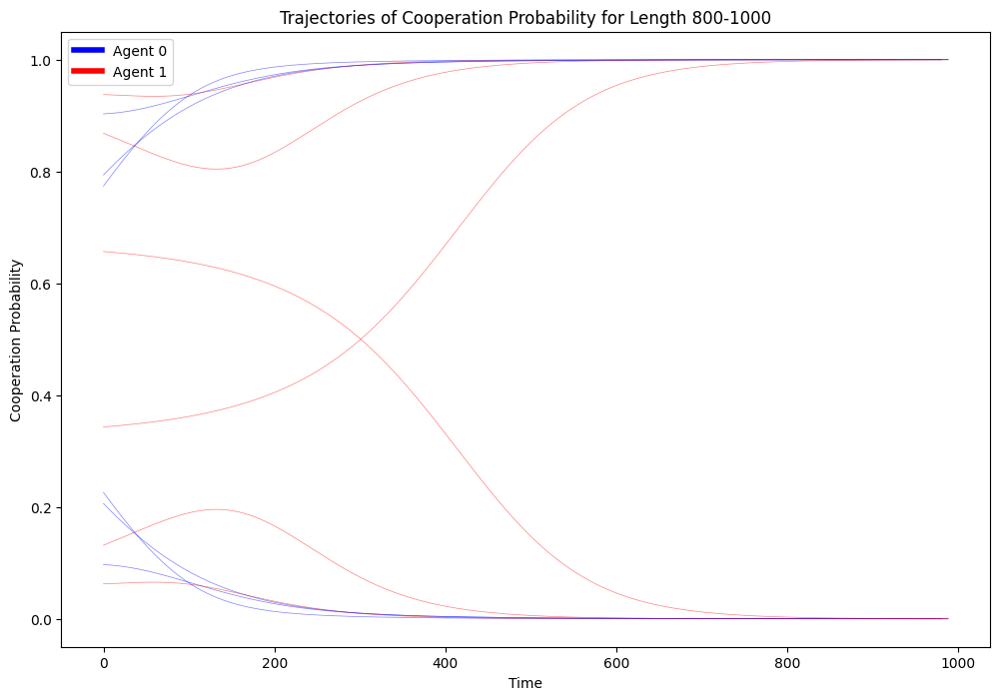

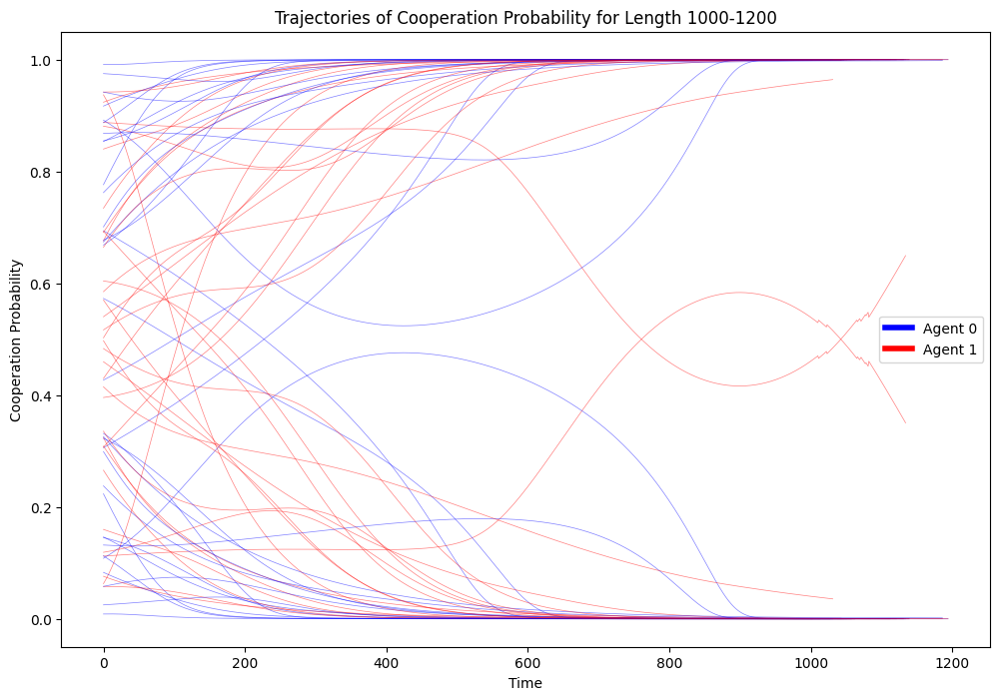

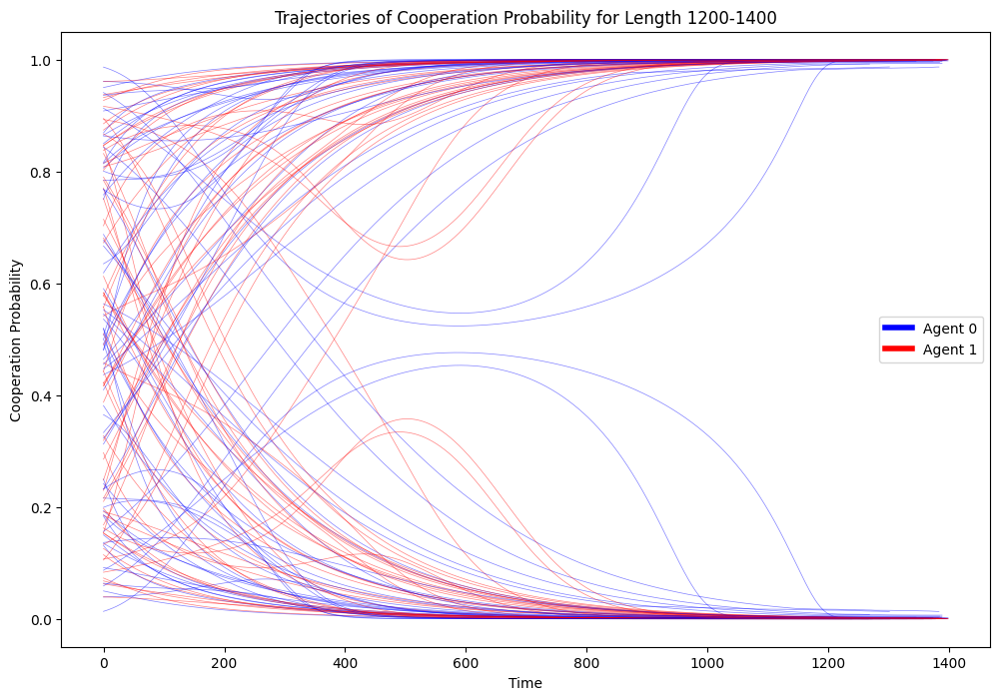

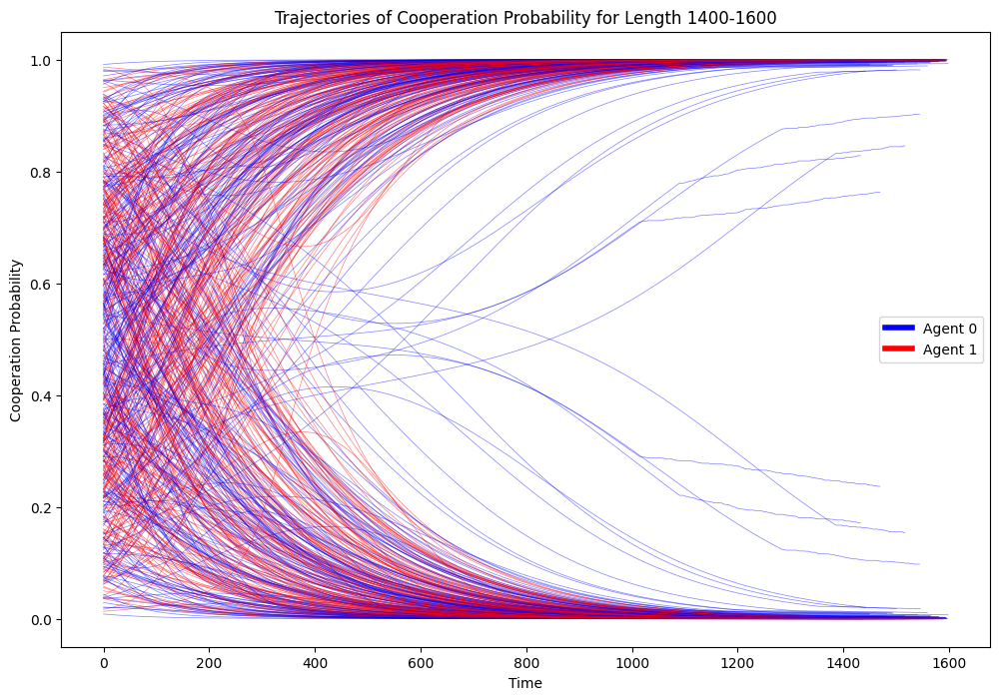

In [313]:
bins = [200, 400, 600, 800, 1000, 1200, 1400, 1600]
bin_labels = ['200-400', '400-600', '600-800', '800-1000', '1000-1200', '1200-1400', '1400-1600']

# Initialize a dictionary to hold categorized trajectories
categorized_trajectories = {label: [] for label in bin_labels}

# Categorize each trajectory based on its length
for series in strategy_time_series:
    length = len(series)
    for i, bin_edge in enumerate(bins):
        if length < bin_edge:
            category_label = bin_labels[i-1 if i != 0 else 0]
            categorized_trajectories[category_label].append(series)
            break

# Now, we have the trajectories categorized by length intervals
# Let's plot the trajectories for each interval
for category, trajectories in categorized_trajectories.items():
    if trajectories:  # Check if there are trajectories in this category
        plt.figure(figsize=(12, 8))
        plt.title(f'Trajectories of Cooperation Probability for Length {category}')
        plt.xlabel('Time')
        plt.ylabel('Cooperation Probability')
        
        for series in trajectories:
            plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)  # for Agent 0
            plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)  # for Agent 1
        
        plt.legend(custom_lines, ['Agent 0', 'Agent 1'])
        plt.show()


### Case2: Agents only remember what the other did

In [842]:
# Define a history object
memo_ipd_2 = HistoryEmbedded(env, h=(2,2,2))

In [843]:
memo_ipd_2.Oset[0] =    ['.,c,.|.,c,.|',
                         '.,c,.|.,d,.|',
                         '.,c,.|.,c,.|',
                         '.,c,.|.,d,.|',
                         '.,d,.|.,c,.|',
                         '.,d,.|.,d,.|',
                         '.,d,.|.,c,.|',
                         '.,d,.|.,d,.|',
                         '.,c,.|.,c,.|',
                         '.,c,.|.,d,.|',
                         '.,c,.|.,c,.|',
                         '.,c,.|.,d,.|',
                         '.,d,.|.,c,.|',
                         '.,d,.|.,d,.|',
                         '.,d,.|.,c,.|',
                         '.,d,.|.,d,.|']


In [844]:
memo_ipd_2.Oset[1] =    ['c,.,.|c,.,.|',
                         'c,.,.|c,.,.|',
                         'c,.,.|d,.,.|',
                         'c,.,.|d,.,.|',
                         'c,.,.|c,.,.|',
                         'c,.,.|c,.,.|',
                         'c,.,.|d,.,.|',
                         'c,.,.|d,.,.|',
                         'd,.,.|c,.,.|',
                         'd,.,.|c,.,.|',
                         'd,.,.|d,.,.|',
                         'd,.,.|d,.,.|',
                         'd,.,.|c,.,.|',
                         'd,.,.|c,.,.|',
                         'd,.,.|d,.,.|',
                         'd,.,.|d,.,.|']

In [845]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_2.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_2.Oset[0])
memo_ipd_2.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_2.Oset[1])

In [846]:
# Checking the observation set
memo_ipd_2.O

array([[[0.25, 0.  , 0.25, 0.  , 0.  , 0.  , 0.  , 0.  , 0.25, 0.  ,
         0.25, 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.25, 0.  , 0.25, 0.  , 0.  , 0.  , 0.  , 0.  , 0.25,
         0.  , 0.25, 0.  , 0.  , 0.  , 0.  ],
        [0.25, 0.  , 0.25, 0.  , 0.  , 0.  , 0.  , 0.  , 0.25, 0.  ,
         0.25, 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.25, 0.  , 0.25, 0.  , 0.  , 0.  , 0.  , 0.  , 0.25,
         0.  , 0.25, 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.  , 0.  , 0.25, 0.  , 0.25, 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.25, 0.  , 0.25, 0.  ],
        [0.  , 0.  , 0.  , 0.  , 0.  , 0.25, 0.  , 0.25, 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.25, 0.  , 0.25],
        [0.  , 0.  , 0.  , 0.  , 0.25, 0.  , 0.25, 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.25, 0.  , 0.25, 0.  ],
        [0.  , 0.  , 0.  , 0.  , 0.  , 0.25, 0.  , 0.25, 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.25, 0.  , 0.25],
        [0.25, 0.  , 0.25, 0.  , 0.  , 0.  , 0.  , 0.  , 0.25, 0.  ,
         0.

In [847]:
# Modify state set, so it represents the current game
state_set_2 = []
for i in range(len(memo_ipd_2.Oset[0])):
    sub_set_2 = f"a0 = {memo_ipd_2.Oset[0][i]} a1 = {memo_ipd_2.Oset[1][i]}"
    state_set_2.append(sub_set_2)
state_set_2

['a0 = .,c,.|.,c,.| a1 = c,.,.|c,.,.|',
 'a0 = .,c,.|.,d,.| a1 = c,.,.|c,.,.|',
 'a0 = .,c,.|.,c,.| a1 = c,.,.|d,.,.|',
 'a0 = .,c,.|.,d,.| a1 = c,.,.|d,.,.|',
 'a0 = .,d,.|.,c,.| a1 = c,.,.|c,.,.|',
 'a0 = .,d,.|.,d,.| a1 = c,.,.|c,.,.|',
 'a0 = .,d,.|.,c,.| a1 = c,.,.|d,.,.|',
 'a0 = .,d,.|.,d,.| a1 = c,.,.|d,.,.|',
 'a0 = .,c,.|.,c,.| a1 = d,.,.|c,.,.|',
 'a0 = .,c,.|.,d,.| a1 = d,.,.|c,.,.|',
 'a0 = .,c,.|.,c,.| a1 = d,.,.|d,.,.|',
 'a0 = .,c,.|.,d,.| a1 = d,.,.|d,.,.|',
 'a0 = .,d,.|.,c,.| a1 = d,.,.|c,.,.|',
 'a0 = .,d,.|.,d,.| a1 = d,.,.|c,.,.|',
 'a0 = .,d,.|.,c,.| a1 = d,.,.|d,.,.|',
 'a0 = .,d,.|.,d,.| a1 = d,.,.|d,.,.|']

In [848]:
# Generate agents
mae_2 = POstratAC(env=memo_ipd_2, learning_rates=0.1, discount_factors=0.9)

In [849]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_2.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_2.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case2.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case2.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [850]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [851]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 1000


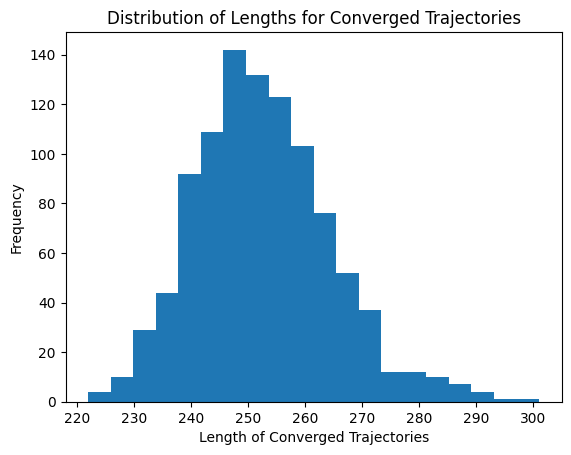

In [852]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Analyze the distribution of final strategies' lengths if necessary
plt.hist(length_n, bins=20)
plt.title('Distribution of Lengths for Converged Trajectories')
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.show()

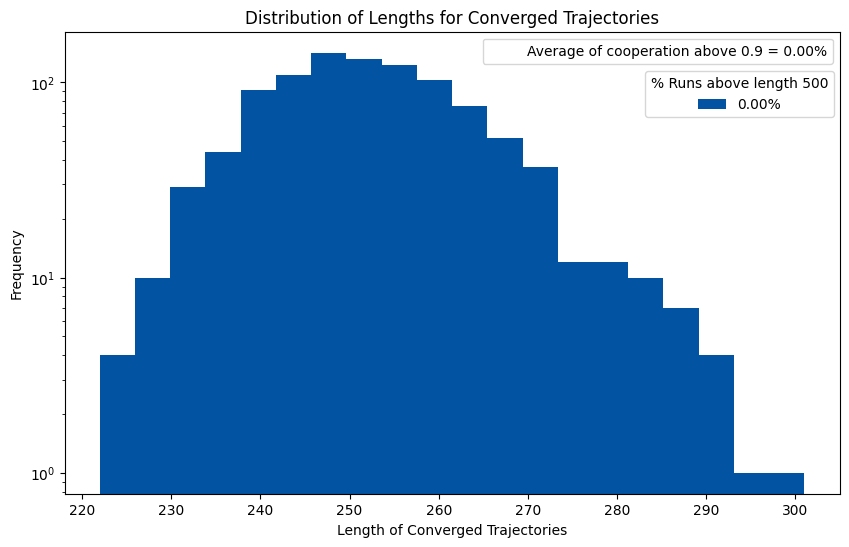

In [864]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Plotting
plt.figure(figsize=(10, 6))
plt.hist(length_n, bins=20, log=True, color='#0254a3', label='0.00%')
plt.title('Distribution of Lengths for Converged Trajectories')
info_patch1 = plt.Line2D([0], [0], color='none', label='Average of cooperation above 0.9 = 0.00%')
first_legend = plt.legend(handles=[info_patch1], loc='upper right')
plt.gca().add_artist(first_legend)
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.legend(loc='upper left', bbox_to_anchor=(.74, .93), title="% Runs above length 500")
plt.savefig('distribution_full_obs.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI ensuring legend is included
plt.show()

In [863]:
# Count the number of trajectories below length 520
below_520 = sum(1 for length in length_n if length < 500)

# Count the number of trajectories of length 520 or more
at_or_above_520 = len(length_n) - below_520

# Calculate percentage of each category
percentage_below_520 = (below_520 / len(length_n)) * 100
percentage_at_or_above_520 = (at_or_above_520 / len(length_n)) * 100

below_520, at_or_above_520, percentage_below_520, percentage_at_or_above_520


(1000, 0, 100.0, 0.0)

In [854]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([], dtype=int64)

In [855]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [856]:
mae_2.obsdist(x)

Array([[0.05049684, 0.06177562, 0.05049682, 0.06177562, 0.06177559,
        0.07595198, 0.06177559, 0.07595198, 0.05049679, 0.06177562,
        0.05049679, 0.06177562, 0.06177559, 0.07595198, 0.06177559,
        0.07595198],
       [0.10455979, 0.10455974, 0.05715781, 0.05715781, 0.10455978,
        0.10455978, 0.05715781, 0.05715781, 0.05715783, 0.05715783,
        0.0311246 , 0.0311246 , 0.05715783, 0.05715783, 0.0311246 ,
        0.0311246 ]], dtype=float32)

Text(0, 0.5, 'average reward')

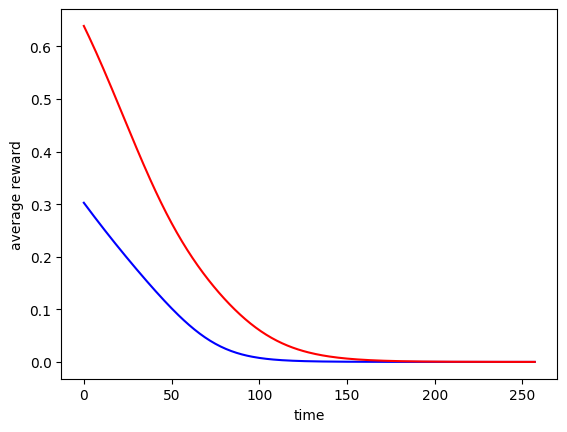

In [857]:
Rti = np.array([mae_2.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

In [858]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(1000, 2, 16, 2)

In [859]:
finalRni = np.array([mae_2.Ri(Xisa) for Xisa in finalXnisa])

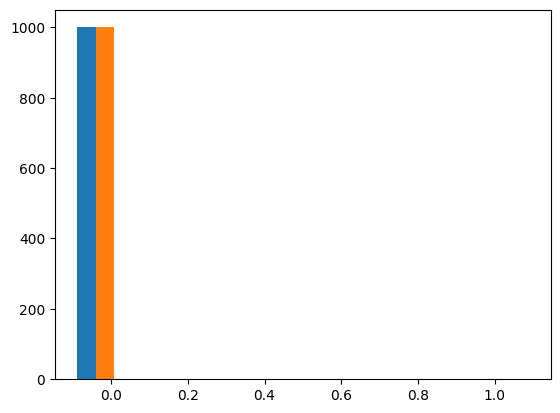

In [860]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [861]:
np.mean(finalRni[:,0] > 0.9) * 100

0.0

In [862]:
np.mean(finalRni[:,1] > 0.9) * 100

0.0

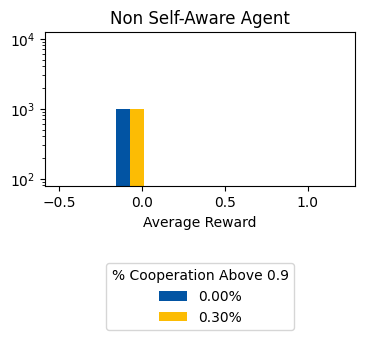

In [575]:
plt.figure(figsize=(4, 2)) 
plt.hist([(finalRni[:,0]), (finalRni[:,1])], color=['#0254a3', '#fcbc04'], label=['0.00%','0.30%'], range=(-.5, 1.2), rwidth=35, log=True)
plt.title('Non Self-Aware Agent')
plt.legend(loc='center', bbox_to_anchor=(.5, -0.72), title="% Cooperation Above 0.9")
plt.xlabel('Average Reward');

In [289]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000_het_case2.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

Shape of the data for Agent 0: (296, 2, 16, 2)
Shape of the data for Agent 1: (249, 2, 16, 2)


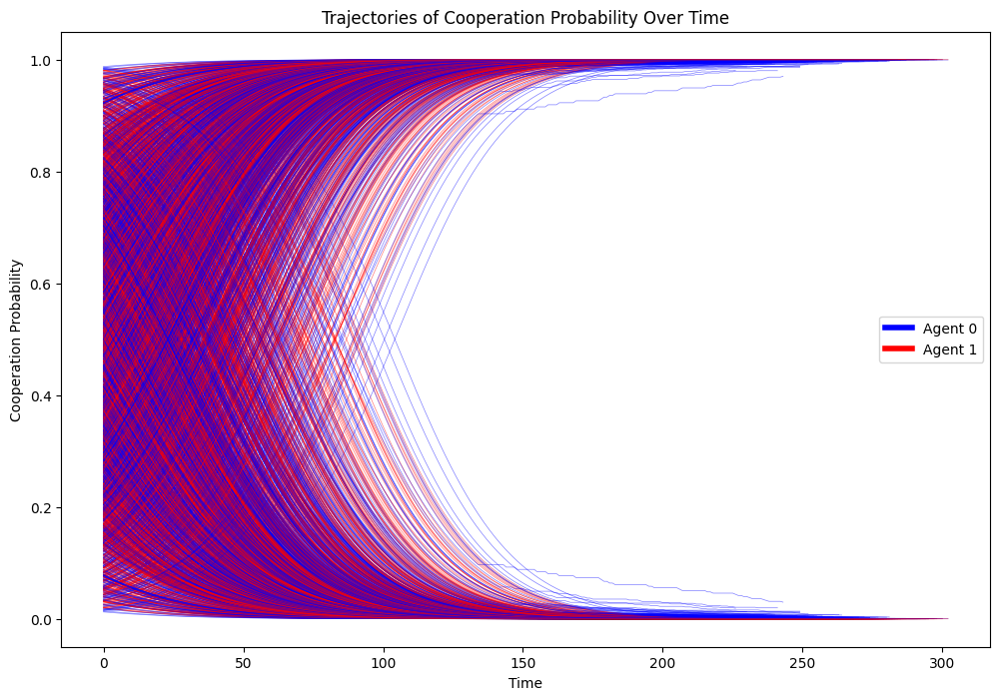

In [290]:
# Setup the plot
plt.figure(figsize=(12, 8))

# Define colors for clarity and reusability
colors = {'Agent 0': 'blue', 'Agent 1': 'red'}

# Check the shape of the data and print it
print("Shape of the data for Agent 0:", strategy_time_series[0].shape)
print("Shape of the data for Agent 1:", strategy_time_series[1].shape)

# Assume the data shape is (number of steps, number of variables, number of agents)
# We need to select which variable to plot, e.g., the first variable
variable_index = 0

# Loop through each simulation
for series in strategy_time_series:
    # Plot each trajectory for agent 0
    plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)
    # Plot each trajectory for agent 1
    plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)

# Adding plot labels and title
plt.xlabel('Time')
plt.ylabel('Cooperation Probability')
plt.title('Trajectories of Cooperation Probability Over Time')

# Create custom handles for the legend
custom_lines = [Line2D([0], [0], color=colors['Agent 0'], lw=4),
                Line2D([0], [0], color=colors['Agent 1'], lw=4)]

# Set the legend with custom handles
plt.legend(custom_lines, ['Agent 0', 'Agent 1'])

# Show the plot
plt.show()


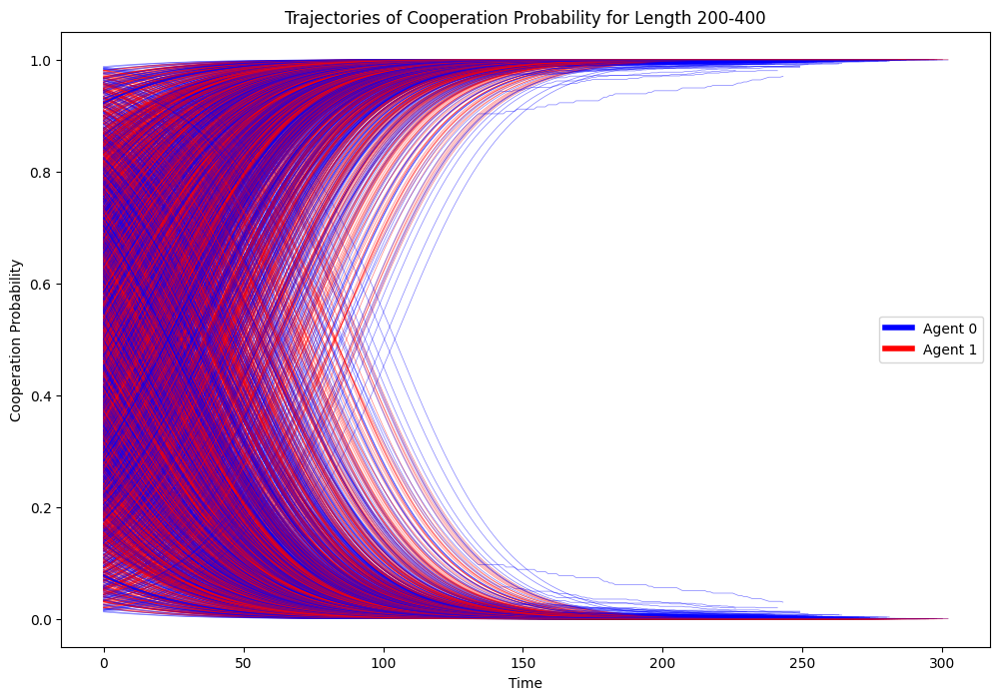

In [291]:
bins = [200, 400, 600, 800, 1000, 1200, 1400, 1600]
bin_labels = ['200-400', '400-600', '600-800', '800-1000', '1000-1200', '1200-1400', '1400-1600']

# Initialize a dictionary to hold categorized trajectories
categorized_trajectories = {label: [] for label in bin_labels}

# Categorize each trajectory based on its length
for series in strategy_time_series:
    length = len(series)
    for i, bin_edge in enumerate(bins):
        if length < bin_edge:
            category_label = bin_labels[i-1 if i != 0 else 0]
            categorized_trajectories[category_label].append(series)
            break

# Now, we have the trajectories categorized by length intervals
# Let's plot the trajectories for each interval
for category, trajectories in categorized_trajectories.items():
    if trajectories:  # Check if there are trajectories in this category
        plt.figure(figsize=(12, 8))
        plt.title(f'Trajectories of Cooperation Probability for Length {category}')
        plt.xlabel('Time')
        plt.ylabel('Cooperation Probability')
        
        for series in trajectories:
            plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)  # for Agent 0
            plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)  # for Agent 1
        
        plt.legend(custom_lines, ['Agent 0', 'Agent 1'])
        plt.show()


### Case3: Agent0 is fully observable and agent1 fully blind

In [1787]:
memo_ipd_3 = HistoryEmbedded(env, h=(2,2,2))

In [1788]:
memo_ipd_3.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [1789]:
memo_ipd_3.Oset[1] =    ['.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|',
                         '.,.,.|.,.,.|']

In [1790]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_3.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_3.Oset[0])
memo_ipd_3.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_3.Oset[1])

In [1791]:
# Checking the observation set
memo_ipd_3.O

array([[[1.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    ,
         0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    ],
        [0.    , 1.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    ,
         0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    ],
        [0.    , 0.    , 1.    , 0.    , 0.    , 0.    , 0.    , 0.    ,
         0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    ],
        [0.    , 0.    , 0.    , 1.    , 0.    , 0.    , 0.    , 0.    ,
         0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    ],
        [0.    , 0.    , 0.    , 0.    , 1.    , 0.    , 0.    , 0.    ,
         0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    ],
        [0.    , 0.    , 0.    , 0.    , 0.    , 1.    , 0.    , 0.    ,
         0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    ],
        [0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 1.    , 0.    ,
         0.    , 0.    , 0.    , 0.    , 0.  

In [1792]:
# Modify state set, so it represents the current game
state_set_3 = []
for i in range(len(memo_ipd_3.Oset[0])):
    sub_set_3 = f"a0 = {memo_ipd_3.Oset[0][i]} a1 = {memo_ipd_3.Oset[1][i]}"
    state_set_3.append(sub_set_3)
state_set_3

['a0 = c,c,.|c,c,.| a1 = .,.,.|.,.,.|',
 'a0 = c,c,.|c,d,.| a1 = .,.,.|.,.,.|',
 'a0 = c,c,.|d,c,.| a1 = .,.,.|.,.,.|',
 'a0 = c,c,.|d,d,.| a1 = .,.,.|.,.,.|',
 'a0 = c,d,.|c,c,.| a1 = .,.,.|.,.,.|',
 'a0 = c,d,.|c,d,.| a1 = .,.,.|.,.,.|',
 'a0 = c,d,.|d,c,.| a1 = .,.,.|.,.,.|',
 'a0 = c,d,.|d,d,.| a1 = .,.,.|.,.,.|',
 'a0 = d,c,.|c,c,.| a1 = .,.,.|.,.,.|',
 'a0 = d,c,.|c,d,.| a1 = .,.,.|.,.,.|',
 'a0 = d,c,.|d,c,.| a1 = .,.,.|.,.,.|',
 'a0 = d,c,.|d,d,.| a1 = .,.,.|.,.,.|',
 'a0 = d,d,.|c,c,.| a1 = .,.,.|.,.,.|',
 'a0 = d,d,.|c,d,.| a1 = .,.,.|.,.,.|',
 'a0 = d,d,.|d,c,.| a1 = .,.,.|.,.,.|',
 'a0 = d,d,.|d,d,.| a1 = .,.,.|.,.,.|']

In [1793]:
# Generate agents
mae_3 = POstratAC(env=memo_ipd_3, learning_rates=0.1, discount_factors=0.9)

In [1794]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_3.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_3.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case3.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case3.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [1795]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [1796]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 1000


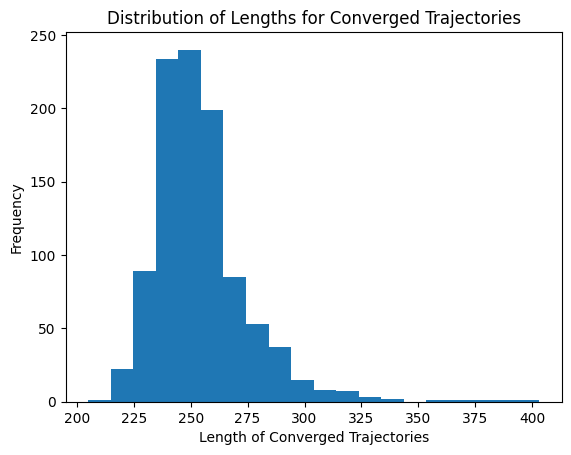

In [1797]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Analyze the distribution of final strategies' lengths if necessary
plt.hist(length_n, bins=20)
plt.title('Distribution of Lengths for Converged Trajectories')
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.show()

In [1798]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([], dtype=int64)

In [1799]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [265]:
mae_3.obsdist(x)

Array([[0.0561229 , 0.06972231, 0.06598035, 0.08196829, 0.1291332 ,
        0.16042402, 0.02255736, 0.02802335, 0.03326704, 0.04132812,
        0.04351702, 0.05406178, 0.05527063, 0.06866352, 0.04011929,
        0.04984076],
       [0.0625    , 0.06250001, 0.0625    , 0.0625    , 0.0625    ,
        0.0625    , 0.0625    , 0.0625    , 0.0625    , 0.0625    ,
        0.0625    , 0.0625    , 0.0625    , 0.0625    , 0.0625    ,
        0.0625    ]], dtype=float32)

In [1800]:
Rti = np.array([mae_3.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

TracerArrayConversionError: The numpy.ndarray conversion method __array__() was called on traced array with shape float32[16,16].
The error occurred while tracing the function Ri at /Users/mariana/dev/pyCRLD/pyCRLD/Agents/POBase.py:288 for jit. This value became a tracer due to JAX operations on these lines:

  operation a[35m:i32[][39m = convert_element_type[new_dtype=int32 weak_type=True] b
    from line /Users/mariana/dev/pyCRLD/pyCRLD/Agents/POBase.py:336 (_obsdist)

  operation a[35m:i32[][39m = convert_element_type[new_dtype=int32 weak_type=True] b
    from line /Users/mariana/dev/pyCRLD/pyCRLD/Agents/POBase.py:336 (_obsdist)

  operation a[35m:i32[][39m = convert_element_type[new_dtype=int32 weak_type=True] b
    from line /Users/mariana/dev/pyCRLD/pyCRLD/Agents/POBase.py:336 (_obsdist)

  operation a[35m:i32[][39m = convert_element_type[new_dtype=int32 weak_type=False] b
    from line /Users/mariana/dev/pyCRLD/pyCRLD/Agents/POBase.py:336 (_obsdist)

  operation a[35m:bool[][39m = lt b c
    from line /Users/mariana/dev/pyCRLD/pyCRLD/Agents/POBase.py:336 (_obsdist)

(Additional originating lines are not shown.)
See https://jax.readthedocs.io/en/latest/errors.html#jax.errors.TracerArrayConversionError

In [ ]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

In [ ]:
finalRni = np.array([mae_3.Ri(Xisa) for Xisa in finalXnisa])

In [ ]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [ ]:
np.mean(finalRni[:,0] > 0.9) * 100

In [ ]:
# mae_3.obsdist(x)

In [ ]:
Rti_3 = np.array([mae_3.Ri(x) for x in Xtisa])

Text(0, 0.5, 'Average reward')

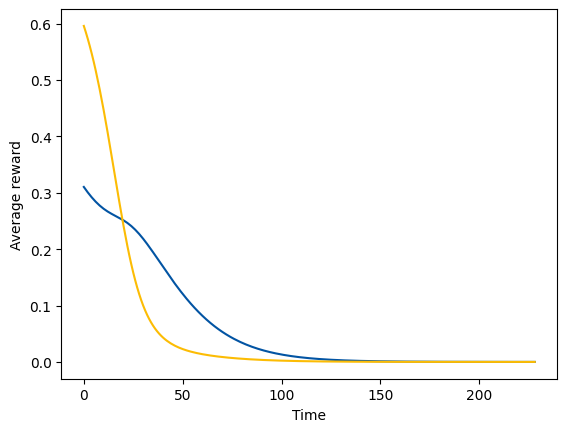

In [274]:
Rti_3 = np.array([mae_3.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='#0254a3', label='agent0')
plt.plot(Rti[:, 1], color='#fcbc04', label='agent1')
plt.xlabel('Time'); plt.ylabel('Average reward')

In [268]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000_het_case3.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

Shape of the data for Agent 0: (235, 2, 16, 2)
Shape of the data for Agent 1: (230, 2, 16, 2)


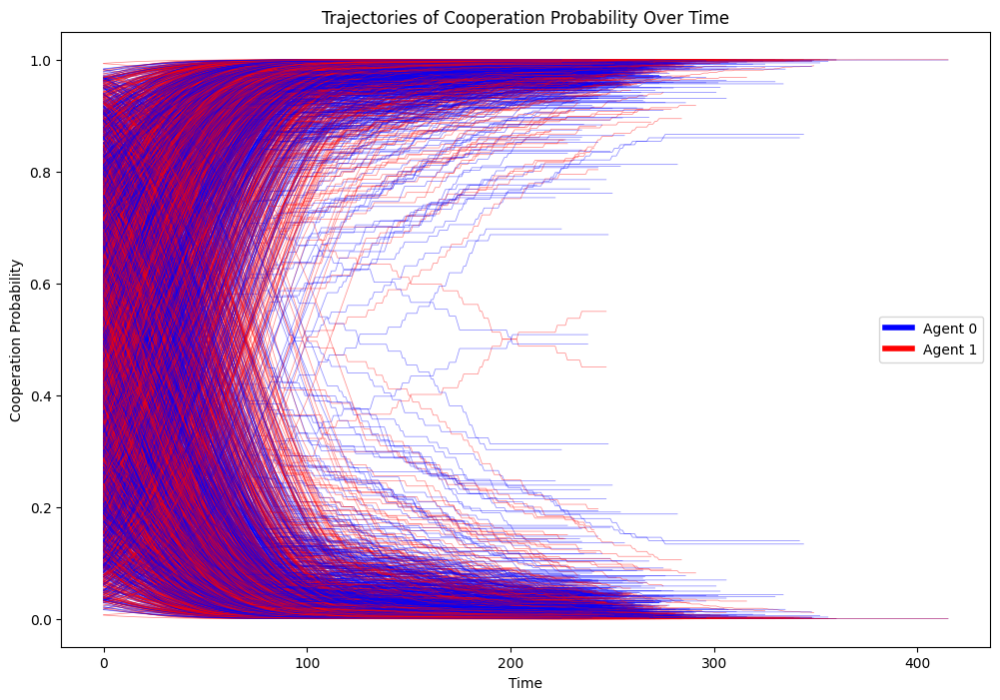

In [269]:
# Setup the plot
plt.figure(figsize=(12, 8))

# Define colors for clarity and reusability
colors = {'Agent 0': 'blue', 'Agent 1': 'red'}

# Check the shape of the data and print it
print("Shape of the data for Agent 0:", strategy_time_series[0].shape)
print("Shape of the data for Agent 1:", strategy_time_series[1].shape)

# Assume the data shape is (number of steps, number of variables, number of agents)
# We need to select which variable to plot, e.g., the first variable
variable_index = 0

# Loop through each simulation
for series in strategy_time_series:
    # Plot each trajectory for agent 0
    plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)
    # Plot each trajectory for agent 1
    plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)

# Adding plot labels and title
plt.xlabel('Time')
plt.ylabel('Cooperation Probability')
plt.title('Trajectories of Cooperation Probability Over Time')

# Create custom handles for the legend
custom_lines = [Line2D([0], [0], color=colors['Agent 0'], lw=4),
                Line2D([0], [0], color=colors['Agent 1'], lw=4)]

# Set the legend with custom handles
plt.legend(custom_lines, ['Agent 0', 'Agent 1'])

# Show the plot
plt.show()


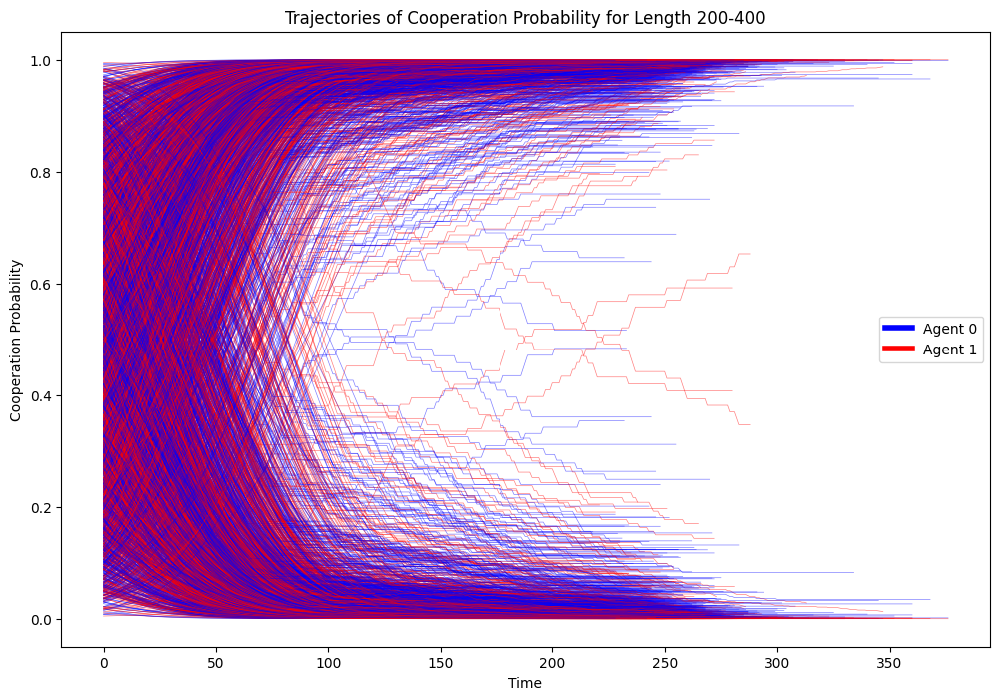

In [52]:
bins = [200, 400, 600, 800, 1000, 1200, 1400, 1600]
bin_labels = ['200-400', '400-600', '600-800', '800-1000', '1000-1200', '1200-1400', '1400-1600']

# Initialize a dictionary to hold categorized trajectories
categorized_trajectories = {label: [] for label in bin_labels}

# Categorize each trajectory based on its length
for series in strategy_time_series:
    length = len(series)
    for i, bin_edge in enumerate(bins):
        if length < bin_edge:
            category_label = bin_labels[i-1 if i != 0 else 0]
            categorized_trajectories[category_label].append(series)
            break

# Now, we have the trajectories categorized by length intervals
# Let's plot the trajectories for each interval
for category, trajectories in categorized_trajectories.items():
    if trajectories:  # Check if there are trajectories in this category
        plt.figure(figsize=(12, 8))
        plt.title(f'Trajectories of Cooperation Probability for Length {category}')
        plt.xlabel('Time')
        plt.ylabel('Cooperation Probability')
        
        for series in trajectories:
            plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)  # for Agent 0
            plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)  # for Agent 1
        
        plt.legend(custom_lines, ['Agent 0', 'Agent 1'])
        plt.show()


### Case4: Agent0 is fully observable and agent1 partially blind about agent0 (in second iteration)

In [2039]:
memo_ipd_4 = HistoryEmbedded(env, h=(2,2,2))

In [2040]:
memo_ipd_4.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [2041]:
memo_ipd_4.Oset[1] =    ['c,c,.|.,c,.|',
                         'c,c,.|.,d,.|',
                         'c,c,.|.,c,.|',
                         'c,c,.|.,d,.|',
                         'c,d,.|.,c,.|',
                         'c,d,.|.,d,.|',
                         'c,d,.|.,c,.|',
                         'c,d,.|.,d,.|',
                         'd,c,.|.,c,.|',
                         'd,c,.|.,d,.|',
                         'd,c,.|.,c,.|',
                         'd,c,.|.,d,.|',
                         'd,d,.|.,c,.|',
                         'd,d,.|.,d,.|',
                         'd,d,.|.,c,.|',
                         'd,d,.|.,d,.|']

In [2042]:
memo_ipd_4.Oset

[['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|'],
 ['c,c,.|.,c,.|',
  'c,c,.|.,d,.|',
  'c,c,.|.,c,.|',
  'c,c,.|.,d,.|',
  'c,d,.|.,c,.|',
  'c,d,.|.,d,.|',
  'c,d,.|.,c,.|',
  'c,d,.|.,d,.|',
  'd,c,.|.,c,.|',
  'd,c,.|.,d,.|',
  'd,c,.|.,c,.|',
  'd,c,.|.,d,.|',
  'd,d,.|.,c,.|',
  'd,d,.|.,d,.|',
  'd,d,.|.,c,.|',
  'd,d,.|.,d,.|']]

In [2043]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_4.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_4.Oset[0])
memo_ipd_4.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_4.Oset[1])

In [2044]:
# Checking the observation set
memo_ipd_4.O

array([[[1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0

In [2045]:
# Modify state set, so it represents the current game
state_set_4 = []
for i in range(len(memo_ipd_4.Oset[0])):
    sub_set_4 = f"a0 = {memo_ipd_4.Oset[0][i]} a1 = {memo_ipd_4.Oset[1][i]}"
    state_set_4.append(sub_set_4)
state_set_4

['a0 = c,c,.|c,c,.| a1 = c,c,.|.,c,.|',
 'a0 = c,c,.|c,d,.| a1 = c,c,.|.,d,.|',
 'a0 = c,c,.|d,c,.| a1 = c,c,.|.,c,.|',
 'a0 = c,c,.|d,d,.| a1 = c,c,.|.,d,.|',
 'a0 = c,d,.|c,c,.| a1 = c,d,.|.,c,.|',
 'a0 = c,d,.|c,d,.| a1 = c,d,.|.,d,.|',
 'a0 = c,d,.|d,c,.| a1 = c,d,.|.,c,.|',
 'a0 = c,d,.|d,d,.| a1 = c,d,.|.,d,.|',
 'a0 = d,c,.|c,c,.| a1 = d,c,.|.,c,.|',
 'a0 = d,c,.|c,d,.| a1 = d,c,.|.,d,.|',
 'a0 = d,c,.|d,c,.| a1 = d,c,.|.,c,.|',
 'a0 = d,c,.|d,d,.| a1 = d,c,.|.,d,.|',
 'a0 = d,d,.|c,c,.| a1 = d,d,.|.,c,.|',
 'a0 = d,d,.|c,d,.| a1 = d,d,.|.,d,.|',
 'a0 = d,d,.|d,c,.| a1 = d,d,.|.,c,.|',
 'a0 = d,d,.|d,d,.| a1 = d,d,.|.,d,.|']

In [2046]:
# Generate agents
mae_4 = POstratAC(env=memo_ipd_4, learning_rates=0.1, discount_factors=0.9)

In [2047]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_4.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_4.trajectory(x, Tmax=10000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case4.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case4.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


In [2048]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000_het_case4.npy', allow_pickle=True)
    cn = np.load('wolf_convergence_status_1000_het_case4.npy', allow_pickle=True)
    return strategy_time_series, cn

# Load the data
strategy_time_series_4, cn_array_4 = load_simulation_data()

#### Experiments

In [2049]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(cn_array_4)
num_simulations

1000

In [2050]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.count_nonzero(cn_array_4 == False))

Number of converged simulations: 0


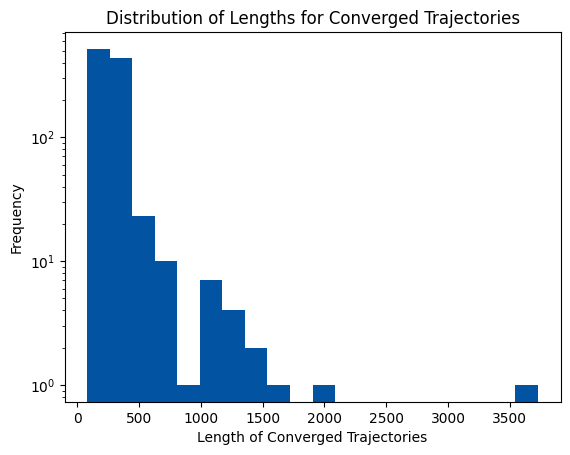

In [2066]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [strategy_time_series_4[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(strategy_time_series_4[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Analyze the distribution of final strategies' lengths if necessary
plt.hist(length_n, bins=20, color='#0254a3', log=True)
plt.title('Distribution of Lengths for Converged Trajectories')
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.savefig('distribution4.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI ensuring legend is included
plt.show()

In [2053]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([], dtype=int64)

In [2054]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='#fcbc04', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='#0254a3', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [2055]:
mae_4.obsdist(x)

Array([[0.06529041, 0.05973475, 0.05136066, 0.04517457, 0.02408666,
        0.04505061, 0.08701468, 0.07542255, 0.08807845, 0.07728586,
        0.05581819, 0.04812148, 0.04410486, 0.0495032 , 0.07511061,
        0.10884237],
       [0.0583255 , 0.05245466, 0.05832551, 0.05245467, 0.05555065,
        0.06023661, 0.05555065, 0.06023661, 0.07194829, 0.06270371,
        0.07194829, 0.06270371, 0.05960772, 0.07917281, 0.05960772,
        0.07917281]], dtype=float32)

In [2056]:
Rti_4 = np.array([mae_4.Ri(x) for x in Xtisa])

In [2057]:
Rti_4.shape

(282, 2)

Text(0, 0.5, 'Average reward')

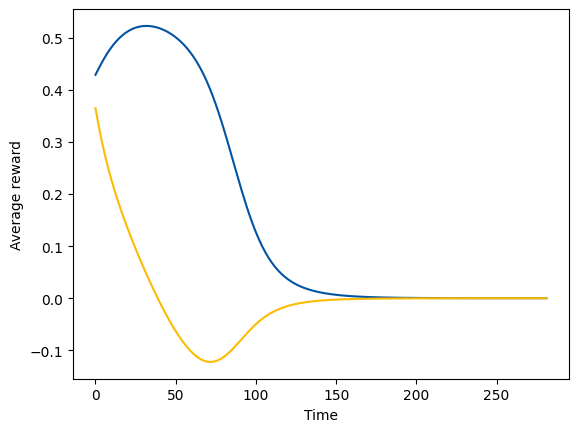

In [2058]:
Rti = np.array([mae_4.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='#0254a3', label='agent0')
plt.plot(Rti[:, 1], color='#fcbc04', label='agent1')
plt.xlabel('Time'); plt.ylabel('Average reward')

In [2059]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(1000, 2, 16, 2)

In [2060]:
finalRni = np.array([mae_4.Ri(Xisa) for Xisa in finalXnisa])

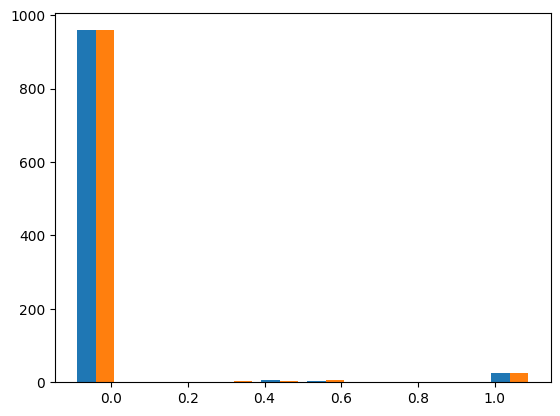

In [2061]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [2062]:
np.mean(finalRni[:,0] > 0.9) * 100 #mean_smart

2.6

In [2063]:
np.mean(finalRni[:,1] > 0.9) * 100 #mean_dumb

2.6

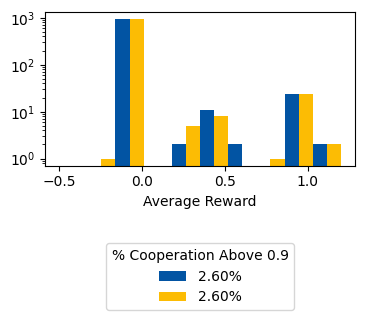

In [2068]:
plt.figure(figsize=(4, 2)) 
plt.hist([(finalRni[:,0]), (finalRni[:,1])], color=['#0254a3', '#fcbc04'], label=['2.60%','2.60%'], range=(-.5, 1.2), rwidth=35, log=True)
# plt.plot(Rti[:, 0], color='#0254a3', label='agent0')
# plt.plot(Rti[:, 1], color='#fcbc04', label='agent1')
plt.legend(loc='center', bbox_to_anchor=(.5, -0.72), title="% Cooperation Above 0.9")
plt.savefig('re4.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI ensuring legend is included
plt.xlabel('Average Reward');

In [2067]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000_het_case4.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

In [1814]:
# bins = [200, 400, 600, 800, 1000, 1200, 1400, 1600]
# bin_labels = ['200-400', '400-600', '600-800', '800-1000', '1000-1200', '1200-1400', '1400-1600']

# # Initialize a dictionary to hold categorized trajectories
# categorized_trajectories = {label: [] for label in bin_labels}

# # Categorize each trajectory based on its length
# for series in strategy_time_series:
#     length = len(series)
#     for i, bin_edge in enumerate(bins):
#         if length < bin_edge:
#             category_label = bin_labels[i-1 if i != 0 else 0]
#             categorized_trajectories[category_label].append(series)
#             break

# # Now, we have the trajectories categorized by length intervals
# # Let's plot the trajectories for each interval
# for category, trajectories in categorized_trajectories.items():
#     if trajectories:  # Check if there are trajectories in this category
#         plt.figure(figsize=(12, 8))
#         plt.title(f'Trajectories of Cooperation Probability for Length {category}')
#         plt.xlabel('Time')
#         plt.ylabel('Cooperation Probability')
        
#         for series in trajectories:
#             plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)  # for Agent 0
#             plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)  # for Agent 1
        
#         plt.legend(custom_lines, ['Agent 0', 'Agent 1'])
#         plt.show()


### Case5: Agent0 is fully observable and agent1 partially blind about itself

In [357]:
memo_ipd_5 = HistoryEmbedded(env, h=(2,2,2))

In [358]:
memo_ipd_5.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [359]:
memo_ipd_5.Oset[1] =    ['c,c,.|c,.,.|',
                         'c,c,.|c,.,.|',
                         'c,c,.|d,.,.|',
                         'c,c,.|d,.,.|',
                         'c,d,.|c,.,.|',
                         'c,d,.|c,.,.|',
                         'c,d,.|d,.,.|',
                         'c,d,.|d,.,.|',
                         'd,c,.|c,.,.|',
                         'd,c,.|c,.,.|',
                         'd,c,.|d,.,.|',
                         'd,c,.|d,.,.|',
                         'd,d,.|c,.,.|',
                         'd,d,.|c,.,.|',
                         'd,d,.|d,.,.|',
                         'd,d,.|d,.,.|']

In [481]:
memo_ipd_5.Oset

[['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|'],
 ['c,c,.|c,.,.|',
  'c,c,.|c,.,.|',
  'c,c,.|d,.,.|',
  'c,c,.|d,.,.|',
  'c,d,.|c,.,.|',
  'c,d,.|c,.,.|',
  'c,d,.|d,.,.|',
  'c,d,.|d,.,.|',
  'd,c,.|c,.,.|',
  'd,c,.|c,.,.|',
  'd,c,.|d,.,.|',
  'd,c,.|d,.,.|',
  'd,d,.|c,.,.|',
  'd,d,.|c,.,.|',
  'd,d,.|d,.,.|',
  'd,d,.|d,.,.|']]

In [360]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_5.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_5.Oset[0])
memo_ipd_5.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_5.Oset[1])

[True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True]
[False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False]


In [361]:
# Checking the observation set
memo_ipd_5.O

array([[[1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0

In [362]:
# Modify state set, so it represents the current game
state_set_5 = []
for i in range(len(memo_ipd_5.Oset[0])):
    sub_set_5 = f"a0 = {memo_ipd_5.Oset[0][i]} a1 = {memo_ipd_5.Oset[1][i]}"
    state_set_5.append(sub_set_5)
state_set_5

['a0 = c,c,.|c,c,.| a1 = c,c,.|c,.,.|',
 'a0 = c,c,.|c,d,.| a1 = c,c,.|c,.,.|',
 'a0 = c,c,.|d,c,.| a1 = c,c,.|d,.,.|',
 'a0 = c,c,.|d,d,.| a1 = c,c,.|d,.,.|',
 'a0 = c,d,.|c,c,.| a1 = c,d,.|c,.,.|',
 'a0 = c,d,.|c,d,.| a1 = c,d,.|c,.,.|',
 'a0 = c,d,.|d,c,.| a1 = c,d,.|d,.,.|',
 'a0 = c,d,.|d,d,.| a1 = c,d,.|d,.,.|',
 'a0 = d,c,.|c,c,.| a1 = d,c,.|c,.,.|',
 'a0 = d,c,.|c,d,.| a1 = d,c,.|c,.,.|',
 'a0 = d,c,.|d,c,.| a1 = d,c,.|d,.,.|',
 'a0 = d,c,.|d,d,.| a1 = d,c,.|d,.,.|',
 'a0 = d,d,.|c,c,.| a1 = d,d,.|c,.,.|',
 'a0 = d,d,.|c,d,.| a1 = d,d,.|c,.,.|',
 'a0 = d,d,.|d,c,.| a1 = d,d,.|d,.,.|',
 'a0 = d,d,.|d,d,.| a1 = d,d,.|d,.,.|']

In [363]:
# Generate agents
mae_5 = POstratAC(env=memo_ipd_5, learning_rates=0.1, discount_factors=0.9)

In [364]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_5.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_5.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case5.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case5.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [365]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [366]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 1000


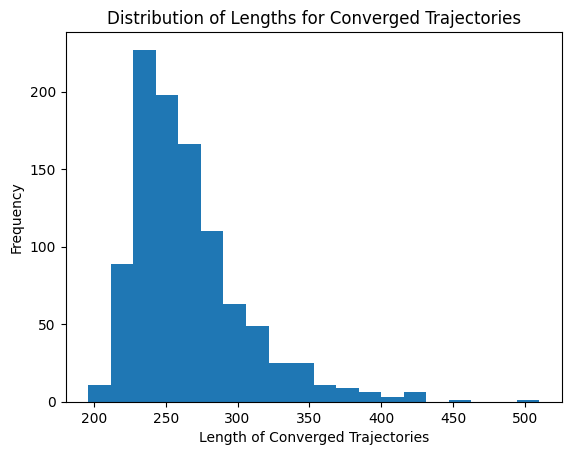

In [367]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Analyze the distribution of final strategies' lengths if necessary
plt.hist(length_n, bins=20)
plt.title('Distribution of Lengths for Converged Trajectories')
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.show()

In [368]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([], dtype=int64)

In [369]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [370]:
mae_5.obsdist(x)

Array([[0.04170597, 0.03463143, 0.04800232, 0.04437175, 0.04704973,
        0.0418603 , 0.05899699, 0.04529873, 0.05019657, 0.07375102,
        0.06571514, 0.09684063, 0.02975921, 0.0429629 , 0.11378902,
        0.16506828],
       [0.03816875, 0.03816875, 0.04618699, 0.04618704, 0.04445499,
        0.04445499, 0.05214785, 0.05214785, 0.06197381, 0.06197381,
        0.0812779 , 0.0812779 , 0.03636104, 0.03636104, 0.13942865,
        0.13942865]], dtype=float32)

Text(0, 0.5, 'average reward')

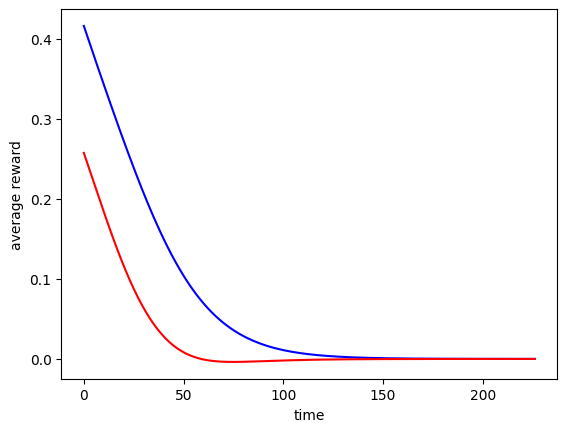

In [371]:
Rti = np.array([mae_5.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

In [372]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(1000, 2, 16, 2)

In [373]:
finalRni = np.array([mae_5.Ri(Xisa) for Xisa in finalXnisa])

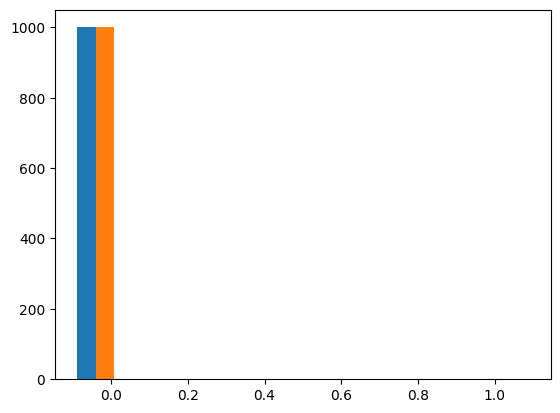

In [374]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [375]:
np.mean(finalRni[:,0] > 0.9) * 100

0.0

In [376]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000_het_case5.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

Shape of the data for Agent 0: (248, 2, 16, 2)
Shape of the data for Agent 1: (263, 2, 16, 2)


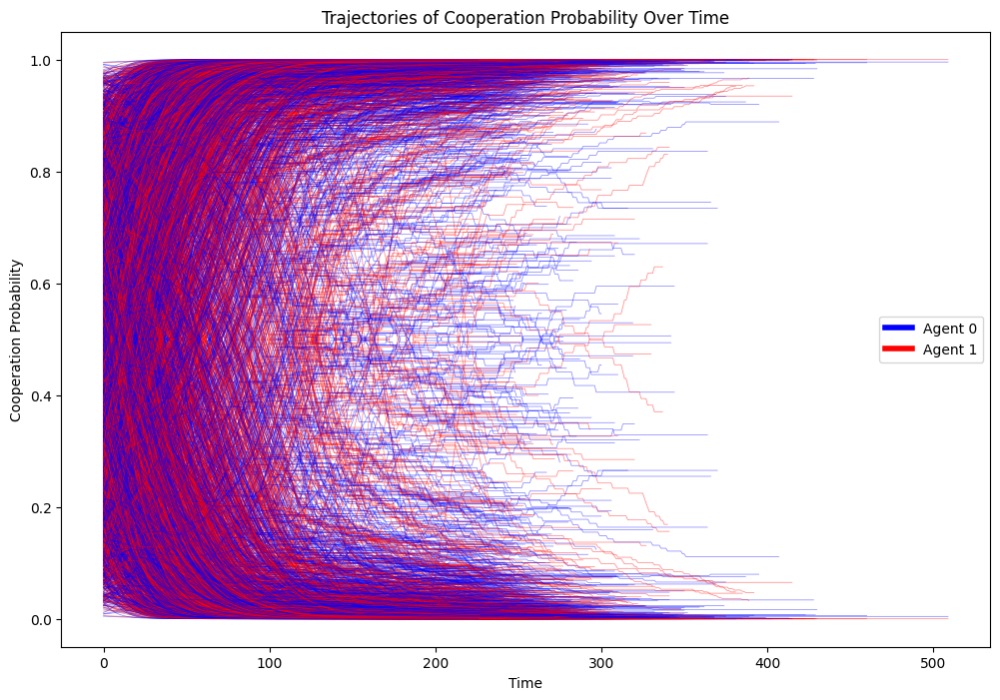

In [377]:
# Setup the plot
plt.figure(figsize=(12, 8))

# Define colors for clarity and reusability
colors = {'Agent 0': 'blue', 'Agent 1': 'red'}

# Check the shape of the data and print it
print("Shape of the data for Agent 0:", strategy_time_series[0].shape)
print("Shape of the data for Agent 1:", strategy_time_series[1].shape)

# Assume the data shape is (number of steps, number of variables, number of agents)
# We need to select which variable to plot, e.g., the first variable
variable_index = 0

# Loop through each simulation
for series in strategy_time_series:
    # Plot each trajectory for agent 0
    plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)
    # Plot each trajectory for agent 1
    plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)

# Adding plot labels and title
plt.xlabel('Time')
plt.ylabel('Cooperation Probability')
plt.title('Trajectories of Cooperation Probability Over Time')

# Create custom handles for the legend
custom_lines = [Line2D([0], [0], color=colors['Agent 0'], lw=4),
                Line2D([0], [0], color=colors['Agent 1'], lw=4)]

# Set the legend with custom handles
plt.legend(custom_lines, ['Agent 0', 'Agent 1'])

# Show the plot
plt.show()


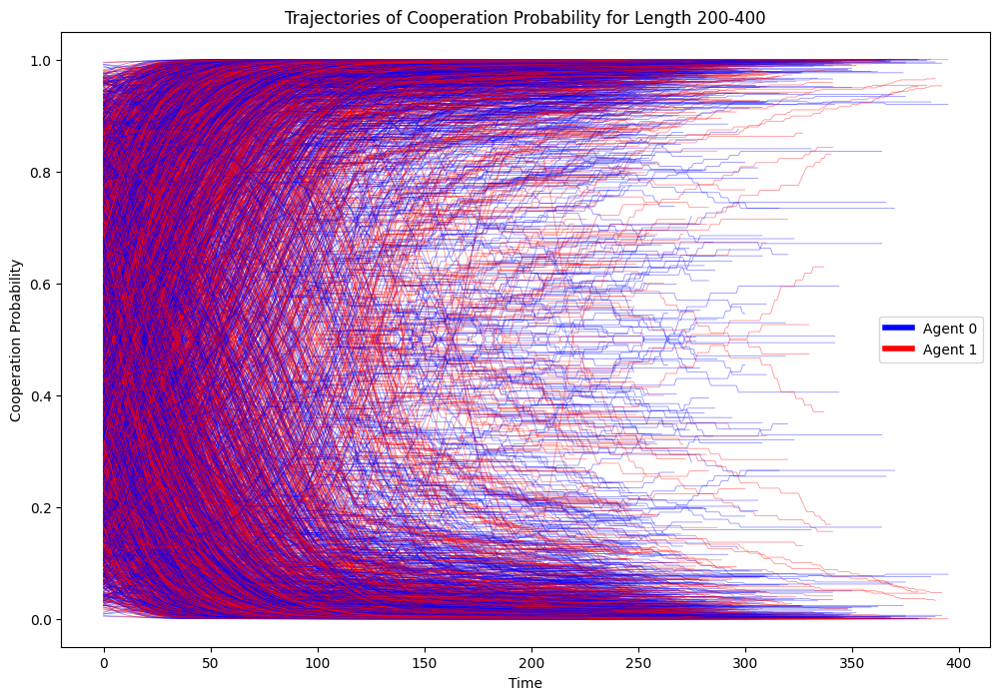

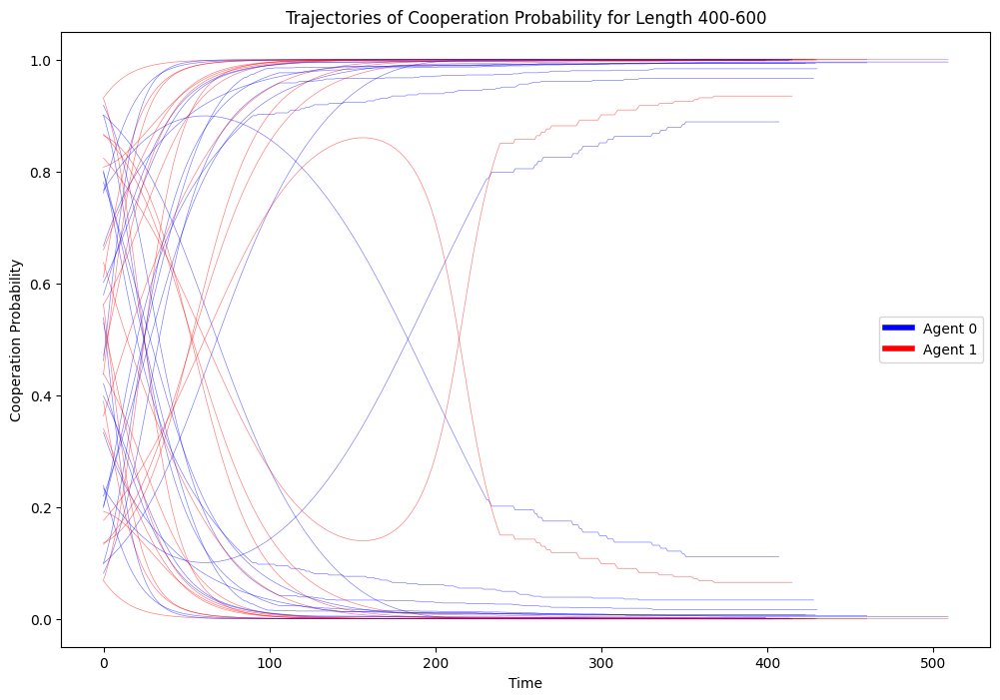

In [378]:
bins = [200, 400, 600, 800, 1000, 1200, 1400, 1600]
bin_labels = ['200-400', '400-600', '600-800', '800-1000', '1000-1200', '1200-1400', '1400-1600']

# Initialize a dictionary to hold categorized trajectories
categorized_trajectories = {label: [] for label in bin_labels}

# Categorize each trajectory based on its length
for series in strategy_time_series:
    length = len(series)
    for i, bin_edge in enumerate(bins):
        if length < bin_edge:
            category_label = bin_labels[i-1 if i != 0 else 0]
            categorized_trajectories[category_label].append(series)
            break

# Now, we have the trajectories categorized by length intervals
# Let's plot the trajectories for each interval
for category, trajectories in categorized_trajectories.items():
    if trajectories:  # Check if there are trajectories in this category
        plt.figure(figsize=(12, 8))
        plt.title(f'Trajectories of Cooperation Probability for Length {category}')
        plt.xlabel('Time')
        plt.ylabel('Cooperation Probability')
        
        for series in trajectories:
            plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)  # for Agent 0
            plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)  # for Agent 1
        
        plt.legend(custom_lines, ['Agent 0', 'Agent 1'])
        plt.show()


### Case6: Agent0 is fully observable and agent1 partially blind about agent0 but remembers all agent0's cooperation

In [2005]:
memo_ipd_6 = HistoryEmbedded(env, h=(2,2,2))

In [2006]:
memo_ipd_6.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [2023]:
memo_ipd_6.Oset[1] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|.,c,.|',
                         'c,c,.|.,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|.,c,.|',
                         'c,d,.|.,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|.,c,.|',
                         'd,c,.|.,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|.,c,.|',
                         'd,d,.|.,d,.|']

In [2024]:
memo_ipd_6.Oset

[['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|'],
 ['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|.,c,.|',
  'c,c,.|.,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|.,c,.|',
  'c,d,.|.,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|.,c,.|',
  'd,c,.|.,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|.,c,.|',
  'd,d,.|.,d,.|']]

In [2025]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_6.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_6.Oset[0])
memo_ipd_6.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_6.Oset[1])

In [2026]:
# Checking the observation set
len(memo_ipd_6.Sset)

16

In [2027]:
memo_ipd_6.O

array([[[1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0

In [2028]:
# Modify state set, so it represents the current game
state_set_6 = []
for i in range(len(memo_ipd_6.Oset[0])):
    sub_set_6 = f"a0 = {memo_ipd_6.Oset[0][i]} a1 = {memo_ipd_6.Oset[1][i]}"
    state_set_6.append(sub_set_6)
state_set_6

['a0 = c,c,.|c,c,.| a1 = c,c,.|c,c,.|',
 'a0 = c,c,.|c,d,.| a1 = c,c,.|c,d,.|',
 'a0 = c,c,.|d,c,.| a1 = c,c,.|.,c,.|',
 'a0 = c,c,.|d,d,.| a1 = c,c,.|.,d,.|',
 'a0 = c,d,.|c,c,.| a1 = c,d,.|c,c,.|',
 'a0 = c,d,.|c,d,.| a1 = c,d,.|c,d,.|',
 'a0 = c,d,.|d,c,.| a1 = c,d,.|.,c,.|',
 'a0 = c,d,.|d,d,.| a1 = c,d,.|.,d,.|',
 'a0 = d,c,.|c,c,.| a1 = d,c,.|c,c,.|',
 'a0 = d,c,.|c,d,.| a1 = d,c,.|c,d,.|',
 'a0 = d,c,.|d,c,.| a1 = d,c,.|.,c,.|',
 'a0 = d,c,.|d,d,.| a1 = d,c,.|.,d,.|',
 'a0 = d,d,.|c,c,.| a1 = d,d,.|c,c,.|',
 'a0 = d,d,.|c,d,.| a1 = d,d,.|c,d,.|',
 'a0 = d,d,.|d,c,.| a1 = d,d,.|.,c,.|',
 'a0 = d,d,.|d,d,.| a1 = d,d,.|.,d,.|']

In [2029]:
# Generate agents
mae_6 = POstratAC(env=memo_ipd_6, learning_rates=0.1, discount_factors=0.9)

In [2030]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_6.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_6.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case6.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case6.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [2031]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [2032]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 989


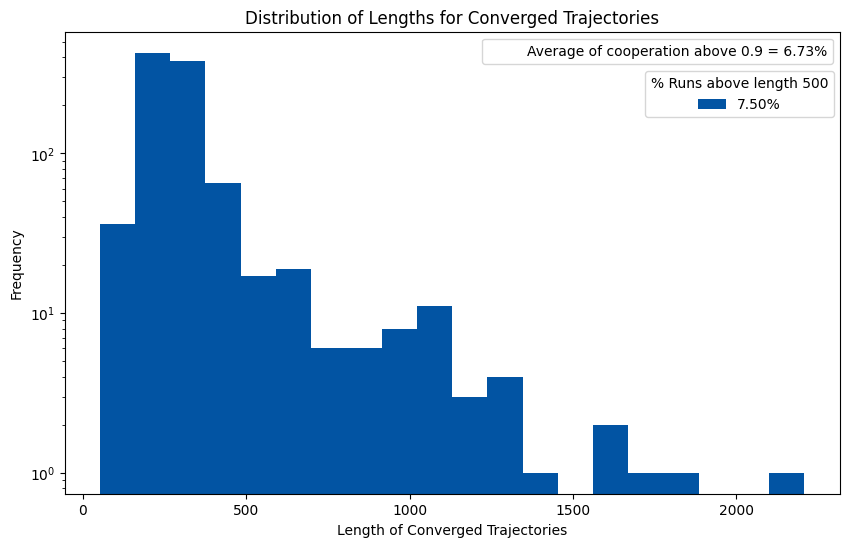

In [2033]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Plotting
plt.figure(figsize=(10, 6))
plt.hist(length_n, bins=20, log=True, color='#0254a3', label='7.50%')
plt.title('Distribution of Lengths for Converged Trajectories')
info_patch1 = plt.Line2D([0], [0], color='none', label='Average of cooperation above 0.9 = 6.73%')
first_legend = plt.legend(handles=[info_patch1], loc='upper right')
plt.gca().add_artist(first_legend)
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.legend(loc='upper left', bbox_to_anchor=(.74, .93), title="% Runs above length 500")
plt.savefig('distribution_full_obs.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI ensuring legend is included
plt.show()

In [2034]:
# Count the number of trajectories below length 520
below_520 = sum(1 for length in length_n if length < 500)

# Count the number of trajectories of length 520 or more
at_or_above_520 = len(length_n) - below_520

# Calculate percentage of each category
percentage_below_520 = (below_520 / len(length_n)) * 100
percentage_at_or_above_520 = (at_or_above_520 / len(length_n)) * 100

below_520, at_or_above_520, percentage_below_520, percentage_at_or_above_520


(910, 79, 92.01213346814964, 7.987866531850354)

In [2035]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([ 26,  35, 115, 135, 136, 252, 365, 477, 501, 836, 887])

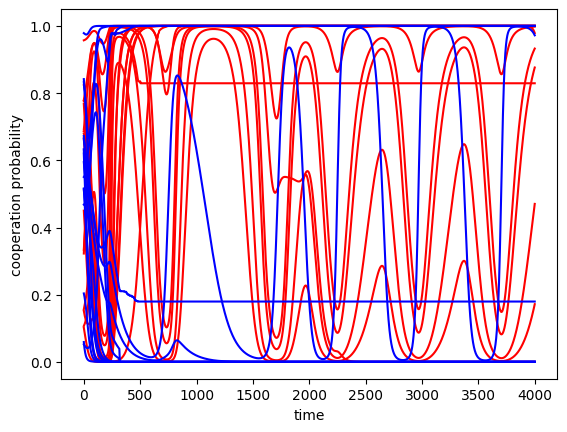

In [2036]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [2037]:
mae_6.obsdist(x)

Array([[0.10762993, 0.0491632 , 0.09247422, 0.06161077, 0.06663651,
        0.03806081, 0.08211082, 0.03097055, 0.07451714, 0.10807423,
        0.05809965, 0.05365815, 0.06209456, 0.02248044, 0.06166449,
        0.0307546 ],
       [0.15386707, 0.07996856, 0.04623713, 0.0308054 , 0.10769192,
        0.05354606, 0.0410554 , 0.01548527, 0.10356692, 0.13490331,
        0.02904982, 0.02682907, 0.09292682, 0.03785774, 0.03083225,
        0.0153773 ]], dtype=float32)

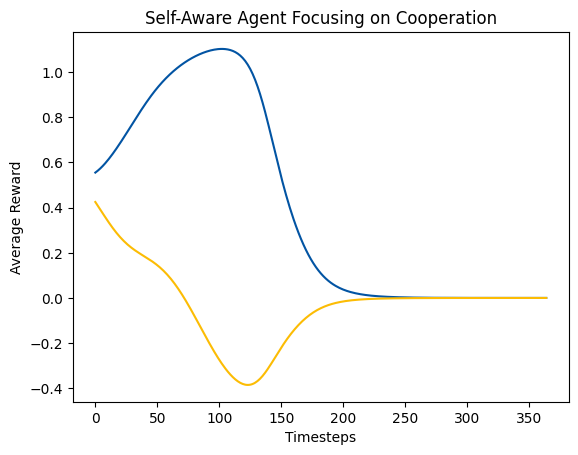

In [2038]:
Rti = np.array([mae_6.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='#0254a3', label='agent0')
plt.plot(Rti[:, 1], color='#fcbc04', label='agent1')
plt.xlabel('Timesteps'); plt.ylabel('Average Reward')
plt.title('Self-Aware Agent Focusing on Cooperation')
plt.savefig('reward.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI ensuring legend is included

In [1960]:
# def is_within_tolerance(value, target, tolerance):
#     return abs(value - target) <= tolerance

# def infer_agent_actions(rewards_agent0, rewards_agent1, R, T, S, P, tolerance):
#     # Calculate the average payoff for the game based on the defined rewards
#     average_payoff = (R + T + S + P) / 4

#     # CC: Check whether both agents (mostly) cooperated
#     if is_within_tolerance(rewards_agent0, R, tolerance) and  is_within_tolerance(rewards_agent1, R, tolerance):
#         return 'C', 'C'
#     # DD: Check whether both agents (mostly) defected
#     elif is_within_tolerance(rewards_agent0, P, tolerance) and is_within_tolerance(rewards_agent1, P, tolerance):
#         return 'D', 'D'
#     # DC: Check whether a0 exploited a1
#     elif is_within_tolerance(rewards_agent0, T, tolerance) or is_within_tolerance(rewards_agent0, R, tolerance) and is_within_tolerance(rewards_agent1, S, tolerance):
#         print('‼️')
#         return 'D', 'C'
#     # CD: Check whether a1 exploited a0
#     elif is_within_tolerance(rewards_agent1, T, tolerance) or is_within_tolerance(rewards_agent1, R, tolerance) and is_within_tolerance(rewards_agent0, S, tolerance):
#         print('‼️')
#         return 'C', 'D'
#     # Ambiguous cases, cannot determine action
#     elif is_within_tolerance(rewards_agent0, average_payoff, tolerance) or is_within_tolerance(rewards_agent1, average_payoff, tolerance):
#         return None
#     else:
#         # If reward is not within tolerance of any payoff, action is undetermined
#         return None
    
# # Initialize lists to hold inferred actions
# inferred_actions_agent0 = []
# inferred_actions_agent1 = []

# tolerance = 0.95

# rewards_mean_agent0 = []
# rewards_mean_agent1 = []
# zero = 0
# one = 0

# for i in range(len(Rti[:, 0])):
#     # print(Rti[:, 0][i])
#     # Rti[:, 0][i]
#     # for j in range (len(Rti[:, 0][i])):
#     rewards_mean_agent0.append(Rti[:, 0][i])
#     print(Rti[:, 0][i])
#     #     # zero += Rti[:, 0][i].mean()
#     rewards_mean_agent1.append(Rti[:, 1][i])
#     print(Rti[:, 1][i])
#     #     # one += Rti[:, 1][i].mean()
#     print('-')
    
# print(zero)
# print(one)

# # Iterate over each reward and infer actions for both agents
# for reward0, reward1 in zip(rewards_mean_agent0, rewards_mean_agent1):
#     actions = infer_agent_actions(reward0, reward1, R=1.0, T=1.2, S=-0.5, P=0.0, tolerance=tolerance)
#     if actions is None:
#         inferred_actions_agent0.append(None)
#         inferred_actions_agent1.append(None)
#     else:
#         inferred_actions_agent0.append(actions[0])
#         inferred_actions_agent1.append(actions[1])

# # Output the results
# for i in range(len(inferred_actions_agent0)):
#     print(f"Game {i}: Agent0 likely average action: {inferred_actions_agent0[i]}, Agent1 likely average action: {inferred_actions_agent1[i]}")

In [1961]:
Rti_6 = Rti

In [1962]:
Rti_6.shape

(234, 2)

In [1963]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(988, 2, 16, 2)

In [1964]:
finalRni = np.array([mae_6.Ri(Xisa) for Xisa in finalXnisa])

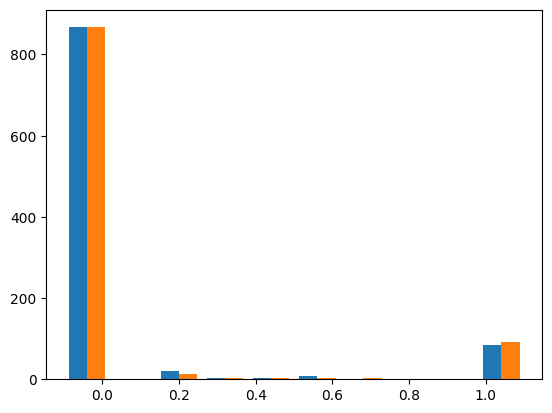

In [1965]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [1966]:
np.mean(finalRni[:,0] > 0.9) * 100

8.906882591093117

In [1967]:
np.mean(finalRni[:,1] > 0.9) * 100

9.51417004048583

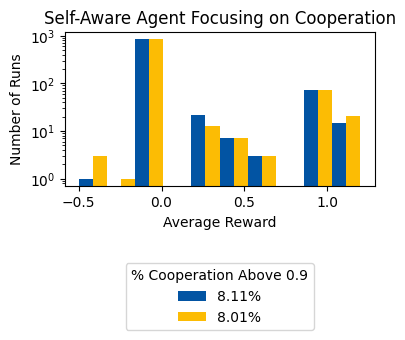

In [1968]:
plt.figure(figsize=(4, 2)) 
plt.hist([(finalRni[:,0]), (finalRni[:,1])], color=['#0254a3', '#fcbc04'], label=['8.11%','8.01%'], range=(-.5, 1.2), rwidth=35, log=True)
plt.title('Self-Aware Agent Focusing on Cooperation')
plt.legend(loc='center', bbox_to_anchor=(.5, -0.72), title="% Cooperation Above 0.9")
plt.savefig('filename.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI
plt.xlabel('Average Reward');
plt.ylabel('Number of Runs');

In [1871]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000_het_case6.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

In [694]:
# # Setup the plot
# plt.figure(figsize=(12, 8))

# # Define colors for clarity and reusability
# colors = {'Agent 0': 'blue', 'Agent 1': 'red'}

# # Check the shape of the data and print it
# print("Shape of the data for Agent 0:", strategy_time_series[0].shape)
# print("Shape of the data for Agent 1:", strategy_time_series[1].shape)

# # Assume the data shape is (number of steps, number of variables, number of agents)
# # We need to select which variable to plot, e.g., the first variable
# variable_index = 0

# # Loop through each simulation
# for series in strategy_time_series:
#     # Plot each trajectory for agent 0
#     plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)
#     # Plot each trajectory for agent 1
#     plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)

# # Adding plot labels and title
# plt.xlabel('Time')
# plt.ylabel('Cooperation Probability')
# plt.title('Trajectories of Cooperation Probability Over Time')

# # Create custom handles for the legend
# custom_lines = [Line2D([0], [0], color=colors['Agent 0'], lw=4),
#                 Line2D([0], [0], color=colors['Agent 1'], lw=4)]

# # Set the legend with custom handles
# plt.legend(custom_lines, ['Agent 0', 'Agent 1'])

# # Show the plot
# plt.show()


In [693]:
# bins = [200, 400, 600, 800, 1000, 1200, 1400, 1600]
# bin_labels = ['200-400', '400-600', '600-800', '800-1000', '1000-1200', '1200-1400', '1400-1600']

# # Initialize a dictionary to hold categorized trajectories
# categorized_trajectories = {label: [] for label in bin_labels}

# # Categorize each trajectory based on its length
# for series in strategy_time_series:
#     length = len(series)
#     for i, bin_edge in enumerate(bins):
#         if length < bin_edge:
#             category_label = bin_labels[i-1 if i != 0 else 0]
#             categorized_trajectories[category_label].append(series)
#             break

# # Now, we have the trajectories categorized by length intervals
# # Let's plot the trajectories for each interval
# for category, trajectories in categorized_trajectories.items():
#     if trajectories:  # Check if there are trajectories in this category
#         plt.figure(figsize=(12, 8))
#         plt.title(f'Trajectories of Cooperation Probability for Length {category}')
#         plt.xlabel('Time')
#         plt.ylabel('Cooperation Probability')
        
#         for series in trajectories:
#             plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)  # for Agent 0
#             plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)  # for Agent 1
        
#         plt.legend(custom_lines, ['Agent 0', 'Agent 1'])
#         plt.show()


### Case7: Agent0 is fully observable and agent1 partially blind about agent0 but remembers all agent0's defection

In [1916]:
memo_ipd_7 = HistoryEmbedded(env, h=(2,2,2))

In [1917]:
memo_ipd_7.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [1918]:
memo_ipd_7.Oset[1] =    ['c,c,.|.,c,.|',
                         'c,c,.|.,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|.,c,.|',
                         'c,d,.|.,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|.,c,.|',
                         'd,c,.|.,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|.,c,.|',
                         'd,d,.|.,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [1919]:
memo_ipd_7.Oset

[['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|'],
 ['c,c,.|.,c,.|',
  'c,c,.|.,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|.,c,.|',
  'c,d,.|.,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|.,c,.|',
  'd,c,.|.,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|.,c,.|',
  'd,d,.|.,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|']]

In [1920]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_7.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_7.Oset[0])
memo_ipd_7.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_7.Oset[1])

In [1921]:
memo_ipd_7.O

array([[[1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0

In [1922]:
# Modify state set, so it represents the current game
state_set_7 = []
for i in range(len(memo_ipd_7.Oset[0])):
    sub_set_7 = f"a0 = {memo_ipd_7.Oset[0][i]} a1 = {memo_ipd_7.Oset[1][i]}"
    state_set_7.append(sub_set_7)
state_set_7

['a0 = c,c,.|c,c,.| a1 = c,c,.|.,c,.|',
 'a0 = c,c,.|c,d,.| a1 = c,c,.|.,d,.|',
 'a0 = c,c,.|d,c,.| a1 = c,c,.|d,c,.|',
 'a0 = c,c,.|d,d,.| a1 = c,c,.|d,d,.|',
 'a0 = c,d,.|c,c,.| a1 = c,d,.|.,c,.|',
 'a0 = c,d,.|c,d,.| a1 = c,d,.|.,d,.|',
 'a0 = c,d,.|d,c,.| a1 = c,d,.|d,c,.|',
 'a0 = c,d,.|d,d,.| a1 = c,d,.|d,d,.|',
 'a0 = d,c,.|c,c,.| a1 = d,c,.|.,c,.|',
 'a0 = d,c,.|c,d,.| a1 = d,c,.|.,d,.|',
 'a0 = d,c,.|d,c,.| a1 = d,c,.|d,c,.|',
 'a0 = d,c,.|d,d,.| a1 = d,c,.|d,d,.|',
 'a0 = d,d,.|c,c,.| a1 = d,d,.|.,c,.|',
 'a0 = d,d,.|c,d,.| a1 = d,d,.|.,d,.|',
 'a0 = d,d,.|d,c,.| a1 = d,d,.|d,c,.|',
 'a0 = d,d,.|d,d,.| a1 = d,d,.|d,d,.|']

In [1923]:
# Generate agents
mae_7 = POstratAC(env=memo_ipd_7, learning_rates=0.1, discount_factors=0.9)

In [1924]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_7.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_7.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case7.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case7.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [1925]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [1926]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 991


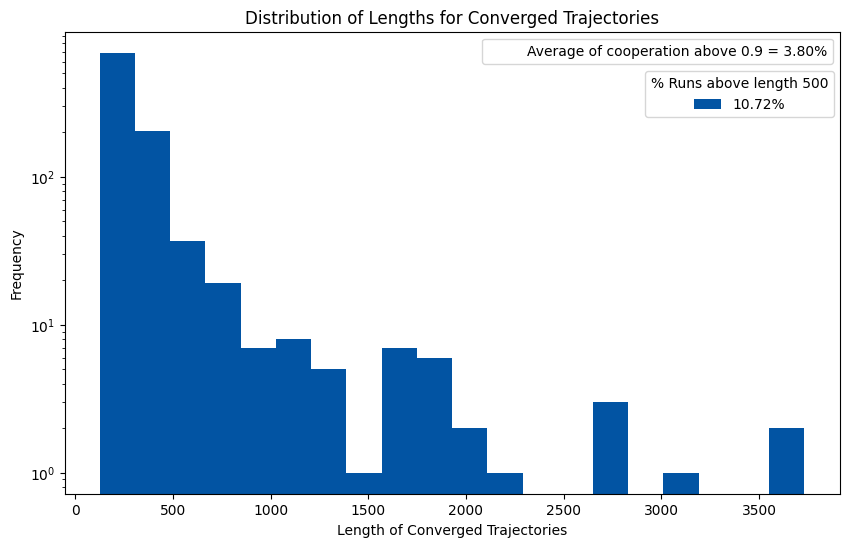

In [1927]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Plotting
plt.figure(figsize=(10, 6))
plt.hist(length_n, bins=20, log=True, color='#0254a3', label='10.72%')
plt.title('Distribution of Lengths for Converged Trajectories')
info_patch1 = plt.Line2D([0], [0], color='none', label='Average of cooperation above 0.9 = 3.80%')
first_legend = plt.legend(handles=[info_patch1], loc='upper right')
plt.gca().add_artist(first_legend)
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.legend(loc='upper left', bbox_to_anchor=(.74, .93), title="% Runs above length 500")
plt.savefig('distribution_full_obs.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI ensuring legend is included
plt.show()

In [1928]:
# Count the number of trajectories below length 520
below_520 = sum(1 for length in length_n if length < 500)

# Count the number of trajectories of length 520 or more
at_or_above_520 = len(length_n) - below_520

# Calculate percentage of each category
percentage_below_520 = (below_520 / len(length_n)) * 100
percentage_at_or_above_520 = (at_or_above_520 / len(length_n)) * 100

below_520, at_or_above_520, percentage_below_520, percentage_at_or_above_520


(893, 98, 90.11099899091826, 9.889001009081735)

In [1929]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([  7,  16, 216, 302, 473, 674, 683, 801, 857])

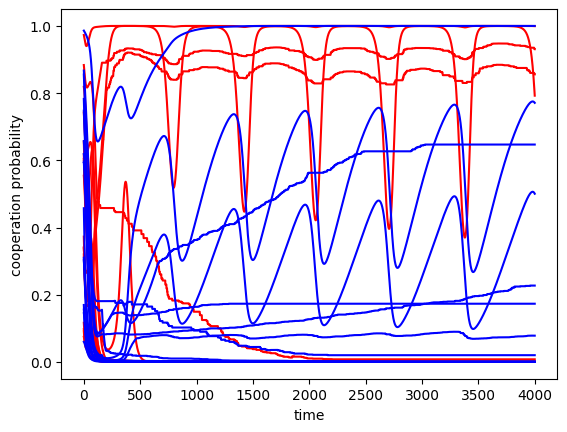

In [1930]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [1931]:
mae_7.obsdist(x)

Array([[0.00542144, 0.01367842, 0.02846797, 0.16420619, 0.0316655 ,
        0.04806788, 0.0817729 , 0.06770951, 0.01751439, 0.06482822,
        0.02394271, 0.08789121, 0.15717258, 0.10264133, 0.05999279,
        0.04502693],
       [0.00271071, 0.00683921, 0.03117865, 0.17104541, 0.01583276,
        0.02403397, 0.09760567, 0.09174353, 0.00875718, 0.03241407,
        0.03269988, 0.12030522, 0.0785863 , 0.05132071, 0.13857915,
        0.0963477 ]], dtype=float32)

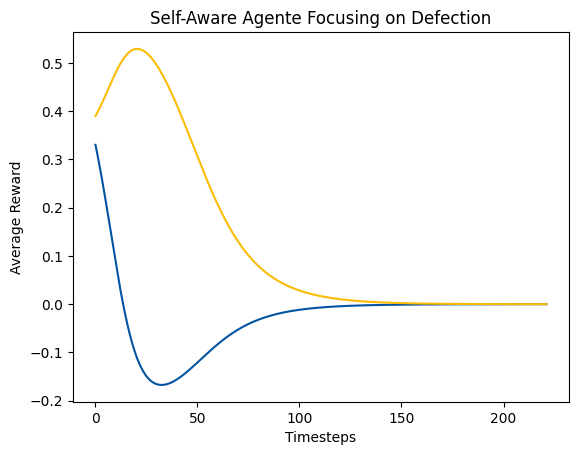

In [1935]:
Rti = np.array([mae_7.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='#0254a3', label='agent0')
plt.plot(Rti[:, 1], color='#fcbc04', label='agent1')
plt.xlabel('Timesteps'); plt.ylabel('Average Reward')
plt.title('Self-Aware Agente Focusing on Defection')
plt.savefig('reward.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI ensuring legend is included

In [1958]:
def is_within_tolerance(value, target, tolerance):
    return abs(value - target) <= tolerance

def infer_agent_actions(rewards_agent0, rewards_agent1, R, T, S, P, tolerance):
    # Calculate the average payoff for the game based on the defined rewards
    average_payoff = (R + T + S + P) / 4

    # CC: Check whether both agents (mostly) cooperated
    if is_within_tolerance(rewards_agent0, R, tolerance) and  is_within_tolerance(rewards_agent1, R, tolerance):
        return 'C', 'C'
    # DD: Check whether both agents (mostly) defected
    elif is_within_tolerance(rewards_agent0, P, tolerance) and is_within_tolerance(rewards_agent1, P, tolerance):
        return 'D', 'D'
    # DC: Check whether a0 exploited a1
    elif is_within_tolerance(rewards_agent0, T, tolerance) or is_within_tolerance(rewards_agent0, R, tolerance) and is_within_tolerance(rewards_agent1, S, tolerance):
        print('‼️')
        return 'D', 'C'
    # CD: Check whether a1 exploited a0
    elif is_within_tolerance(rewards_agent1, T, tolerance) or is_within_tolerance(rewards_agent1, R, tolerance) and is_within_tolerance(rewards_agent0, S, tolerance):
        print('‼️')
        return 'C', 'D'
    # Ambiguous cases, cannot determine action
    elif is_within_tolerance(rewards_agent0, average_payoff, tolerance) or is_within_tolerance(rewards_agent1, average_payoff, tolerance):
        return None
    else:
        # If reward is not within tolerance of any payoff, action is undetermined
        return None
    
# Initialize lists to hold inferred actions
inferred_actions_agent0 = []
inferred_actions_agent1 = []

tolerance = 0.6

rewards_mean_agent0 = []
rewards_mean_agent1 = []
zero = 0
one = 0

for i in range(len(Rti[:, 0])):
    # print(Rti[:, 0][i])
    # Rti[:, 0][i]
    # for j in range (len(Rti[:, 0][i])):
    rewards_mean_agent0.append(Rti[:, 0][i])
    # print(Rti[:, 0][i])
    #     # zero += Rti[:, 0][i].mean()
    rewards_mean_agent1.append(Rti[:, 1][i])
    # print(Rti[:, 1][i])
    #     # one += Rti[:, 1][i].mean()
    # print('-')
    
print(zero)
print(one)

# Iterate over each reward and infer actions for both agents
for reward0, reward1 in zip(rewards_mean_agent0, rewards_mean_agent1):
    actions = infer_agent_actions(reward0, reward1, R=1.0, T=1.2, S=-0.5, P=0.0, tolerance=tolerance)
    if actions is None:
        inferred_actions_agent0.append(None)
        inferred_actions_agent1.append(None)
    else:
        inferred_actions_agent0.append(actions[0])
        inferred_actions_agent1.append(actions[1])

# Output the results
for i in range(len(inferred_actions_agent0)):
    print(f"Game {i}: Agent0 likely average action: {inferred_actions_agent0[i]}, Agent1 likely average action: {inferred_actions_agent1[i]}")

0
0
Game 0: Agent0 likely average action: D, Agent1 likely average action: D
Game 1: Agent0 likely average action: D, Agent1 likely average action: D
Game 2: Agent0 likely average action: D, Agent1 likely average action: D
Game 3: Agent0 likely average action: D, Agent1 likely average action: D
Game 4: Agent0 likely average action: D, Agent1 likely average action: D
Game 5: Agent0 likely average action: D, Agent1 likely average action: D
Game 6: Agent0 likely average action: D, Agent1 likely average action: D
Game 7: Agent0 likely average action: D, Agent1 likely average action: D
Game 8: Agent0 likely average action: D, Agent1 likely average action: D
Game 9: Agent0 likely average action: D, Agent1 likely average action: D
Game 10: Agent0 likely average action: D, Agent1 likely average action: D
Game 11: Agent0 likely average action: D, Agent1 likely average action: D
Game 12: Agent0 likely average action: D, Agent1 likely average action: D
Game 13: Agent0 likely average action: D, Ag

In [ ]:
Rti_7 = np.array([mae_7.Ri(x) for x in Xtisa])

In [1833]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(993, 2, 16, 2)

In [948]:
finalRni = np.array([mae_7.Ri(Xisa) for Xisa in finalXnisa])

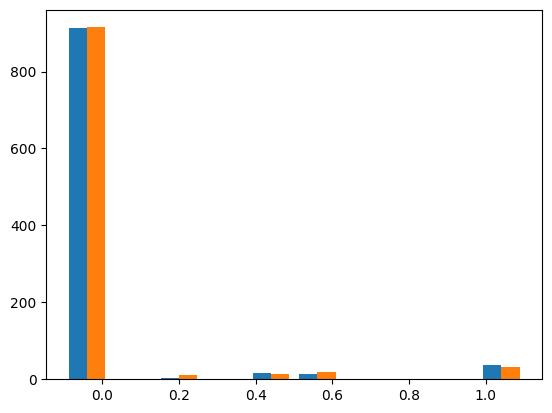

In [949]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [950]:
np.mean(finalRni[:,0] > 0.9) * 100

4.308617234468938

In [951]:
np.mean(finalRni[:,1] > 0.9) * 100

3.306613226452906

In [620]:
Rti_7 = Rti

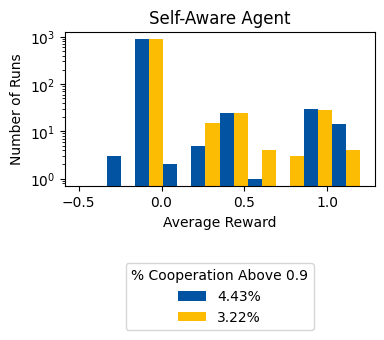

In [625]:
plt.figure(figsize=(4, 2)) 
plt.hist([(finalRni[:,0]), (finalRni[:,1])], color=['#0254a3', '#fcbc04'], label=['4.43%','3.22%'], range=(-.5, 1.2), rwidth=35, log=True)
plt.title('Self-Aware Agent')
plt.legend(loc='center', bbox_to_anchor=(.5, -0.72), title="% Cooperation Above 0.9")
plt.savefig('filename.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI
plt.xlabel('Average Reward');
plt.ylabel('Number of Runs');

In [159]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000_het_case7.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

Shape of the data for Agent 0: (266, 2, 16, 2)
Shape of the data for Agent 1: (644, 2, 16, 2)


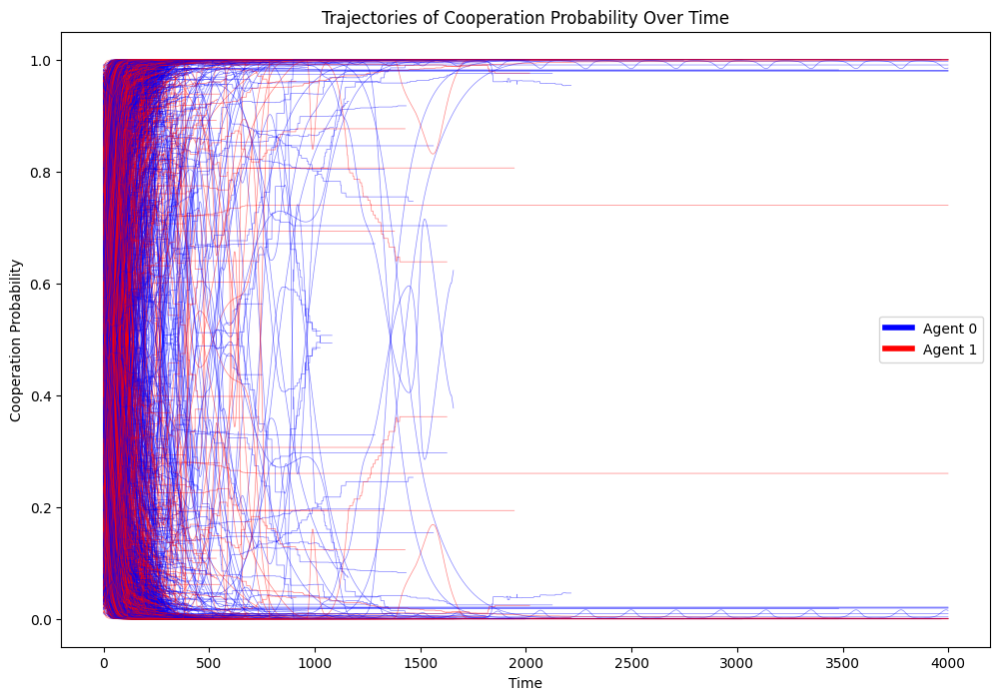

In [160]:
# Setup the plot
plt.figure(figsize=(12, 8))

# Define colors for clarity and reusability
colors = {'Agent 0': 'blue', 'Agent 1': 'red'}

# Check the shape of the data and print it
print("Shape of the data for Agent 0:", strategy_time_series[0].shape)
print("Shape of the data for Agent 1:", strategy_time_series[1].shape)

# Assume the data shape is (number of steps, number of variables, number of agents)
# We need to select which variable to plot, e.g., the first variable
variable_index = 0

# Loop through each simulation
for series in strategy_time_series:
    # Plot each trajectory for agent 0
    plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)
    # Plot each trajectory for agent 1
    plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)

# Adding plot labels and title
plt.xlabel('Time')
plt.ylabel('Cooperation Probability')
plt.title('Trajectories of Cooperation Probability Over Time')

# Create custom handles for the legend
custom_lines = [Line2D([0], [0], color=colors['Agent 0'], lw=4),
                Line2D([0], [0], color=colors['Agent 1'], lw=4)]

# Set the legend with custom handles
plt.legend(custom_lines, ['Agent 0', 'Agent 1'])

# Show the plot
plt.show()


/Users/mariana/.pyenv/versions/3.10.3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


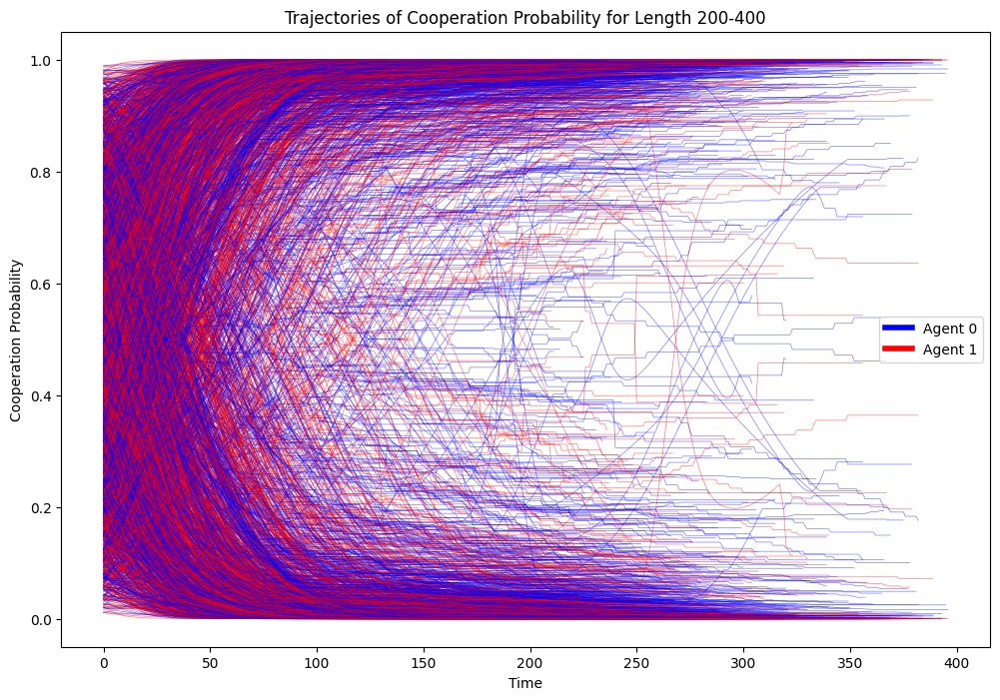

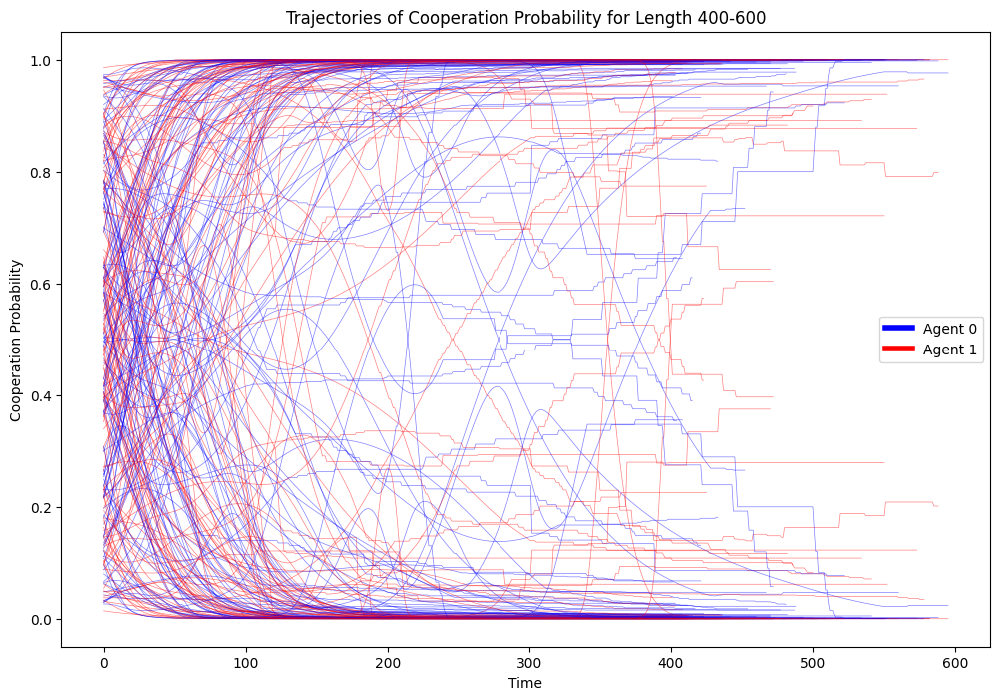

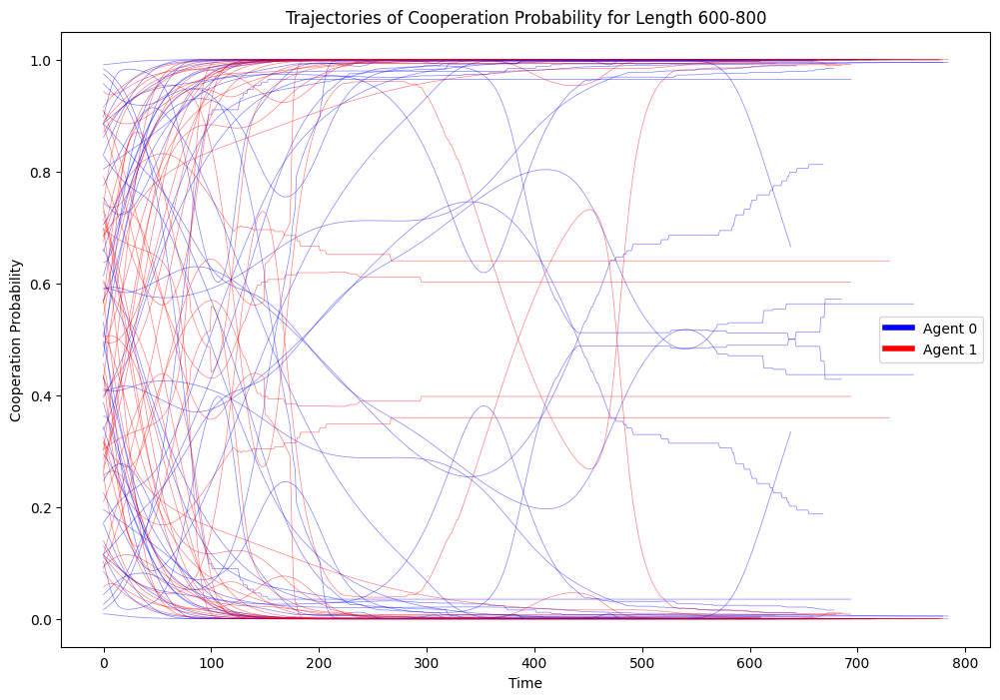

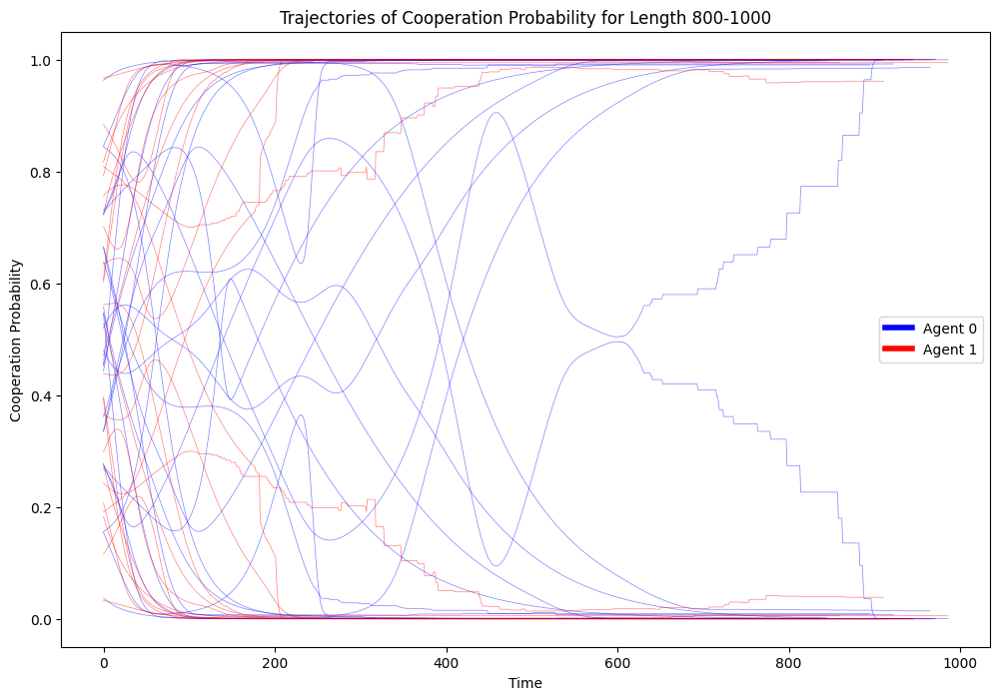

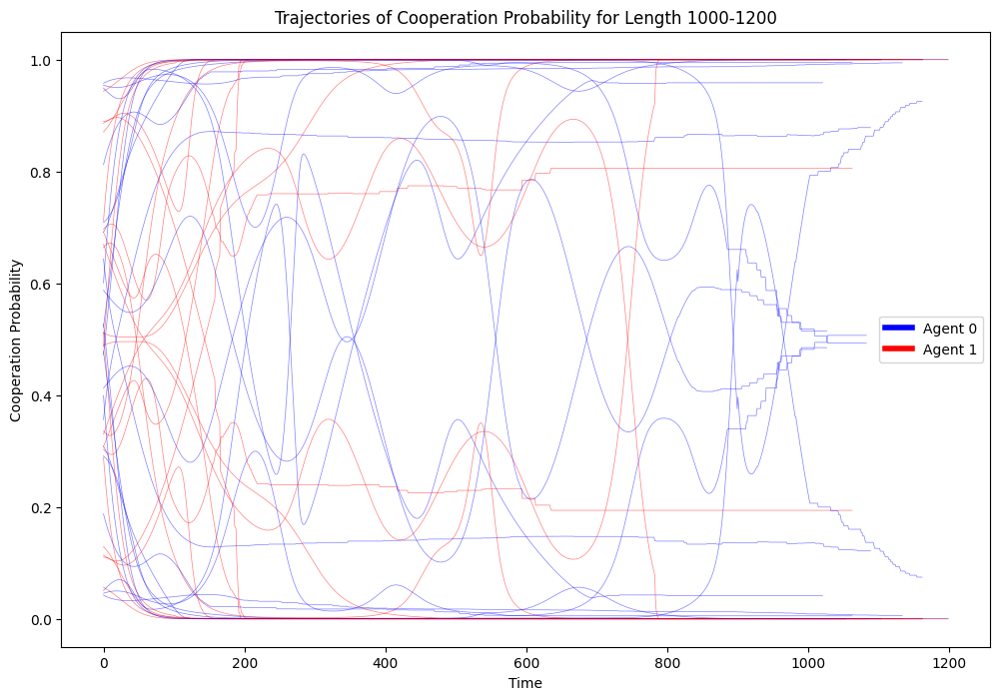

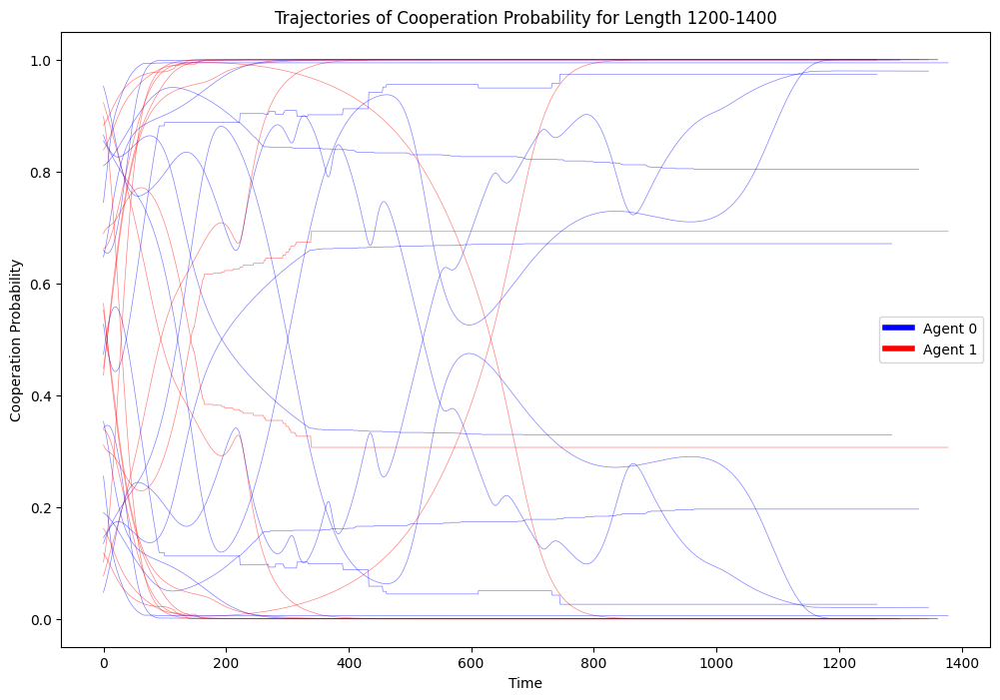

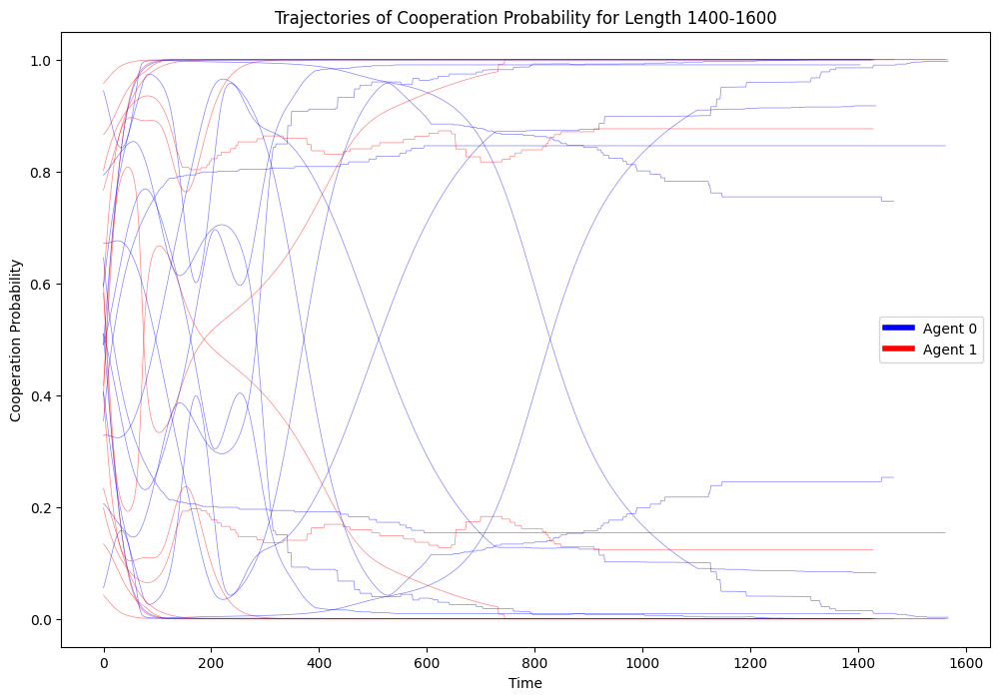

In [161]:
bins = [200, 400, 600, 800, 1000, 1200, 1400, 1600]
bin_labels = ['200-400', '400-600', '600-800', '800-1000', '1000-1200', '1200-1400', '1400-1600']

# Initialize a dictionary to hold categorized trajectories
categorized_trajectories = {label: [] for label in bin_labels}

# Categorize each trajectory based on its length
for series in strategy_time_series:
    length = len(series)
    for i, bin_edge in enumerate(bins):
        if length < bin_edge:
            category_label = bin_labels[i-1 if i != 0 else 0]
            categorized_trajectories[category_label].append(series)
            break

# Now, we have the trajectories categorized by length intervals
# Let's plot the trajectories for each interval
for category, trajectories in categorized_trajectories.items():
    if trajectories:  # Check if there are trajectories in this category
        plt.figure(figsize=(12, 8))
        plt.title(f'Trajectories of Cooperation Probability for Length {category}')
        plt.xlabel('Time')
        plt.ylabel('Cooperation Probability')
        
        for series in trajectories:
            plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)  # for Agent 0
            plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)  # for Agent 1
        
        plt.legend(custom_lines, ['Agent 0', 'Agent 1'])
        plt.show()


### Case8: Agent0 is fully observable and agent1 partially blind about itself but remembers all of its own cooperation

In [ ]:
memo_ipd_8 = HistoryEmbedded(env, h=(2,2,2))

In [ ]:
memo_ipd_8.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [ ]:
memo_ipd_8.Oset[1] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,.,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,.,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,.,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,.,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,.,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,.,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,.,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,.,.|']

In [ ]:
memo_ipd_8.Oset

In [ ]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_8.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_8.Oset[0])
memo_ipd_8.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_8.Oset[1])

In [ ]:
memo_ipd_8.O

In [ ]:
# Modify state set, so it represents the current game
state_set_8 = []
for i in range(len(memo_ipd_8.Oset[0])):
    sub_set_8 = f"a0 = {memo_ipd_8.Oset[0][i]} a1 = {memo_ipd_8.Oset[1][i]}"
    state_set_8.append(sub_set_8)
state_set_8

In [ ]:
# Generate agents
mae_8 = POstratAC(env=memo_ipd_8, learning_rates=0.1, discount_factors=0.9)

In [ ]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_8.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_8.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case8.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case8.npy', Cn_array)

print("\nData saved successfully.")

#### Experiments

In [ ]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

In [ ]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

In [ ]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Analyze the distribution of final strategies' lengths if necessary
plt.hist(length_n, bins=20)
plt.title('Distribution of Lengths for Converged Trajectories')
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.show()

In [ ]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

In [ ]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [ ]:
mae_8.obsdist(x)

In [ ]:
Rti = np.array([mae_8.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

In [ ]:
Rti_8 = np.array([mae_8.Ri(x) for x in Xtisa])

In [325]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(1000, 2, 16, 2)

In [326]:
finalRni = np.array([mae_8.Ri(Xisa) for Xisa in finalXnisa])

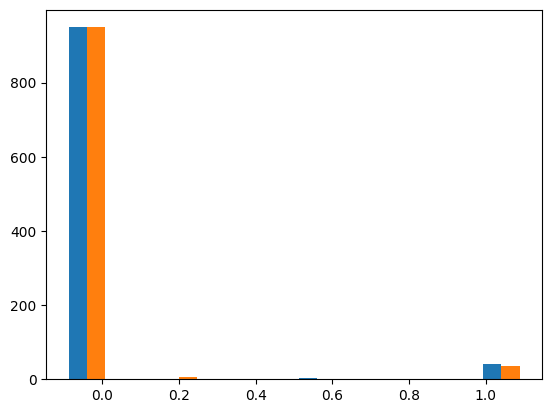

In [327]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [328]:
np.mean(finalRni[:,0] > 0.9) * 100

4.1000000000000005

In [329]:
Rti_8 = Rti

In [330]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000_het_case8.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

Shape of the data for Agent 0: (361, 2, 16, 2)
Shape of the data for Agent 1: (316, 2, 16, 2)


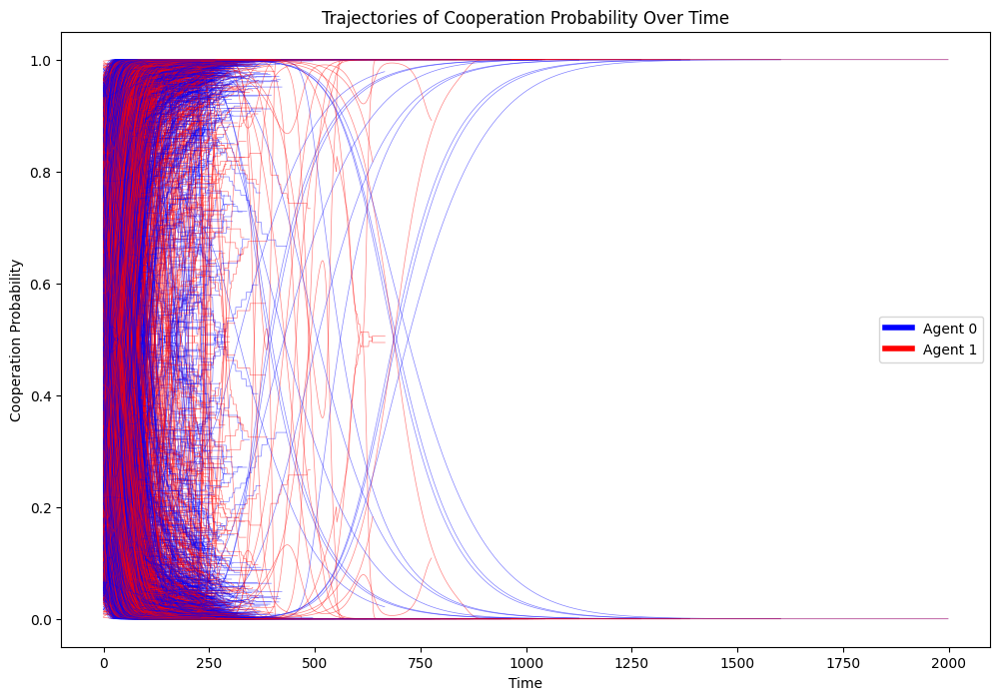

In [450]:
# Setup the plot
plt.figure(figsize=(12, 8))

# Define colors for clarity and reusability
colors = {'Agent 0': 'blue', 'Agent 1': 'red'}

# Check the shape of the data and print it
print("Shape of the data for Agent 0:", strategy_time_series[0].shape)
print("Shape of the data for Agent 1:", strategy_time_series[1].shape)

# Assume the data shape is (number of steps, number of variables, number of agents)
# We need to select which variable to plot, e.g., the first variable
variable_index = 0

# Loop through each simulation
for series in strategy_time_series:
    # Plot each trajectory for agent 0
    plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)
    # Plot each trajectory for agent 1
    plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)

# Adding plot labels and title
plt.xlabel('Time')
plt.ylabel('Cooperation Probability')
plt.title('Trajectories of Cooperation Probability Over Time')

# Create custom handles for the legend
custom_lines = [Line2D([0], [0], color=colors['Agent 0'], lw=4),
                Line2D([0], [0], color=colors['Agent 1'], lw=4)]

# Set the legend with custom handles
plt.legend(custom_lines, ['Agent 0', 'Agent 1'])

# Show the plot
plt.show()


In [ ]:
bins = [200, 400, 600, 800, 1000, 1200, 1400, 1600]
bin_labels = ['200-400', '400-600', '600-800', '800-1000', '1000-1200', '1200-1400', '1400-1600']

# Initialize a dictionary to hold categorized trajectories
categorized_trajectories = {label: [] for label in bin_labels}

# Categorize each trajectory based on its length
for series in strategy_time_series:
    length = len(series)
    for i, bin_edge in enumerate(bins):
        if length < bin_edge:
            category_label = bin_labels[i-1 if i != 0 else 0]
            categorized_trajectories[category_label].append(series)
            break

# Now, we have the trajectories categorized by length intervals
# Let's plot the trajectories for each interval
for category, trajectories in categorized_trajectories.items():
    if trajectories:  # Check if there are trajectories in this category
        plt.figure(figsize=(12, 8))
        plt.title(f'Trajectories of Cooperation Probability for Length {category}')
        plt.xlabel('Time')
        plt.ylabel('Cooperation Probability')
        
        for series in trajectories:
            plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)  # for Agent 0
            plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)  # for Agent 1
        
        plt.legend(custom_lines, ['Agent 0', 'Agent 1'])
        plt.show()


### Case9: Agent0 is fully observable and agent1 partially blind about itself but remembers all of its own defection

In [893]:
memo_ipd_9 = HistoryEmbedded(env, h=(2,2,2))

In [894]:
memo_ipd_9.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [895]:
memo_ipd_9.Oset[1] =    ['c,c,.|c,.,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,.,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,.,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,.,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,.,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,.,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,.,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,.,.|',
                         'd,d,.|d,d,.|']

In [896]:
memo_ipd_9.Oset

[['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|'],
 ['c,c,.|c,.,.|',
  'c,c,.|c,d,.|',
  'c,c,.|d,.,.|',
  'c,c,.|d,d,.|',
  'c,d,.|c,.,.|',
  'c,d,.|c,d,.|',
  'c,d,.|d,.,.|',
  'c,d,.|d,d,.|',
  'd,c,.|c,.,.|',
  'd,c,.|c,d,.|',
  'd,c,.|d,.,.|',
  'd,c,.|d,d,.|',
  'd,d,.|c,.,.|',
  'd,d,.|c,d,.|',
  'd,d,.|d,.,.|',
  'd,d,.|d,d,.|']]

In [897]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_9.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_9.Oset[0])
memo_ipd_9.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_9.Oset[1])

In [898]:
memo_ipd_9.O

array([[[1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0

In [899]:
# Modify state set, so it represents the current game
state_set_9 = []
for i in range(len(memo_ipd_9.Oset[0])):
    sub_set_9 = f"a0 = {memo_ipd_9.Oset[0][i]} a1 = {memo_ipd_9.Oset[1][i]}"
    state_set_9.append(sub_set_9)
state_set_9

['a0 = c,c,.|c,c,.| a1 = c,c,.|c,.,.|',
 'a0 = c,c,.|c,d,.| a1 = c,c,.|c,d,.|',
 'a0 = c,c,.|d,c,.| a1 = c,c,.|d,.,.|',
 'a0 = c,c,.|d,d,.| a1 = c,c,.|d,d,.|',
 'a0 = c,d,.|c,c,.| a1 = c,d,.|c,.,.|',
 'a0 = c,d,.|c,d,.| a1 = c,d,.|c,d,.|',
 'a0 = c,d,.|d,c,.| a1 = c,d,.|d,.,.|',
 'a0 = c,d,.|d,d,.| a1 = c,d,.|d,d,.|',
 'a0 = d,c,.|c,c,.| a1 = d,c,.|c,.,.|',
 'a0 = d,c,.|c,d,.| a1 = d,c,.|c,d,.|',
 'a0 = d,c,.|d,c,.| a1 = d,c,.|d,.,.|',
 'a0 = d,c,.|d,d,.| a1 = d,c,.|d,d,.|',
 'a0 = d,d,.|c,c,.| a1 = d,d,.|c,.,.|',
 'a0 = d,d,.|c,d,.| a1 = d,d,.|c,d,.|',
 'a0 = d,d,.|d,c,.| a1 = d,d,.|d,.,.|',
 'a0 = d,d,.|d,d,.| a1 = d,d,.|d,d,.|']

In [900]:
# Generate agents
mae_9 = POstratAC(env=memo_ipd_9, learning_rates=0.1, discount_factors=0.9)

In [901]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_9.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_9.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case9.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case9.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [902]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [903]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 987


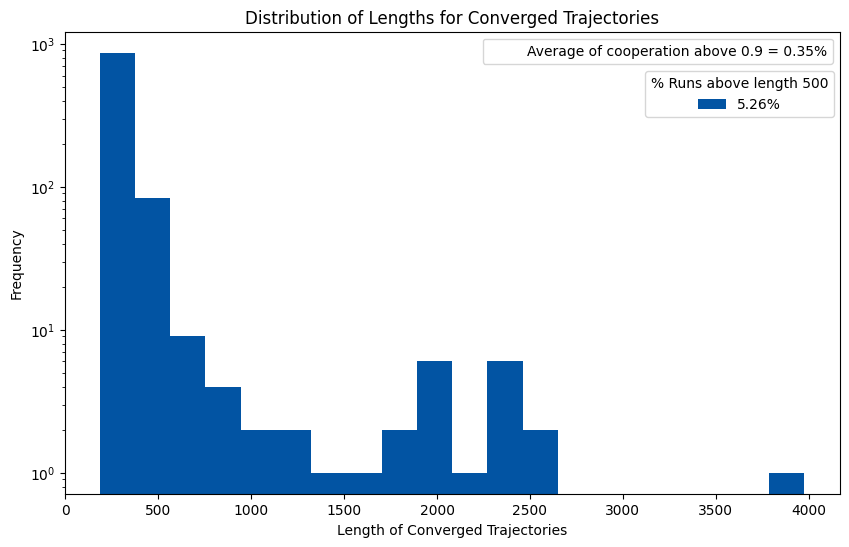

In [915]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Plotting
plt.figure(figsize=(10, 6))
plt.hist(length_n, bins=20, log=True, color='#0254a3', label='5.26%')
plt.title('Distribution of Lengths for Converged Trajectories')
info_patch1 = plt.Line2D([0], [0], color='none', label='Average of cooperation above 0.9 = 0.35%')
first_legend = plt.legend(handles=[info_patch1], loc='upper right')
plt.gca().add_artist(first_legend)
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.legend(loc='upper left', bbox_to_anchor=(.74, .93), title="% Runs above length 500")
plt.savefig('distribution_full_obs.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI ensuring legend is included
plt.show()

In [905]:
# Count the number of trajectories below length 520
below_520 = sum(1 for length in length_n if length < 500)

# Count the number of trajectories of length 520 or more
at_or_above_520 = len(length_n) - below_520

# Calculate percentage of each category
percentage_below_520 = (below_520 / len(length_n)) * 100
percentage_at_or_above_520 = (at_or_above_520 / len(length_n)) * 100

below_520, at_or_above_520, percentage_below_520, percentage_at_or_above_520


(935, 52, 94.73150962512665, 5.268490374873354)

In [906]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([ 15, 109, 349, 377, 644, 648, 658, 663, 676, 682, 683, 830, 952])

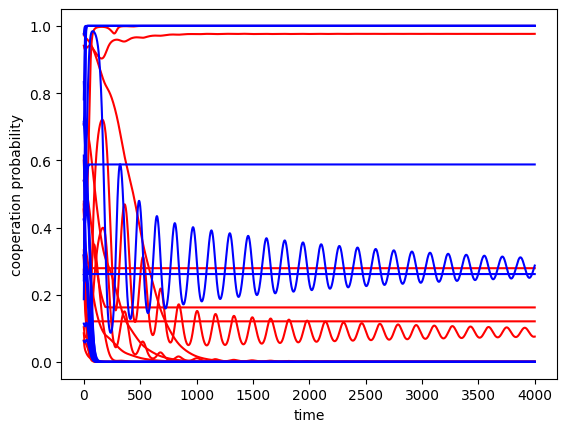

In [907]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [908]:
mae_9.obsdist(x)

Array([[0.06512249, 0.09164713, 0.02444787, 0.03321904, 0.02763967,
        0.07099486, 0.06612808, 0.09853453, 0.03023671, 0.02901709,
        0.10137309, 0.08527859, 0.09143763, 0.0716381 , 0.05395648,
        0.05932866],
       [0.03256122, 0.12420837, 0.01222393, 0.04544296, 0.01381984,
        0.0848147 , 0.03306401, 0.13159858, 0.01511836, 0.04413546,
        0.05068656, 0.13596512, 0.04571882, 0.1173569 , 0.02697822,
        0.08630694]], dtype=float32)

Text(0, 0.5, 'average reward')

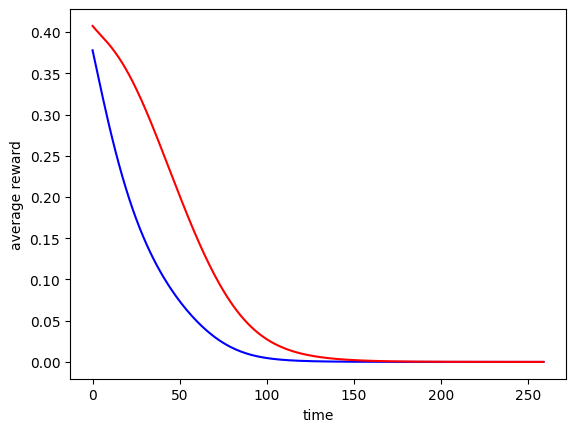

In [909]:
Rti = np.array([mae_9.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

In [910]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(987, 2, 16, 2)

In [911]:
finalRni = np.array([mae_9.Ri(Xisa) for Xisa in finalXnisa])

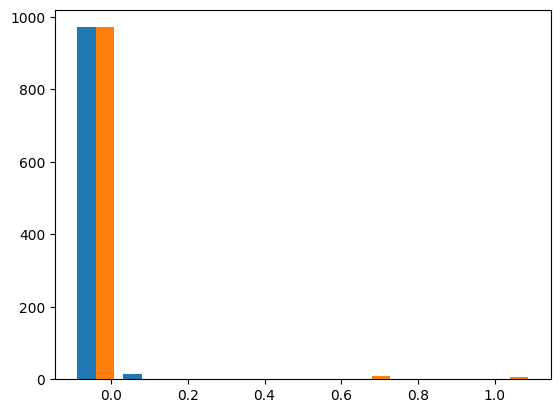

In [912]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [913]:
np.mean(finalRni[:,0] > 0.9) * 100

0.0

In [914]:
np.mean(finalRni[:,1] > 0.9) * 100

0.5065856129685917

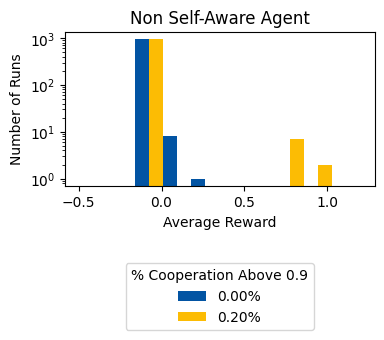

In [648]:
plt.figure(figsize=(4, 2)) 
plt.hist([(finalRni[:,0]), (finalRni[:,1])], color=['#0254a3', '#fcbc04'], label=['0.00%','0.20%'], range=(-.5, 1.2), rwidth=35, log=True)
plt.title('Non Self-Aware Agent')
plt.legend(loc='center', bbox_to_anchor=(.5, -0.72), title="% Cooperation Above 0.9")
plt.savefig('filename.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI
plt.xlabel('Average Reward');
plt.ylabel('Number of Runs');

In [471]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000_het_case9.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

Shape of the data for Agent 0: (281, 2, 16, 2)
Shape of the data for Agent 1: (268, 2, 16, 2)


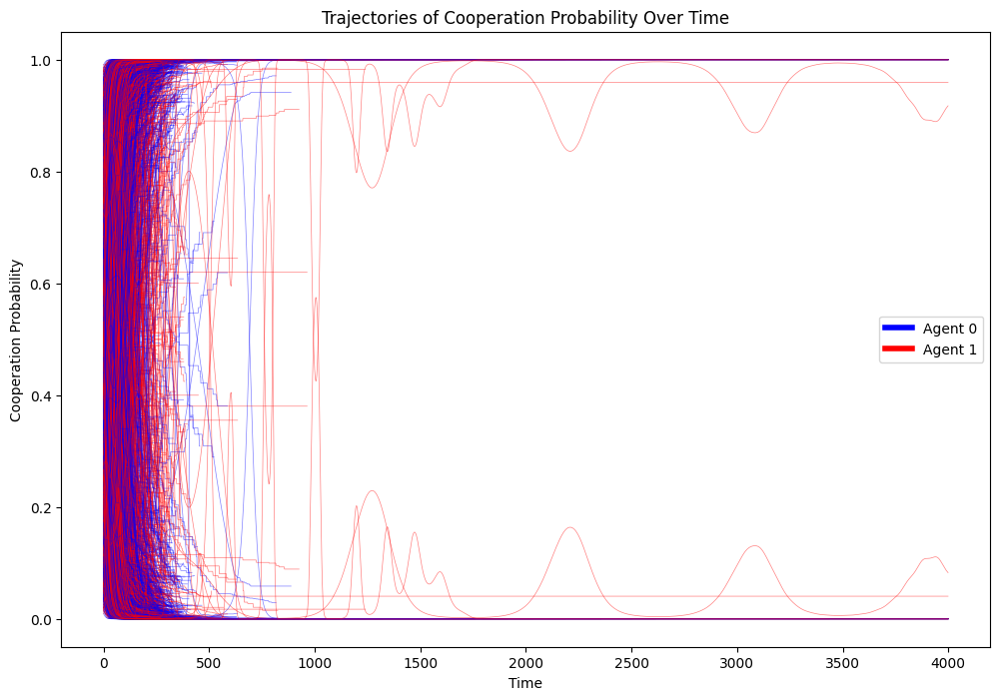

In [472]:
# Setup the plot
plt.figure(figsize=(12, 8))

# Define colors for clarity and reusability
colors = {'Agent 0': 'blue', 'Agent 1': 'red'}

# Check the shape of the data and print it
print("Shape of the data for Agent 0:", strategy_time_series[0].shape)
print("Shape of the data for Agent 1:", strategy_time_series[1].shape)

# Assume the data shape is (number of steps, number of variables, number of agents)
# We need to select which variable to plot, e.g., the first variable
variable_index = 0

# Loop through each simulation
for series in strategy_time_series:
    # Plot each trajectory for agent 0
    plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)
    # Plot each trajectory for agent 1
    plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)

# Adding plot labels and title
plt.xlabel('Time')
plt.ylabel('Cooperation Probability')
plt.title('Trajectories of Cooperation Probability Over Time')

# Create custom handles for the legend
custom_lines = [Line2D([0], [0], color=colors['Agent 0'], lw=4),
                Line2D([0], [0], color=colors['Agent 1'], lw=4)]

# Set the legend with custom handles
plt.legend(custom_lines, ['Agent 0', 'Agent 1'])

# Show the plot
plt.show()


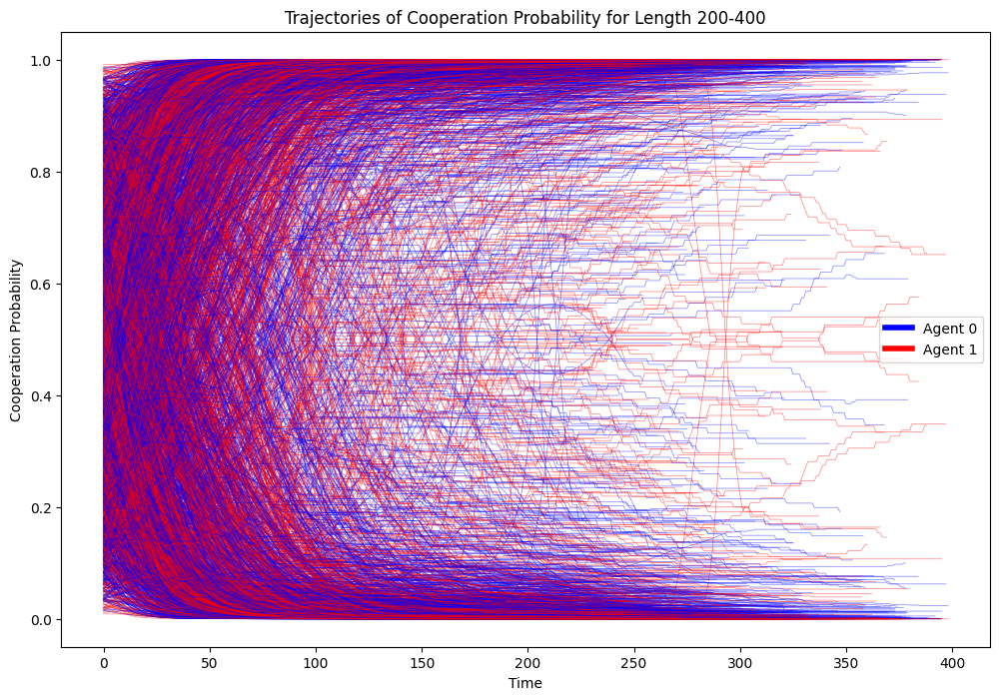

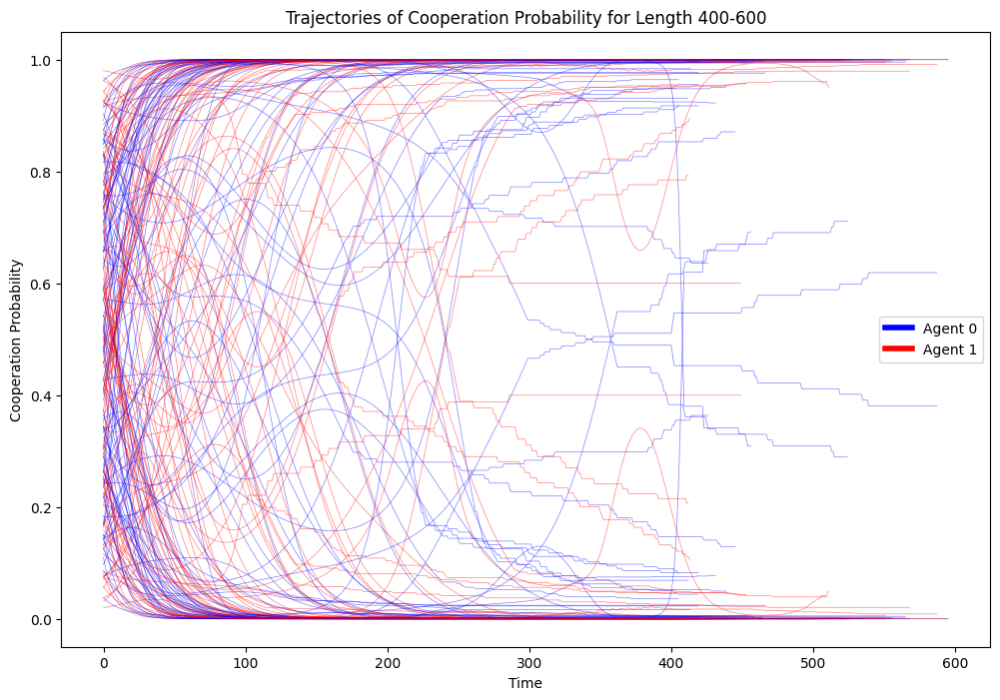

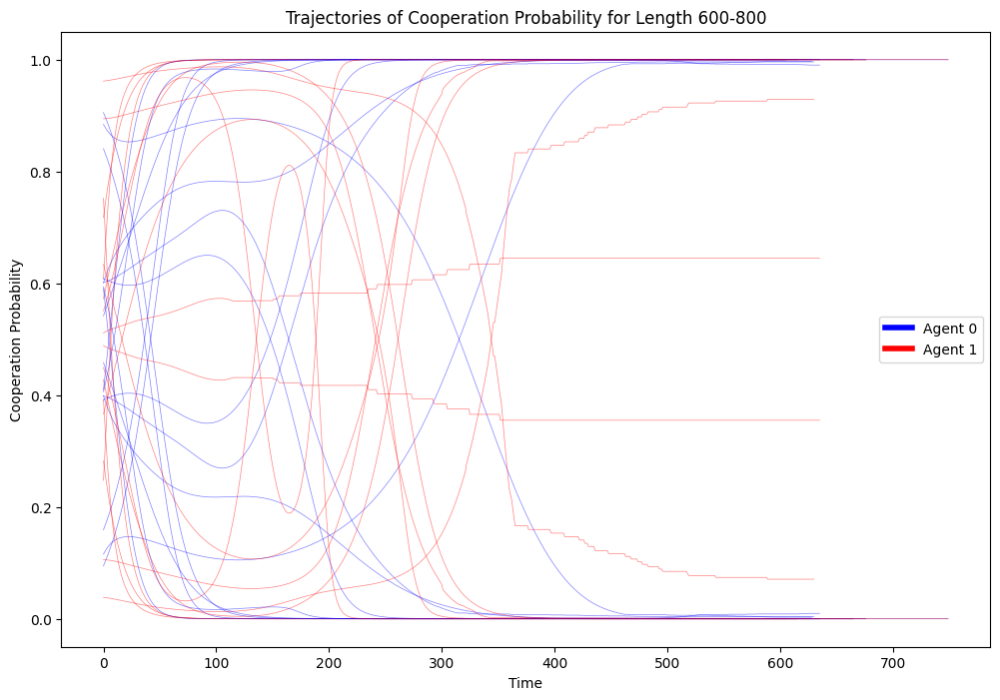

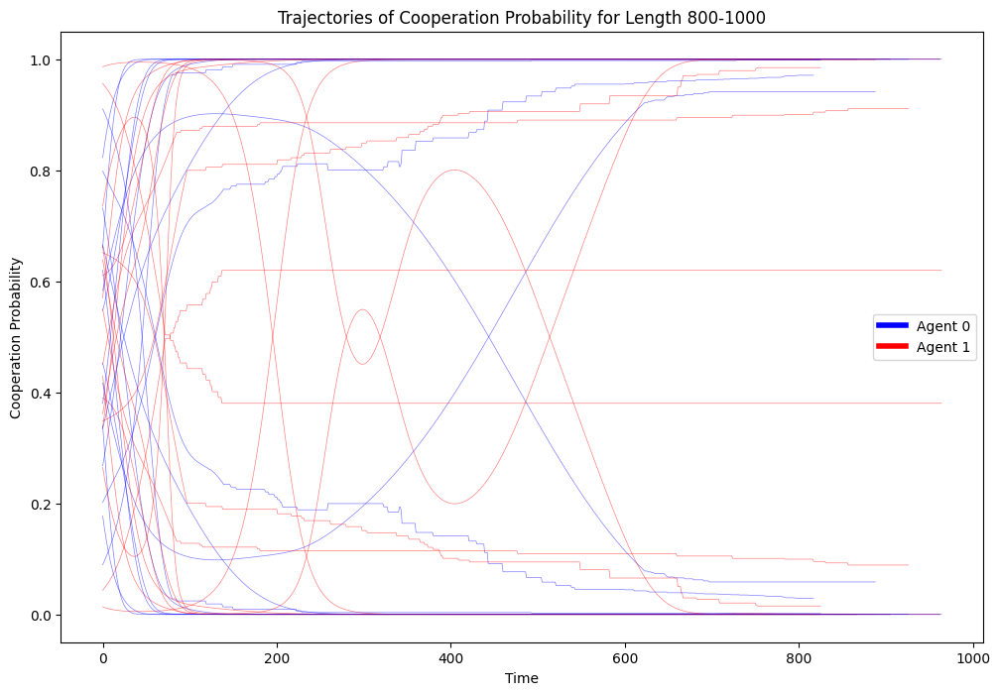

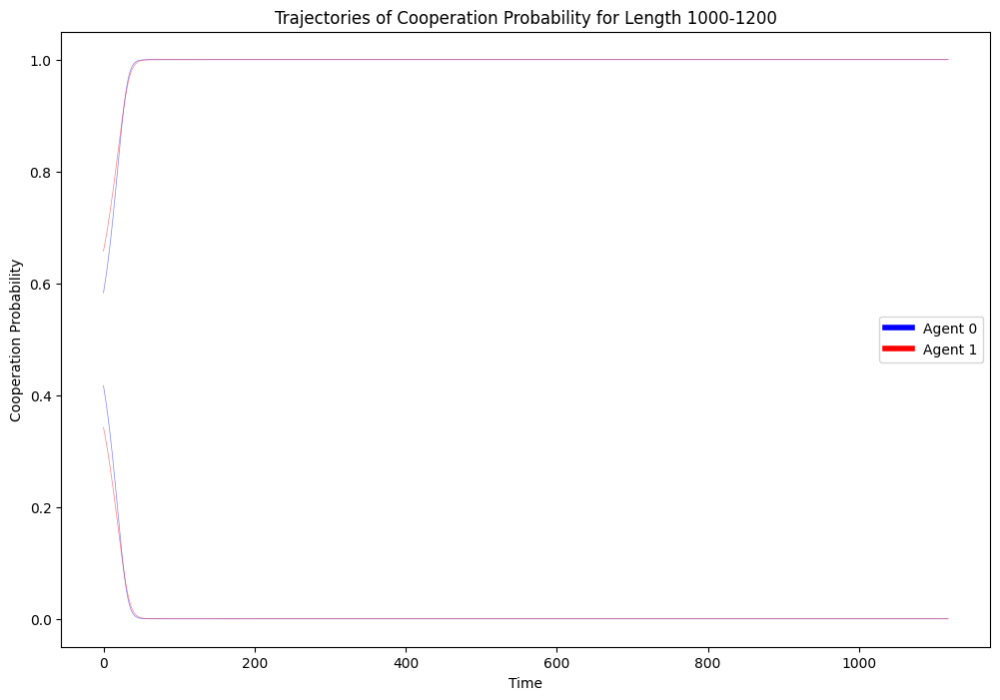

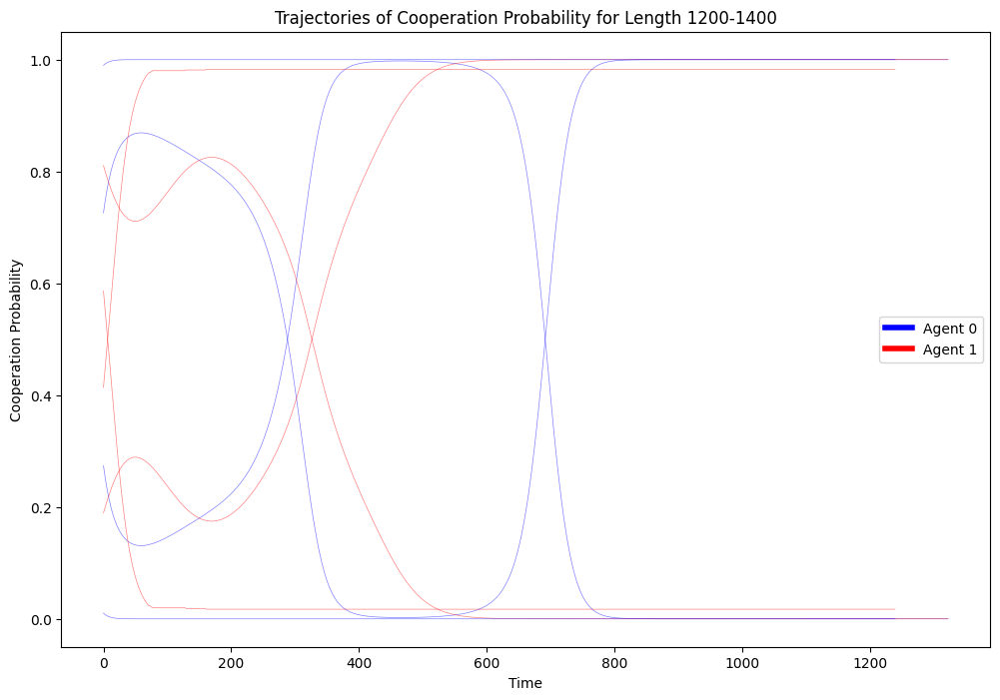

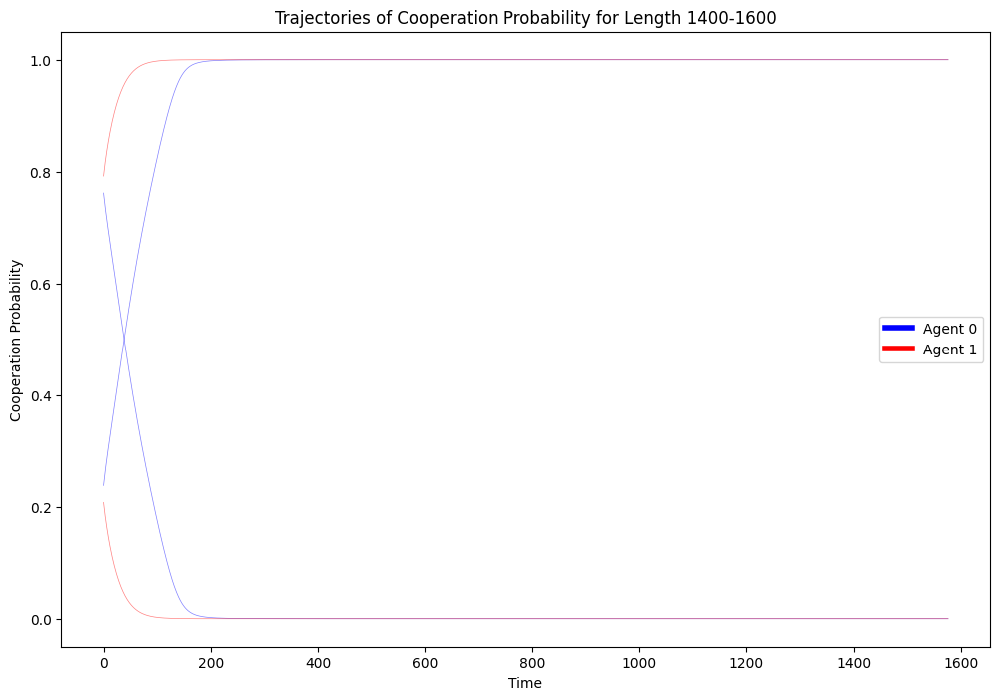

In [473]:
bins = [200, 400, 600, 800, 1000, 1200, 1400, 1600]
bin_labels = ['200-400', '400-600', '600-800', '800-1000', '1000-1200', '1200-1400', '1400-1600']

# Initialize a dictionary to hold categorized trajectories
categorized_trajectories = {label: [] for label in bin_labels}

# Categorize each trajectory based on its length
for series in strategy_time_series:
    length = len(series)
    for i, bin_edge in enumerate(bins):
        if length < bin_edge:
            category_label = bin_labels[i-1 if i != 0 else 0]
            categorized_trajectories[category_label].append(series)
            break

# Now, we have the trajectories categorized by length intervals
# Let's plot the trajectories for each interval
for category, trajectories in categorized_trajectories.items():
    if trajectories:  # Check if there are trajectories in this category
        plt.figure(figsize=(12, 8))
        plt.title(f'Trajectories of Cooperation Probability for Length {category}')
        plt.xlabel('Time')
        plt.ylabel('Cooperation Probability')
        
        for series in trajectories:
            plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)  # for Agent 0
            plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)  # for Agent 1
        
        plt.legend(custom_lines, ['Agent 0', 'Agent 1'])
        plt.show()


### Re-run Case4: Agent0 is fully observable and agent1 partially blind about agent0 (in second iteration)

In [126]:
memo_ipd_4_rerun = HistoryEmbedded(env, h=(2,2,2))

In [127]:
memo_ipd_4_rerun.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [128]:
memo_ipd_4_rerun.Oset[1] =    ['c,c,.|.,c,.|',
                         'c,c,.|.,d,.|',
                         'c,c,.|.,c,.|',
                         'c,c,.|.,d,.|',
                         'c,d,.|.,c,.|',
                         'c,d,.|.,d,.|',
                         'c,d,.|.,c,.|',
                         'c,d,.|.,d,.|',
                         'd,c,.|.,c,.|',
                         'd,c,.|.,d,.|',
                         'd,c,.|.,c,.|',
                         'd,c,.|.,d,.|',
                         'd,d,.|.,c,.|',
                         'd,d,.|.,d,.|',
                         'd,d,.|.,c,.|',
                         'd,d,.|.,d,.|']

In [129]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_4_rerun.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_4_rerun.Oset[0])
memo_ipd_4_rerun.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_4_rerun.Oset[1])

In [130]:
# Checking the observation set
memo_ipd_4_rerun.O

array([[[1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0

In [131]:
# Modify state set, so it represents the current game
state_set_4_rerun = []
for i in range(len(memo_ipd_4_rerun.Oset[0])):
    sub_set_4_rerun = f"a0 = {memo_ipd_4_rerun.Oset[0][i]} a1 = {memo_ipd_4_rerun.Oset[1][i]}"
    state_set_4_rerun.append(sub_set_4_rerun)
state_set_4_rerun

['a0 = c,c,.|c,c,.| a1 = c,c,.|.,c,.|',
 'a0 = c,c,.|c,d,.| a1 = c,c,.|.,d,.|',
 'a0 = c,c,.|d,c,.| a1 = c,c,.|.,c,.|',
 'a0 = c,c,.|d,d,.| a1 = c,c,.|.,d,.|',
 'a0 = c,d,.|c,c,.| a1 = c,d,.|.,c,.|',
 'a0 = c,d,.|c,d,.| a1 = c,d,.|.,d,.|',
 'a0 = c,d,.|d,c,.| a1 = c,d,.|.,c,.|',
 'a0 = c,d,.|d,d,.| a1 = c,d,.|.,d,.|',
 'a0 = d,c,.|c,c,.| a1 = d,c,.|.,c,.|',
 'a0 = d,c,.|c,d,.| a1 = d,c,.|.,d,.|',
 'a0 = d,c,.|d,c,.| a1 = d,c,.|.,c,.|',
 'a0 = d,c,.|d,d,.| a1 = d,c,.|.,d,.|',
 'a0 = d,d,.|c,c,.| a1 = d,d,.|.,c,.|',
 'a0 = d,d,.|c,d,.| a1 = d,d,.|.,d,.|',
 'a0 = d,d,.|d,c,.| a1 = d,d,.|.,c,.|',
 'a0 = d,d,.|d,d,.| a1 = d,d,.|.,d,.|']

In [132]:
# Generate agents
mae_4_rerun = POstratAC(env=memo_ipd_4_rerun, learning_rates=0.1, discount_factors=0.9)

In [133]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_4_rerun.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_4_rerun.trajectory(x, Tmax=10000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case4_rerun.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case4_rerun.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [134]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [135]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 998


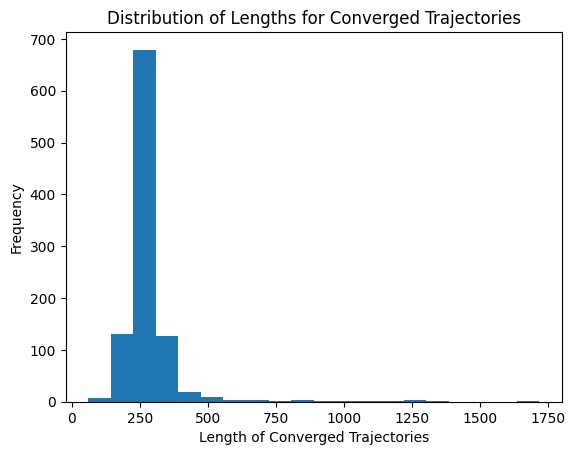

In [136]:
# Filter out the simulations that converged and extract the final strategy of each
# finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
# finalXnisa = np.array(finalXnisa, dtype=object)

# Analyze the distribution of final strategies' lengths if necessary
plt.hist(length_n, bins=20)
plt.title('Distribution of Lengths for Converged Trajectories')
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.show()

In [137]:
non_converged_runs = np.where(np.logical_not(Cn))
non_converged_runs

(array([517, 568]),)

In [138]:
Xntisa[952].shape

(360, 2, 16, 2)

In [139]:
finalXnisa = []
length_n = []
for n in non_converged_runs[0]:
    if not Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
length_n

[10000, 10000]

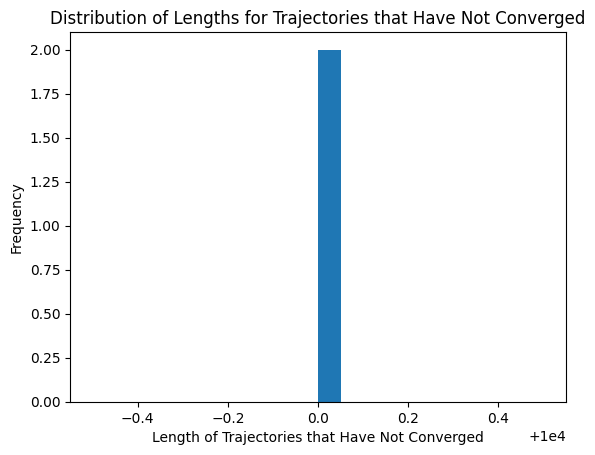

In [140]:
plt.hist(length_n, bins=20);# Analyze the distribution of final strategies' lengths if necessary
plt.title('Distribution of Lengths for Trajectories that Have Not Converged')
plt.xlabel('Length of Trajectories that Have Not Converged')
plt.ylabel('Frequency')
plt.show()

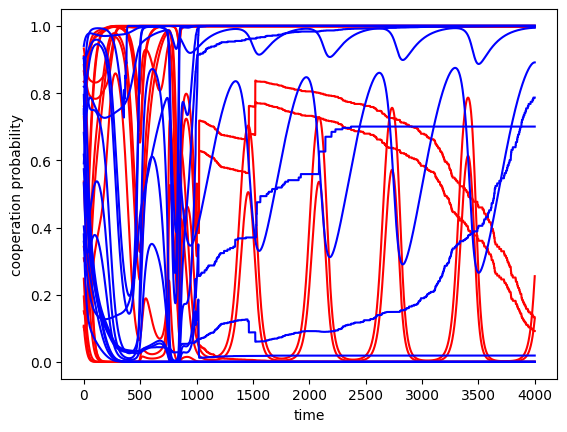

In [326]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [328]:
mae_4_rerun.obsdist(x)

Array([[0.03525267, 0.02310999, 0.10087932, 0.08053952, 0.04866469,
        0.04088876, 0.04600128, 0.04426485, 0.09648775, 0.06188704,
        0.05292527, 0.07839245, 0.05937644, 0.05393383, 0.08988654,
        0.08750965],
       [0.06806599, 0.05182479, 0.06806602, 0.05182477, 0.047333  ,
        0.0425768 , 0.04733301, 0.0425768 , 0.07470649, 0.07013974,
        0.07470649, 0.07013974, 0.07463151, 0.0707217 , 0.07463151,
        0.0707217 ]], dtype=float32)

Text(0, 0.5, 'average reward')

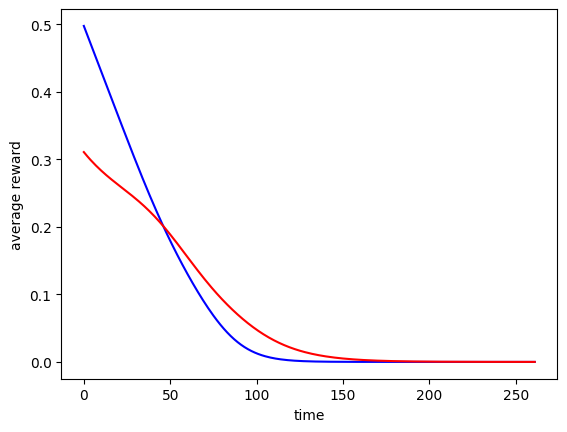

In [329]:
Rti = np.array([mae_4_rerun.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

In [330]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(999, 2, 16, 2)

In [331]:
finalRni = np.array([mae_4_rerun.Ri(Xisa) for Xisa in finalXnisa])

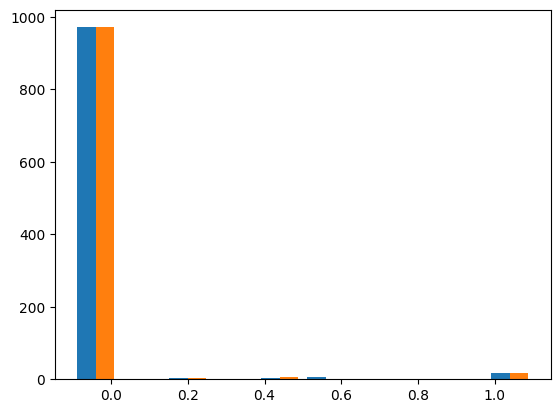

In [332]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [333]:
np.mean(finalRni[:,0] > 0.9) * 100

1.6016016016016015

In [334]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000_het_case4_rerun.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

Shape of the data for Agent 0: (190, 2, 16, 2)
Shape of the data for Agent 1: (311, 2, 16, 2)


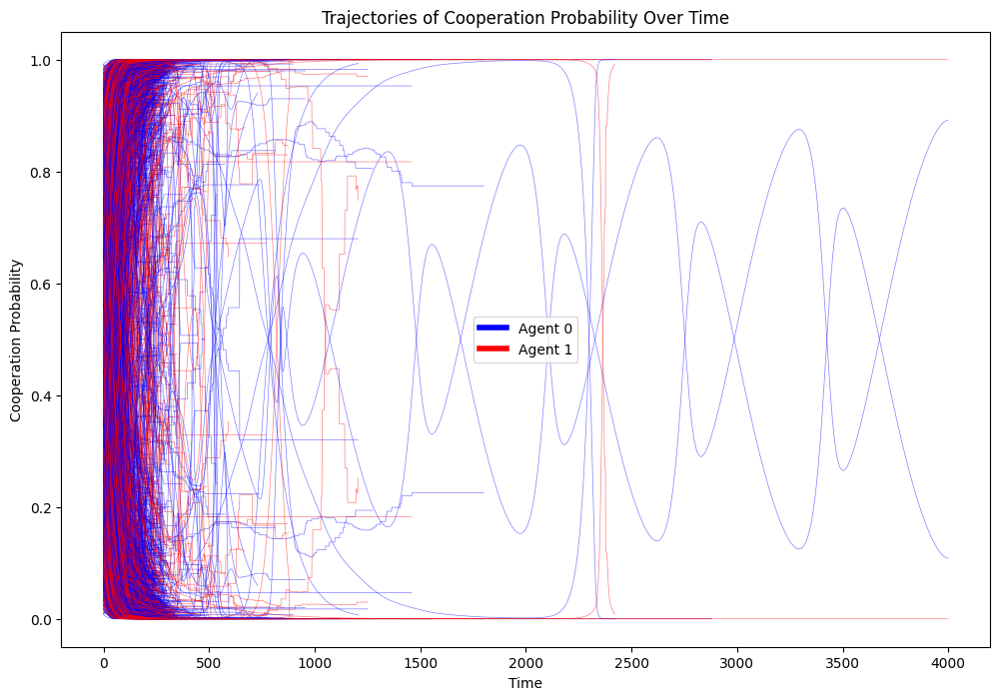

In [335]:
# Setup the plot
plt.figure(figsize=(12, 8))

# Define colors for clarity and reusability
colors = {'Agent 0': 'blue', 'Agent 1': 'red'}

# Check the shape of the data and print it
print("Shape of the data for Agent 0:", strategy_time_series[0].shape)
print("Shape of the data for Agent 1:", strategy_time_series[1].shape)

# Assume the data shape is (number of steps, number of variables, number of agents)
# We need to select which variable to plot, e.g., the first variable
variable_index = 0

# Loop through each simulation
for series in strategy_time_series:
    # Plot each trajectory for agent 0
    plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)
    # Plot each trajectory for agent 1
    plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)

# Adding plot labels and title
plt.xlabel('Time')
plt.ylabel('Cooperation Probability')
plt.title('Trajectories of Cooperation Probability Over Time')

# Create custom handles for the legend
custom_lines = [Line2D([0], [0], color=colors['Agent 0'], lw=4),
                Line2D([0], [0], color=colors['Agent 1'], lw=4)]

# Set the legend with custom handles
plt.legend(custom_lines, ['Agent 0', 'Agent 1'])

# Show the plot
plt.show()


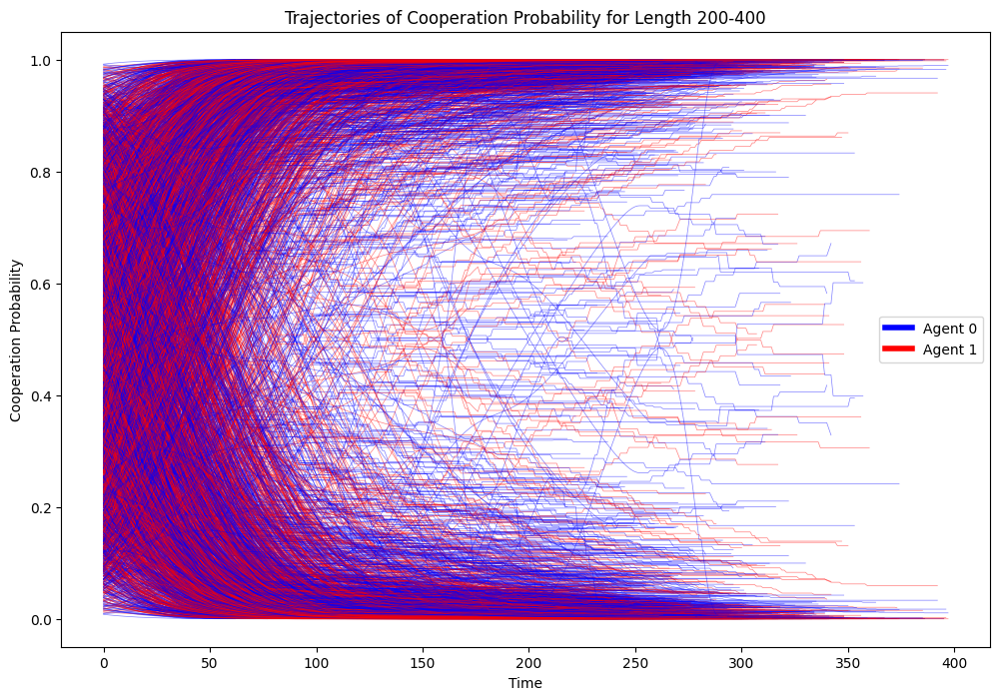

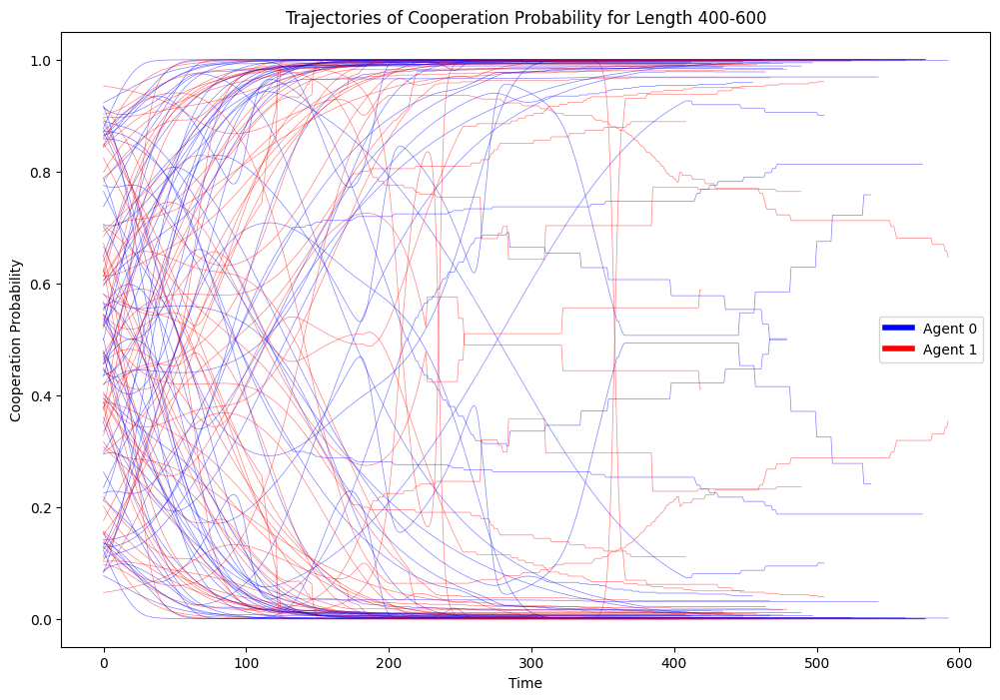

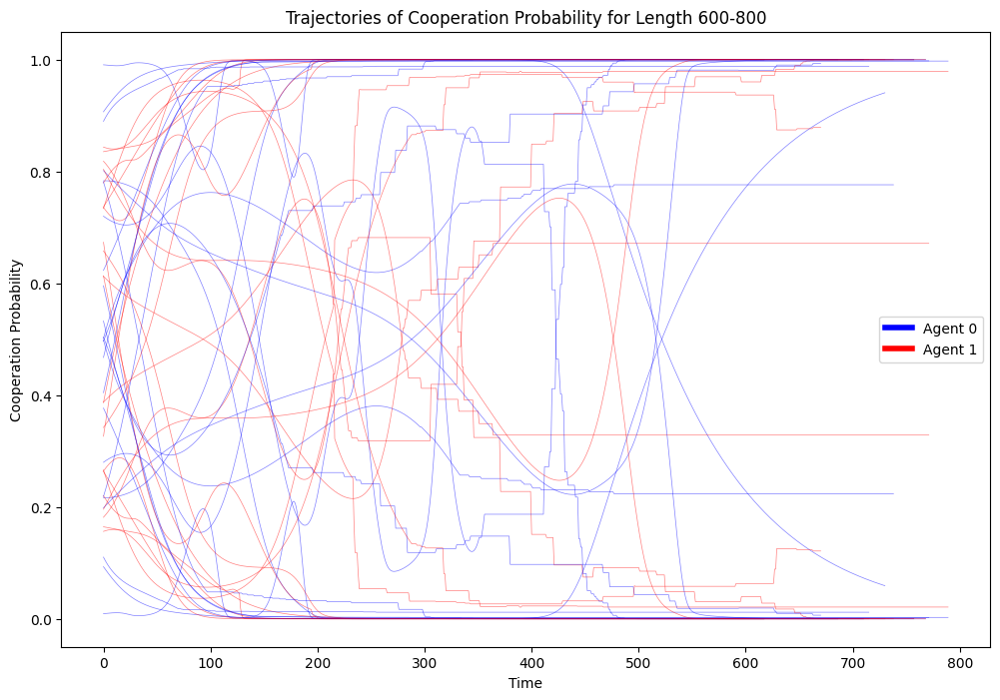

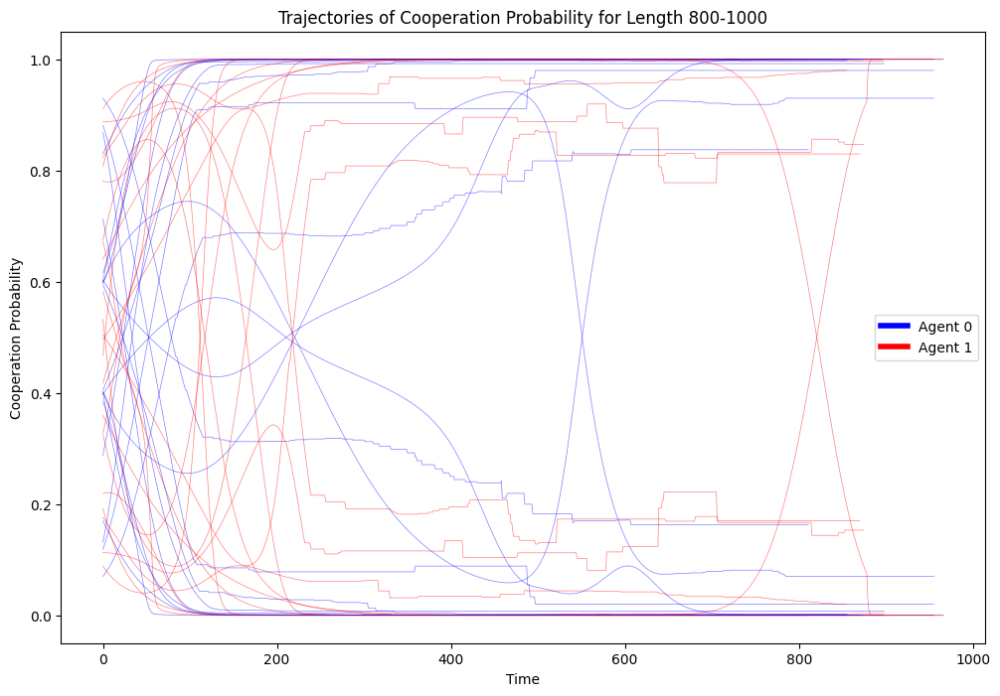

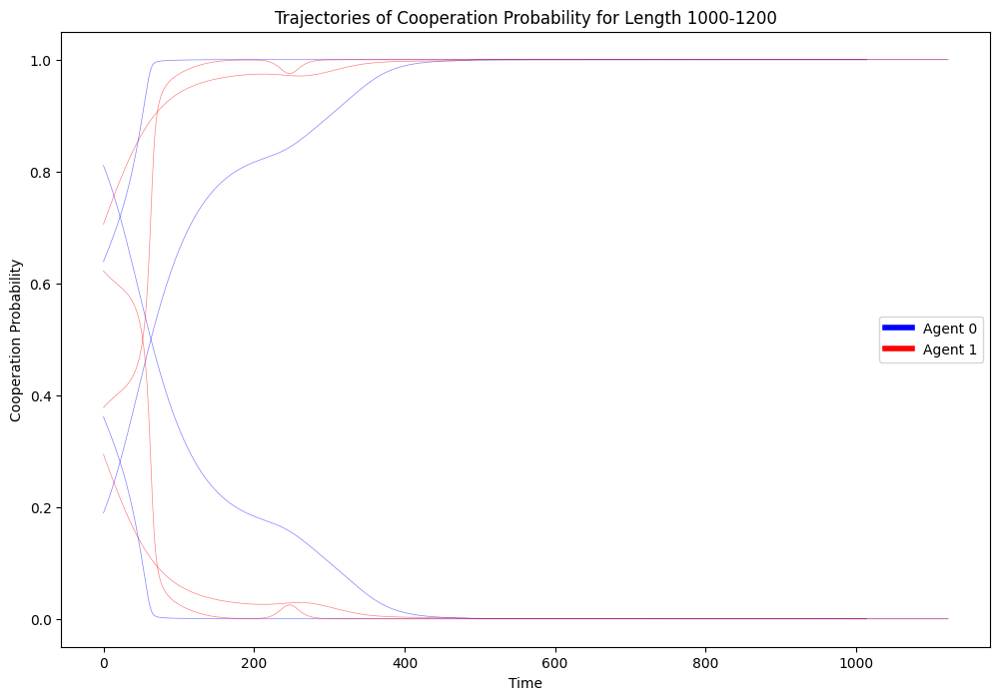

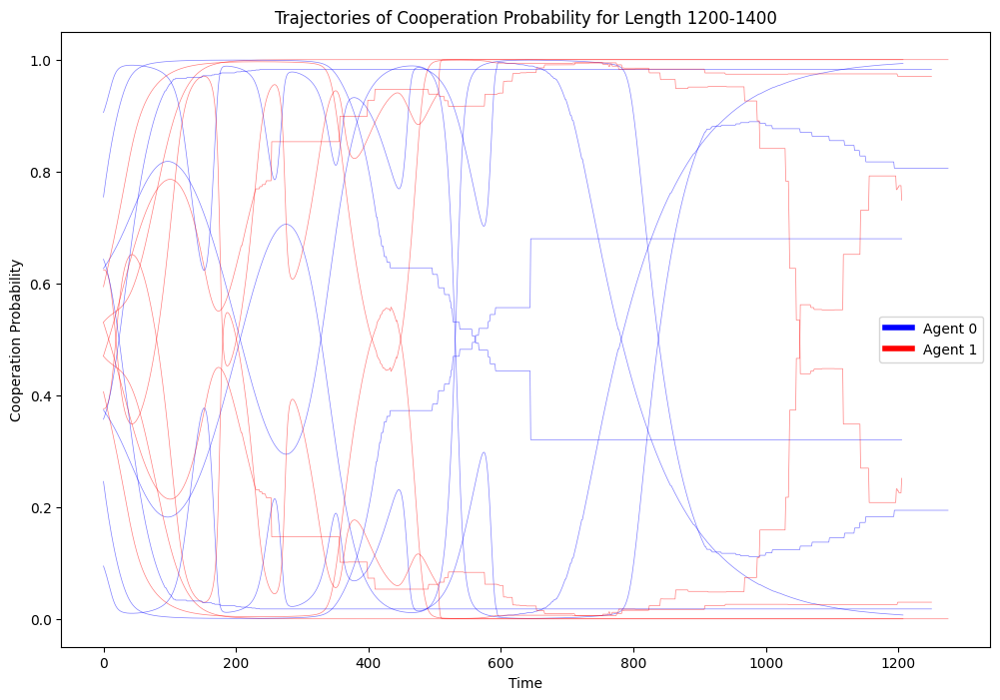

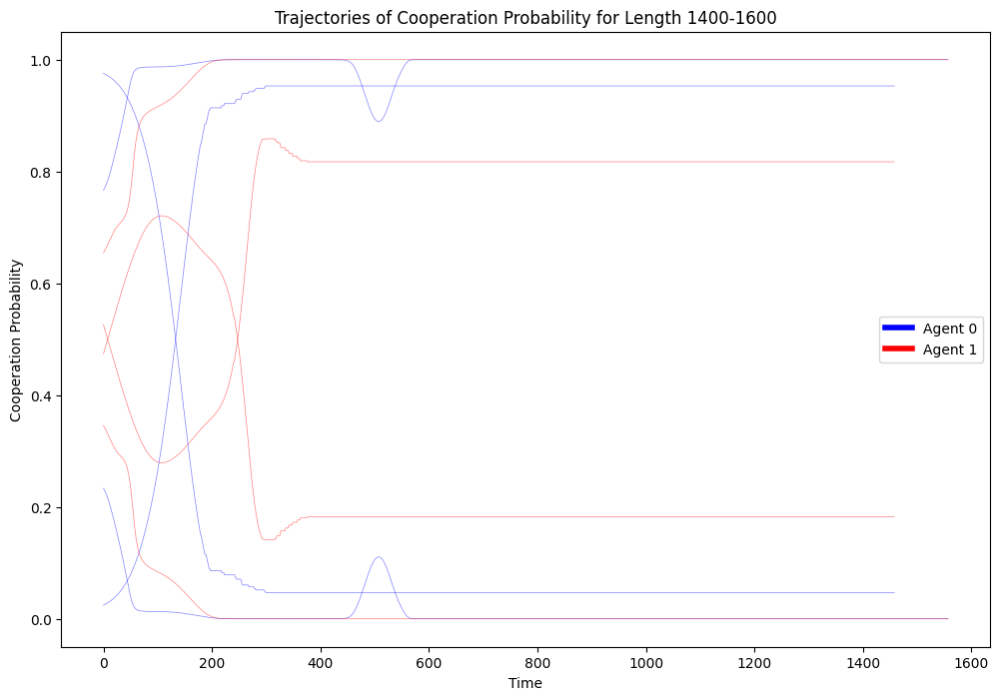

In [336]:
bins = [200, 400, 600, 800, 1000, 1200, 1400, 1600]
bin_labels = ['200-400', '400-600', '600-800', '800-1000', '1000-1200', '1200-1400', '1400-1600']

# Initialize a dictionary to hold categorized trajectories
categorized_trajectories = {label: [] for label in bin_labels}

# Categorize each trajectory based on its length
for series in strategy_time_series:
    length = len(series)
    for i, bin_edge in enumerate(bins):
        if length < bin_edge:
            category_label = bin_labels[i-1 if i != 0 else 0]
            categorized_trajectories[category_label].append(series)
            break

# Now, we have the trajectories categorized by length intervals
# Let's plot the trajectories for each interval
for category, trajectories in categorized_trajectories.items():
    if trajectories:  # Check if there are trajectories in this category
        plt.figure(figsize=(12, 8))
        plt.title(f'Trajectories of Cooperation Probability for Length {category}')
        plt.xlabel('Time')
        plt.ylabel('Cooperation Probability')
        
        for series in trajectories:
            plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)  # for Agent 0
            plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)  # for Agent 1
        
        plt.legend(custom_lines, ['Agent 0', 'Agent 1'])
        plt.show()


### Rerun case6: Agent0 is fully observable and agent1 partially blind about agent0 but remembers all agent0's cooperation

In [34]:
memo_ipd_6_rerun = HistoryEmbedded(env, h=(2,2,2))

In [35]:
memo_ipd_6_rerun.Oset

[['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|'],
 ['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|']]

In [36]:
memo_ipd_6_rerun.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [37]:
memo_ipd_6_rerun.Oset[1] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|.,c,.|',
                         'c,c,.|.,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|.,c,.|',
                         'c,d,.|.,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|.,c,.|',
                         'd,c,.|.,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|.,c,.|',
                         'd,d,.|.,d,.|']

In [38]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_6_rerun.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_6_rerun.Oset[0])
memo_ipd_6_rerun.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_6_rerun.Oset[1])

In [39]:
# Checking the observation set
len(memo_ipd_6_rerun.Sset)

16

In [40]:
memo_ipd_6_rerun.O

array([[[1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0

In [41]:
# Modify state set, so it represents the current game
state_set_6_rerun = []
for i in range(len(memo_ipd_6_rerun.Oset[0])):
    sub_set_6_rerun = f"a0 = {memo_ipd_6_rerun.Oset[0][i]} a1 = {memo_ipd_6_rerun.Oset[1][i]}"
    state_set_6_rerun.append(sub_set_6_rerun)
state_set_6_rerun

['a0 = c,c,.|c,c,.| a1 = c,c,.|c,c,.|',
 'a0 = c,c,.|c,d,.| a1 = c,c,.|c,d,.|',
 'a0 = c,c,.|d,c,.| a1 = c,c,.|.,c,.|',
 'a0 = c,c,.|d,d,.| a1 = c,c,.|.,d,.|',
 'a0 = c,d,.|c,c,.| a1 = c,d,.|c,c,.|',
 'a0 = c,d,.|c,d,.| a1 = c,d,.|c,d,.|',
 'a0 = c,d,.|d,c,.| a1 = c,d,.|.,c,.|',
 'a0 = c,d,.|d,d,.| a1 = c,d,.|.,d,.|',
 'a0 = d,c,.|c,c,.| a1 = d,c,.|c,c,.|',
 'a0 = d,c,.|c,d,.| a1 = d,c,.|c,d,.|',
 'a0 = d,c,.|d,c,.| a1 = d,c,.|.,c,.|',
 'a0 = d,c,.|d,d,.| a1 = d,c,.|.,d,.|',
 'a0 = d,d,.|c,c,.| a1 = d,d,.|c,c,.|',
 'a0 = d,d,.|c,d,.| a1 = d,d,.|c,d,.|',
 'a0 = d,d,.|d,c,.| a1 = d,d,.|.,c,.|',
 'a0 = d,d,.|d,d,.| a1 = d,d,.|.,d,.|']

In [43]:
# Generate agents
mae_6_rerun = POstratAC(env=memo_ipd_6_rerun, learning_rates=0.1, discount_factors=0.9)

In [51]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_6_rerun.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_6_rerun.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case6_rerun.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case6_rerun.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [52]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [53]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 987


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming Xntisa is populated with data
# Example structure of Xntisa[n] for each n: a numpy array of shape (Tmax, number_of_agents)

# Determine the maximum number of timesteps (if they vary, otherwise use Tmax directly)
max_timesteps = max(len(sim) for sim in non_converged_runs_graph)

# Initialize an array to store cumulative strategy data
# Assuming two agents based on your scenario
cumulative_data = np.zeros((max_timesteps, 2))

# Count the number of simulations that reach each timestep (for averaging)
count_per_timestep = np.zeros(max_timesteps)

for Xtisa in Xntisa:
    # Sum the strategy probabilities at each timestep for each agent
    timesteps = len(Xtisa)
    cumulative_data[:timesteps] += Xtisa[:, :2]  # assuming two columns, one per agent
    count_per_timestep[:timesteps] += 1

# Compute the average by dividing cumulative data by the count at each timestep
average_data = cumulative_data / count_per_timestep[:, None]  # use None to keep dimensions for broadcasting

# Plotting the average trajectory data
plt.figure(figsize=(10, 5))
for agent in range(2):  # Two agents
    plt.plot(average_data[:, agent], label=f'Agent {agent}')

plt.title('Average Strategy Probabilities Over Time')
plt.xlabel('Time Step')
plt.ylabel('Average Strategy Probability')
plt.legend()
plt.grid(True)
plt.show()


In [89]:
import numpy as np

# Assuming non_converged_runs_graph is your list of numpy arrays
# Step 1: Concatenate arrays
all_data = np.concatenate(non_converged_runs_graph)

# Step 2: Flatten the array
flattened_data = all_data.flatten()

# Step 3: Compute the average
average_value = np.mean(flattened_data)

# Alternatively, compute the sum if needed
total_sum = np.sum(flattened_data)

# Output results
print("Average of all values:", average_value)
print("Sum of all values:", total_sum)


Average of all values: 0.5
Sum of all values: 416.0


(832,)

In [55]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([ 39, 118, 148, 349, 391, 453, 506, 553, 563, 570, 572, 914, 948])

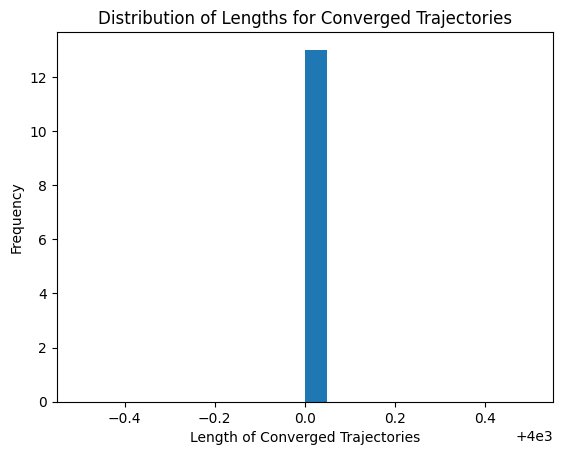

In [62]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in non_converged_runs if not Cn[n]]
length_n = [len(Xntisa[n]) for n in non_converged_runs if not Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Analyze the distribution of final strategies' lengths if necessary
plt.hist(length_n, bins=20)
plt.title('Distribution of Lengths for Converged Trajectories')
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.show()

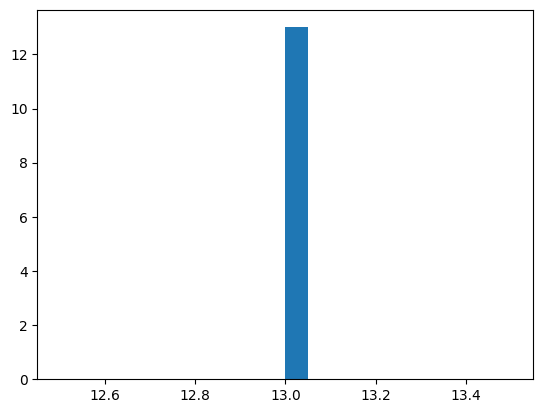

In [94]:
length_n = [len(non_converged_runs) for Xtisa in non_converged_runs]
plt.hist(length_n, bins=20);

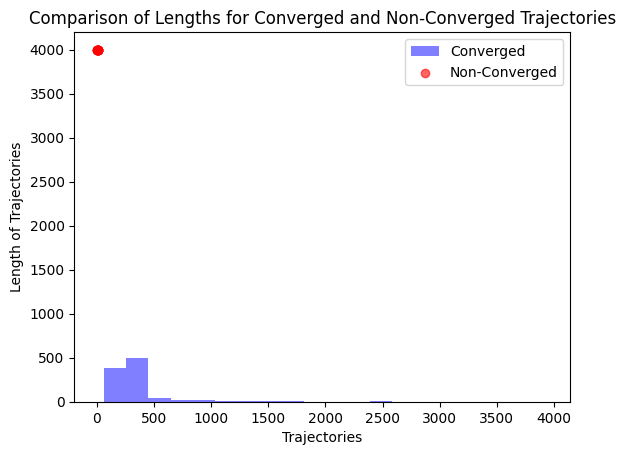

In [63]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming variables and data preparation steps are defined as above

# First, the histogram for converged trajectories
length_n_converged = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]
plt.hist(length_n_converged, bins=20, alpha=0.5, label='Converged', color='blue')

# Then, gather data for non-converged trajectories
length_n_non_converged = [len(Xntisa[n]) for n in range(num_simulations) if not Cn[n]]

# Using a scatter plot for non-converged trajectories
# Generate x values as the index of each non-converged run, just for visualization
x_values = range(len(length_n_non_converged))
plt.scatter(x_values, length_n_non_converged, color='red', label='Non-Converged', alpha=0.6)

# Set labels and title
plt.title('Comparison of Lengths for Converged and Non-Converged Trajectories')
plt.xlabel('Trajectories')
plt.ylabel('Length of Trajectories')
plt.legend()  # Show a legend to differentiate between converged and non-converged

plt.show()


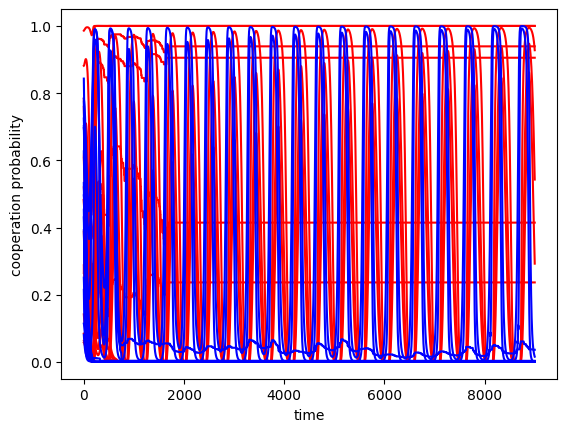

In [20]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [21]:
mae_6_rerun.obsdist(x)

Array([[0.04582914, 0.10604659, 0.04049584, 0.09431148, 0.09992868,
        0.02591185, 0.06276352, 0.04789105, 0.07238043, 0.06245916,
        0.04756298, 0.04106517, 0.06854469, 0.04207756, 0.07264546,
        0.07008648],
       [0.06607704, 0.1532022 , 0.02024791, 0.04715569, 0.13131046,
        0.04985739, 0.03138177, 0.02394554, 0.09616196, 0.08299182,
        0.02378149, 0.02053259, 0.10486745, 0.07712081, 0.03632272,
        0.03504324]], dtype=float32)

Text(0, 0.5, 'average reward')

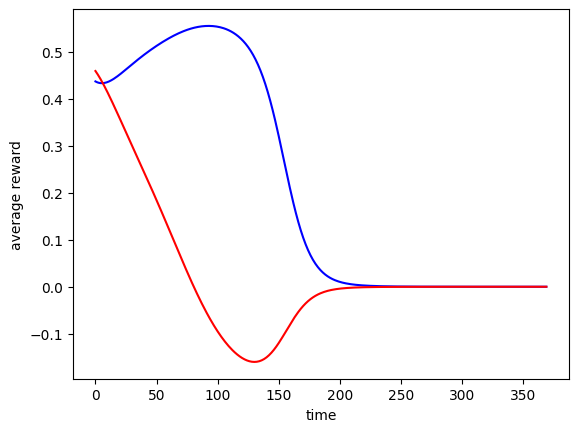

In [22]:
Rti = np.array([mae_6_rerun.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

In [23]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(988, 2, 16, 2)

In [24]:
finalRni = np.array([mae_6_rerun.Ri(Xisa) for Xisa in finalXnisa])

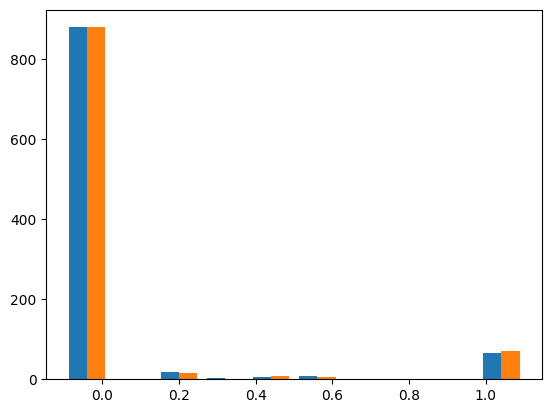

In [25]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [26]:
np.mean(finalRni[:,0] > 0.9) * 100

6.983805668016195

In [27]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('wolf_strategy_time_series_1000_het_case6_rerun.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

Shape of the data for Agent 0: (295, 2, 16, 2)
Shape of the data for Agent 1: (263, 2, 16, 2)


/Users/mariana/.pyenv/versions/3.10.3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


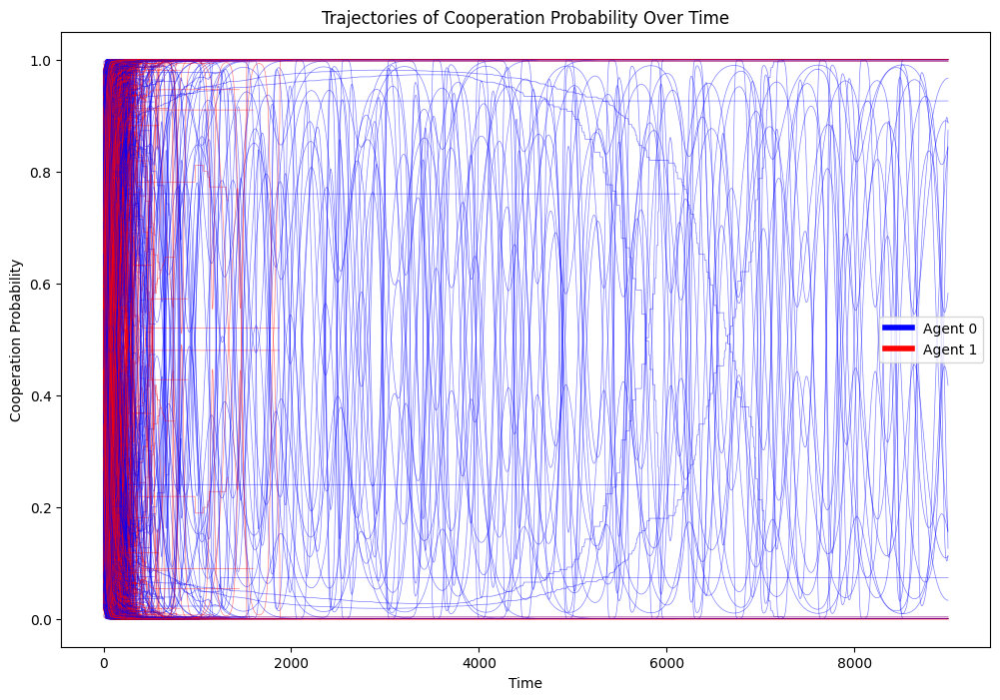

In [28]:
# Setup the plot
plt.figure(figsize=(12, 8))

# Define colors for clarity and reusability
colors = {'Agent 0': 'blue', 'Agent 1': 'red'}

# Check the shape of the data and print it
print("Shape of the data for Agent 0:", strategy_time_series[0].shape)
print("Shape of the data for Agent 1:", strategy_time_series[1].shape)

# Assume the data shape is (number of steps, number of variables, number of agents)
# We need to select which variable to plot, e.g., the first variable
variable_index = 0

# Loop through each simulation
for series in strategy_time_series:
    # Plot each trajectory for agent 0
    plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)
    # Plot each trajectory for agent 1
    plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)

# Adding plot labels and title
plt.xlabel('Time')
plt.ylabel('Cooperation Probability')
plt.title('Trajectories of Cooperation Probability Over Time')

# Create custom handles for the legend
custom_lines = [Line2D([0], [0], color=colors['Agent 0'], lw=4),
                Line2D([0], [0], color=colors['Agent 1'], lw=4)]

# Set the legend with custom handles
plt.legend(custom_lines, ['Agent 0', 'Agent 1'])

# Show the plot
plt.show()


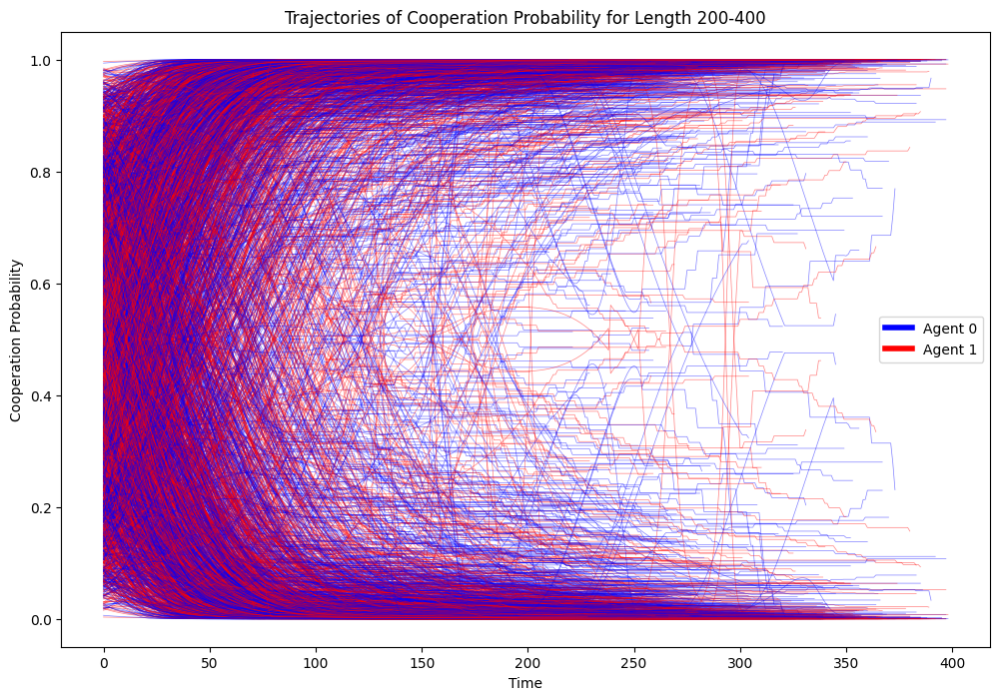

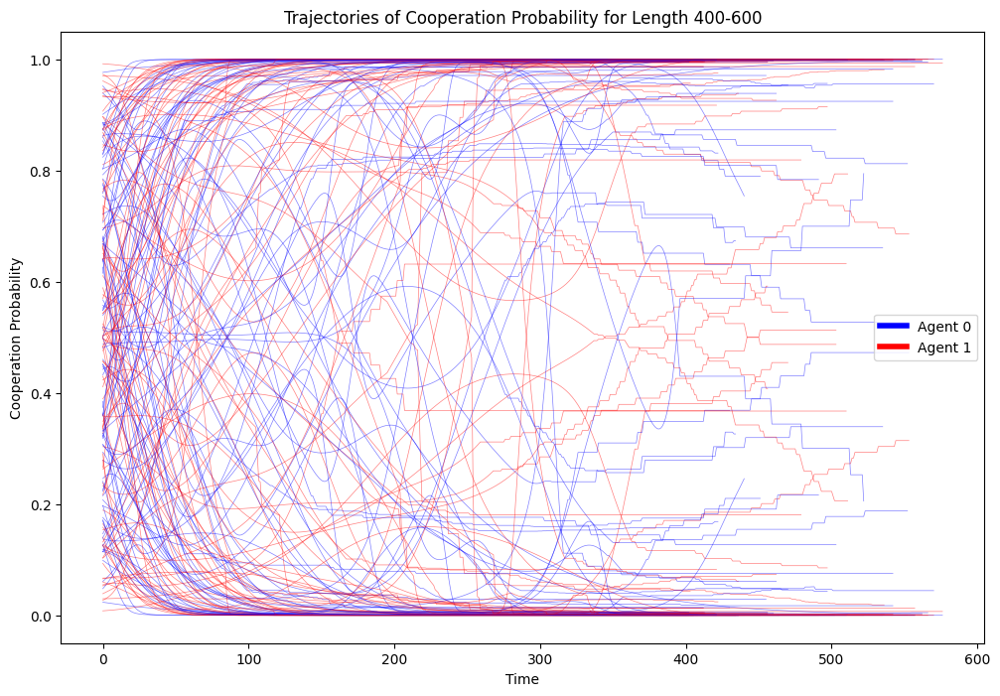

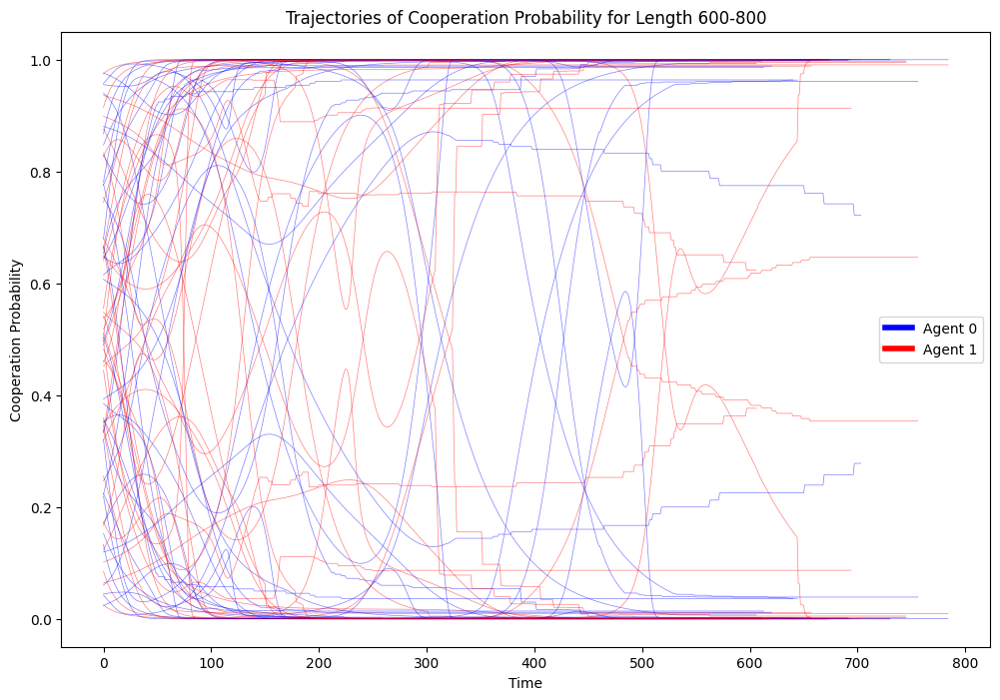

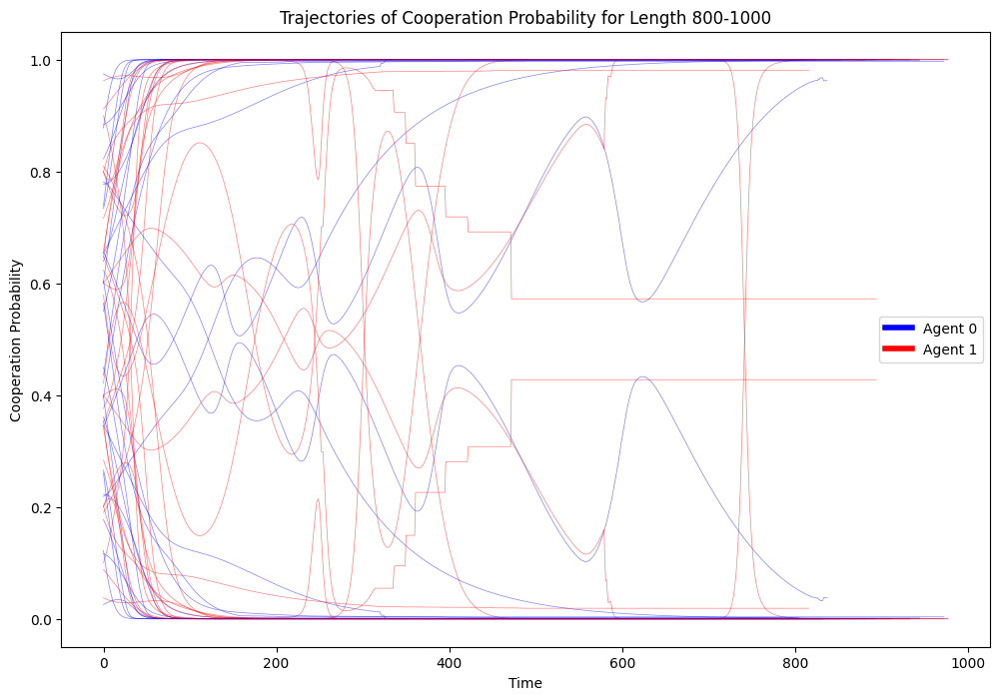

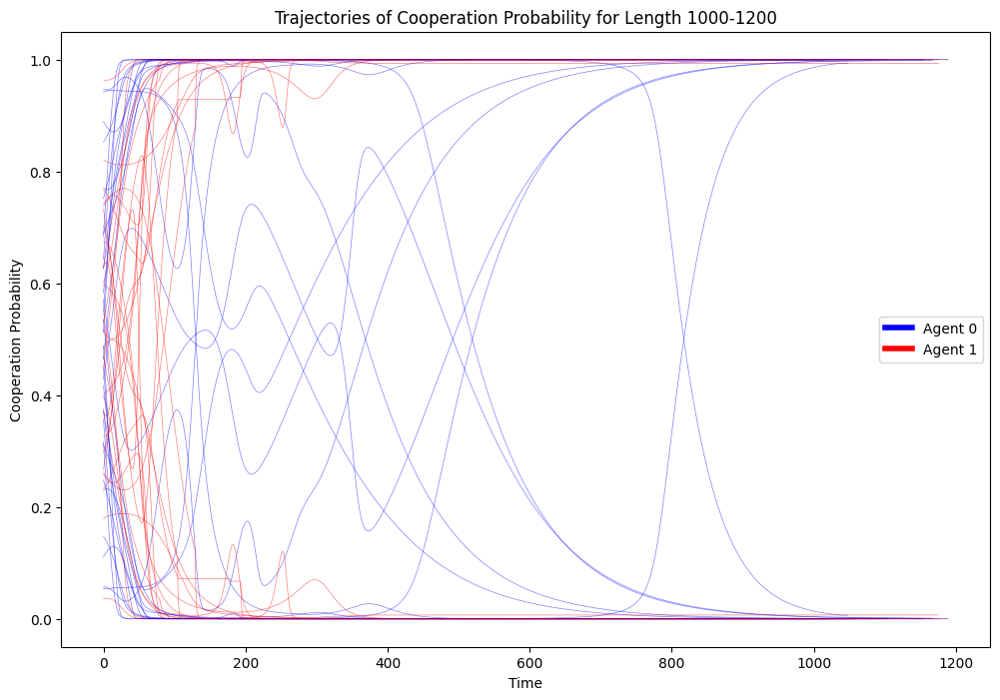

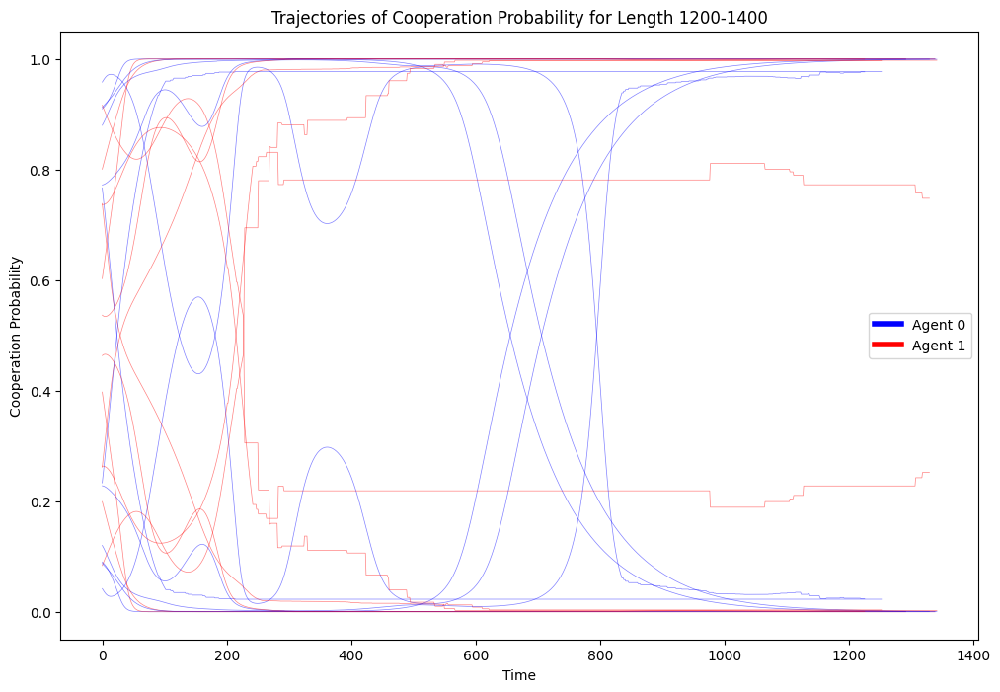

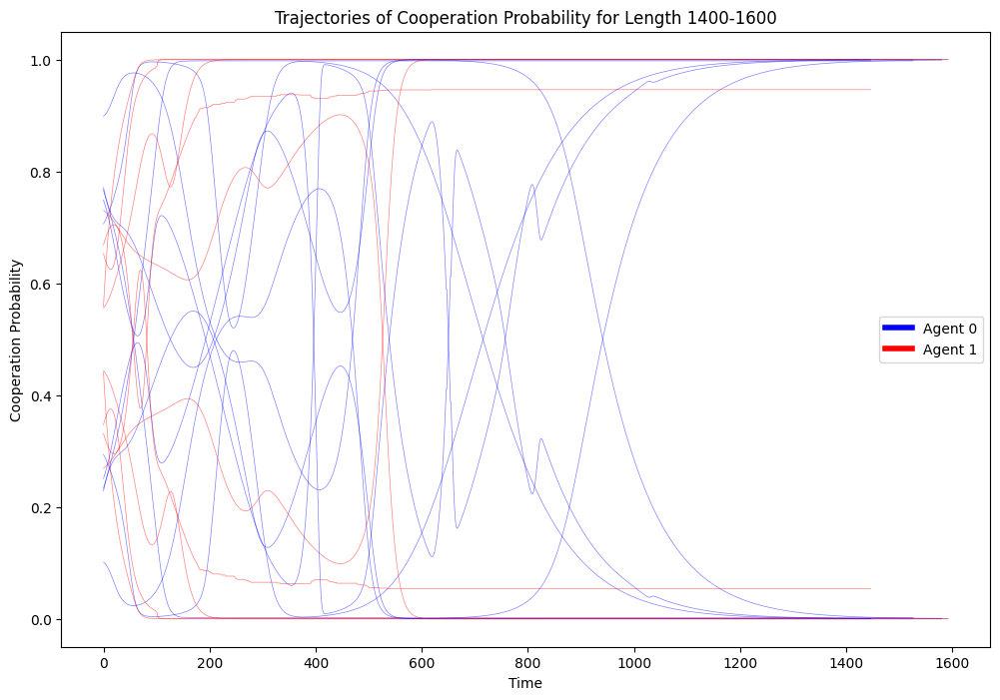

In [29]:
bins = [200, 400, 600, 800, 1000, 1200, 1400, 1600]
bin_labels = ['200-400', '400-600', '600-800', '800-1000', '1000-1200', '1200-1400', '1400-1600']

# Initialize a dictionary to hold categorized trajectories
categorized_trajectories = {label: [] for label in bin_labels}

# Categorize each trajectory based on its length
for series in strategy_time_series:
    length = len(series)
    for i, bin_edge in enumerate(bins):
        if length < bin_edge:
            category_label = bin_labels[i-1 if i != 0 else 0]
            categorized_trajectories[category_label].append(series)
            break

# Now, we have the trajectories categorized by length intervals
# Let's plot the trajectories for each interval
for category, trajectories in categorized_trajectories.items():
    if trajectories:  # Check if there are trajectories in this category
        plt.figure(figsize=(12, 8))
        plt.title(f'Trajectories of Cooperation Probability for Length {category}')
        plt.xlabel('Time')
        plt.ylabel('Cooperation Probability')
        
        for series in trajectories:
            plt.plot(series[:, variable_index, 0], color=colors['Agent 0'], alpha=0.5, linewidth=0.5)  # for Agent 0
            plt.plot(series[:, variable_index, 1], color=colors['Agent 1'], alpha=0.5, linewidth=0.5)  # for Agent 1
        
        plt.legend(custom_lines, ['Agent 0', 'Agent 1'])
        plt.show()


### Extreme case8: Agent0 is fully observable and agent1 partially blind about itself but remembers all of its own cooperation

In [141]:
ext_memo_ipd_8 = HistoryEmbedded(env, h=(2,2,2))

In [142]:
ext_memo_ipd_8.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [143]:
ext_memo_ipd_8.Oset[1] =    ['c,c,.|c,c,.|',
                             'c,c,.|c,.,.|',
                             'c,c,.|d,c,.|',
                             'c,c,.|d,.,.|',
                             'c,.,.|c,c,.|',
                             'c,.,.|c,.,.|',
                             'c,.,.|d,c,.|',
                             'c,.,.|d,.,.|',
                             'd,c,.|c,c,.|',
                             'd,c,.|c,.,.|',
                             'd,c,.|d,c,.|',
                             'd,c,.|d,.,.|',
                             'd,.,.|c,c,.|',
                             'd,.,.|c,.,.|',
                             'd,.,.|d,c,.|',
                             'd,.,.|d,.,.|']

In [144]:
ext_memo_ipd_8.Oset

[['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|'],
 ['c,c,.|c,c,.|',
  'c,c,.|c,.,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,.,.|',
  'c,.,.|c,c,.|',
  'c,.,.|c,.,.|',
  'c,.,.|d,c,.|',
  'c,.,.|d,.,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,.,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,.,.|',
  'd,.,.|c,c,.|',
  'd,.,.|c,.,.|',
  'd,.,.|d,c,.|',
  'd,.,.|d,.,.|']]

In [145]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
ext_memo_ipd_8.O[0] = generate_obs_matrix_from_obs_set(ext_memo_ipd_8.Oset[0])
ext_memo_ipd_8.O[1] = generate_obs_matrix_from_obs_set(ext_memo_ipd_8.Oset[1])

In [146]:
ext_memo_ipd_8.O

array([[[1.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 1.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 1.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.  , 1.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.  , 0.  , 1.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.  , 0.  , 0.  , 1.  , 0.  , 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 1.  , 0.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 1.  , 0.  , 0.  ,
         0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
        [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 1.  , 0.  ,
         0.

In [147]:
# Modify state set, so it represents the current game
ext_state_set_8 = []
for i in range(len(ext_memo_ipd_8.Oset[0])):
    ext_sub_set_8 = f"a0 = {ext_memo_ipd_8.Oset[0][i]} a1 = {ext_memo_ipd_8.Oset[1][i]}"
    ext_state_set_8.append(ext_sub_set_8)
ext_state_set_8

['a0 = c,c,.|c,c,.| a1 = c,c,.|c,c,.|',
 'a0 = c,c,.|c,d,.| a1 = c,c,.|c,.,.|',
 'a0 = c,c,.|d,c,.| a1 = c,c,.|d,c,.|',
 'a0 = c,c,.|d,d,.| a1 = c,c,.|d,.,.|',
 'a0 = c,d,.|c,c,.| a1 = c,.,.|c,c,.|',
 'a0 = c,d,.|c,d,.| a1 = c,.,.|c,.,.|',
 'a0 = c,d,.|d,c,.| a1 = c,.,.|d,c,.|',
 'a0 = c,d,.|d,d,.| a1 = c,.,.|d,.,.|',
 'a0 = d,c,.|c,c,.| a1 = d,c,.|c,c,.|',
 'a0 = d,c,.|c,d,.| a1 = d,c,.|c,.,.|',
 'a0 = d,c,.|d,c,.| a1 = d,c,.|d,c,.|',
 'a0 = d,c,.|d,d,.| a1 = d,c,.|d,.,.|',
 'a0 = d,d,.|c,c,.| a1 = d,.,.|c,c,.|',
 'a0 = d,d,.|c,d,.| a1 = d,.,.|c,.,.|',
 'a0 = d,d,.|d,c,.| a1 = d,.,.|d,c,.|',
 'a0 = d,d,.|d,d,.| a1 = d,.,.|d,.,.|']

In [148]:
# Generate agents
ext_mae_8 = POstratAC(env=ext_memo_ipd_8, learning_rates=0.1, discount_factors=0.9)

In [149]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = ext_mae_8.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = ext_mae_8.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('ext_wolf_strategy_time_series_1000_het_case8.npy', Xntisa_array)
np.save('ext_wolf_convergence_status_1000_het_case8.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [150]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [151]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 1000


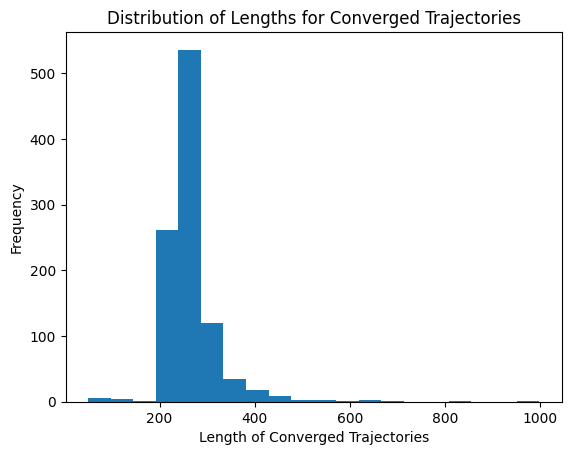

In [152]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Analyze the distribution of final strategies' lengths if necessary
plt.hist(length_n, bins=20)
plt.title('Distribution of Lengths for Converged Trajectories')
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.show()

In [153]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([], dtype=int64)

In [154]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [155]:
ext_mae_8.obsdist(x)

Array([[0.0798538 , 0.05374641, 0.06820119, 0.06072454, 0.07467896,
        0.09251019, 0.03777547, 0.04410011, 0.0703995 , 0.06856979,
        0.09171709, 0.04676638, 0.03759364, 0.0342384 , 0.07975893,
        0.05936556],
       [0.13508756, 0.05523389, 0.10385123, 0.03565004, 0.05523389,
        0.05523388, 0.03565004, 0.03565004, 0.10549998, 0.03510047,
        0.13818984, 0.0464727 , 0.03510047, 0.03510047, 0.0464727 ,
        0.0464727 ]], dtype=float32)

Text(0, 0.5, 'average reward')

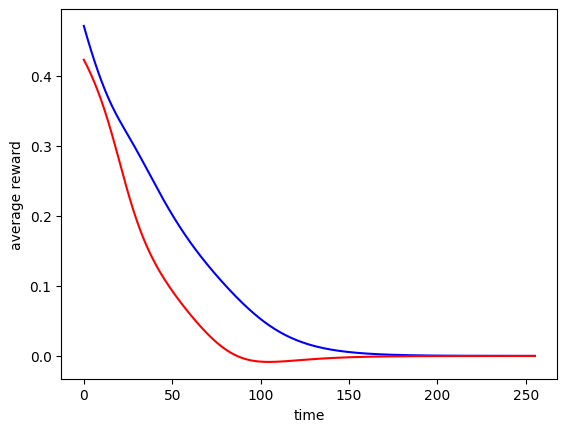

In [156]:
Rti = np.array([ext_mae_8.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

In [157]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(1000, 2, 16, 2)

In [158]:
finalRni = np.array([ext_mae_8.Ri(Xisa) for Xisa in finalXnisa])

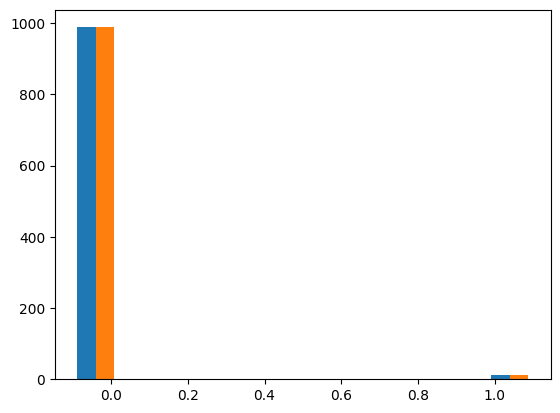

In [159]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [160]:
np.mean(finalRni[:,0] > 0.9) * 100

1.2

In [161]:
def load_simulation_data():
    # Load strategy time series and convergence data
    strategy_time_series = np.load('ext_wolf_strategy_time_series_1000_het_case8.npy', allow_pickle=True)
    return strategy_time_series

# Load the data
strategy_time_series = load_simulation_data()

In [276]:
## reward overall
    

In [1835]:
# Simulating some data for demonstration:
# Data has different lengths but two columns (dimensions) each
np.random.seed(0)
data1 =  Rti_3 
data2 = Rti_4
data3 = Rti_6

datasets = [data1, data2, data3, Rti_7, Rti_8]


In [1837]:
datasets

[array([[3.10333639e-01, 5.95872521e-01],
        [3.05382669e-01, 5.84830165e-01],
        [3.00651371e-01, 5.72978556e-01],
        [2.96151131e-01, 5.60288489e-01],
        [2.91892052e-01, 5.46735227e-01],
        [2.87882358e-01, 5.32301903e-01],
        [2.84127772e-01, 5.16981006e-01],
        [2.80631483e-01, 5.00776708e-01],
        [2.77392447e-01, 4.83707547e-01],
        [2.74405211e-01, 4.65808839e-01],
        [2.71659404e-01, 4.47133094e-01],
        [2.69138932e-01, 4.27753955e-01],
        [2.66821653e-01, 4.07765359e-01],
        [2.64679253e-01, 3.87281597e-01],
        [2.62677789e-01, 3.66436988e-01],
        [2.60777771e-01, 3.45382214e-01],
        [2.58935869e-01, 3.24280292e-01],
        [2.57105738e-01, 3.03303182e-01],
        [2.55240172e-01, 2.82622755e-01],
        [2.53292680e-01, 2.62407601e-01],
        [2.51219511e-01, 2.42814586e-01],
        [2.48981670e-01, 2.23983943e-01],
        [2.46546015e-01, 2.06033796e-01],
        [2.43886814e-01, 1.8905822

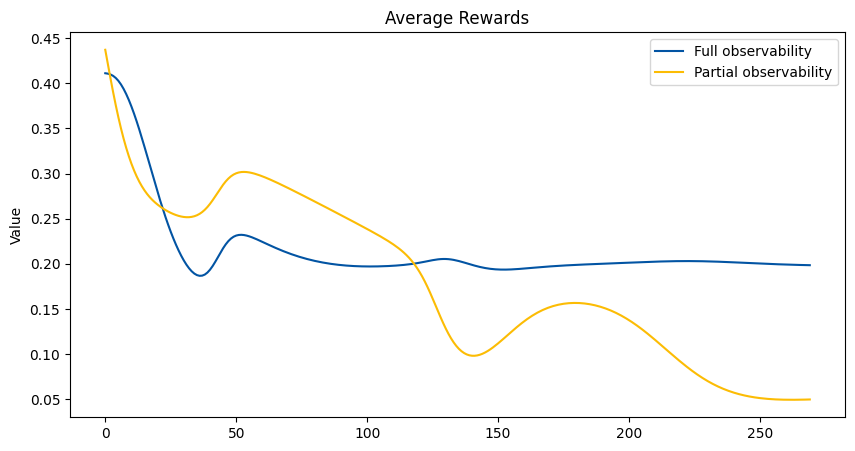

In [1836]:

# Step 1: Find the maximum length
max_length = max(data.shape[0] for data in datasets)

# Step 2: Pad datasets to have the same length
padded_datasets = []
for data in datasets:
    padding_needed = max_length - data.shape[0]
    if padding_needed > 0:
        # Pad with the last value repeated
        padding = np.repeat(data[-1:, :], padding_needed, axis=0)
        padded_data = np.vstack((data, padding))
    else:
        padded_data = data
    padded_datasets.append(padded_data)

# Convert list to numpy array
padded_datasets = np.array(padded_datasets)

# Step 3: Compute the average
average_data = np.mean(padded_datasets, axis=0)

# Plotting
plt.figure(figsize=(10, 5))
plt.plot(average_data[:270, 0], label='Full observability', color='#0254a3')  # Clip data at x=300
plt.plot(average_data[:270, 1], label='Partial observability', color='#fcbc04')  # Clip data at x=300
plt.title('Average Rewards')
plt.ylabel('Value')
plt.legend()
plt.show()

In [1840]:
def is_within_tolerance(value, target, tolerance):
    return abs(value - target) <= tolerance

def infer_agent_actions(rewards_agent0, rewards_agent1, R, T, S, P, tolerance):
    # Calculate the average payoff for the game based on the defined rewards
    average_payoff = (R + T + S + P) / 4

    # CC: Check whether both agents (mostly) cooperated
    if is_within_tolerance(rewards_agent0, R, tolerance) and  is_within_tolerance(rewards_agent1, R, tolerance):
        return 'C', 'C'
    # DD: Check whether both agents (mostly) defected
    elif is_within_tolerance(rewards_agent0, P, tolerance) and is_within_tolerance(rewards_agent1, P, tolerance):
        return 'D', 'D'
    # DC: Check whether a0 exploited a1
    elif is_within_tolerance(rewards_agent0, T, tolerance) or is_within_tolerance(rewards_agent0, R, tolerance) and is_within_tolerance(rewards_agent1, S, tolerance):
        return 'D', 'C'
    # CD: Check whether a1 exploited a0
    elif is_within_tolerance(rewards_agent1, T, tolerance) or is_within_tolerance(rewards_agent1, R, tolerance) and is_within_tolerance(rewards_agent0, S, tolerance):
        return 'C', 'D'
    # Ambiguous cases, cannot determine action
    elif is_within_tolerance(rewards_agent0, average_payoff, tolerance) or is_within_tolerance(rewards_agent1, average_payoff, tolerance):
        return None
    else:
        # If reward is not within tolerance of any payoff, action is undetermined
        return None
    
# Initialize lists to hold inferred actions
inferred_actions_agent0 = []
inferred_actions_agent1 = []

tolerance = 1.1

rewards_mean_agent0 = []
rewards_mean_agent1 = []
zero = 0
one = 0

for i in range(len(datasets[:, 0])):
    rewards_mean_agent0.append(datasets[i][0].mean())
    # print(Rti[:, 0][i].mean())
    zero += datasets[i][0].mean()
    rewards_mean_agent1.append(datasets[i][1].mean())
    # print(Rti[i][1].mean())
    one += datasets[i][1].mean()
    # print('-')
    
print(zero)
print(one)

# Iterate over each reward and infer actions for both agents
for reward0, reward1 in zip(rewards_mean_agent0, rewards_mean_agent1):
    actions = infer_agent_actions(reward0, reward1, R=1.0, T=1.2, S=-0.5, P=0.0, tolerance=tolerance)
    if actions is None:
        inferred_actions_agent0.append(None)
        inferred_actions_agent1.append(None)
    else:
        inferred_actions_agent0.append(actions[0])
        inferred_actions_agent1.append(actions[1])

# Output the results
for i in range(len(inferred_actions_agent0)):
    print(f"Game {i}: Agent0 likely average action: {inferred_actions_agent0[i]}, Agent1 likely average action: {inferred_actions_agent1[i]}")

TypeError: list indices must be integers or slices, not tuple

AttributeError: 'list' object has no attribute 'shape'

### Case7 but varying exploration

In [972]:
memo_ipd_7 = HistoryEmbedded(env, h=(2,2,2))

In [973]:
memo_ipd_7.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [974]:
memo_ipd_7.Oset[1] =    ['c,c,.|.,c,.|',
                         'c,c,.|.,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|.,c,.|',
                         'c,d,.|.,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|.,c,.|',
                         'd,c,.|.,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|.,c,.|',
                         'd,d,.|.,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [975]:
memo_ipd_7.Oset

[['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|'],
 ['c,c,.|.,c,.|',
  'c,c,.|.,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|.,c,.|',
  'c,d,.|.,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|.,c,.|',
  'd,c,.|.,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|.,c,.|',
  'd,d,.|.,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|']]

In [976]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_7.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_7.Oset[0])
memo_ipd_7.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_7.Oset[1])

In [977]:
memo_ipd_7.O

array([[[1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0

In [978]:
# Modify state set, so it represents the current game
state_set_7 = []
for i in range(len(memo_ipd_7.Oset[0])):
    sub_set_7 = f"a0 = {memo_ipd_7.Oset[0][i]} a1 = {memo_ipd_7.Oset[1][i]}"
    state_set_7.append(sub_set_7)
state_set_7

['a0 = c,c,.|c,c,.| a1 = c,c,.|.,c,.|',
 'a0 = c,c,.|c,d,.| a1 = c,c,.|.,d,.|',
 'a0 = c,c,.|d,c,.| a1 = c,c,.|d,c,.|',
 'a0 = c,c,.|d,d,.| a1 = c,c,.|d,d,.|',
 'a0 = c,d,.|c,c,.| a1 = c,d,.|.,c,.|',
 'a0 = c,d,.|c,d,.| a1 = c,d,.|.,d,.|',
 'a0 = c,d,.|d,c,.| a1 = c,d,.|d,c,.|',
 'a0 = c,d,.|d,d,.| a1 = c,d,.|d,d,.|',
 'a0 = d,c,.|c,c,.| a1 = d,c,.|.,c,.|',
 'a0 = d,c,.|c,d,.| a1 = d,c,.|.,d,.|',
 'a0 = d,c,.|d,c,.| a1 = d,c,.|d,c,.|',
 'a0 = d,c,.|d,d,.| a1 = d,c,.|d,d,.|',
 'a0 = d,d,.|c,c,.| a1 = d,d,.|.,c,.|',
 'a0 = d,d,.|c,d,.| a1 = d,d,.|.,d,.|',
 'a0 = d,d,.|d,c,.| a1 = d,d,.|d,c,.|',
 'a0 = d,d,.|d,d,.| a1 = d,d,.|d,d,.|']

In [1124]:
# Generate agents
mae_7 = POstratAC(env=memo_ipd_7, learning_rates=0.1, discount_factors=0.9, choice_intensities=1.15)

In [1125]:
# Number of simulations to run
num_simulations = 3000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_7.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_7.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case7.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case7.npy', Cn_array)

print("\nData saved successfully.")

Simulation 3000/3000...
Data saved successfully.


#### Experiments

In [1126]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

3000

In [1127]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 2979


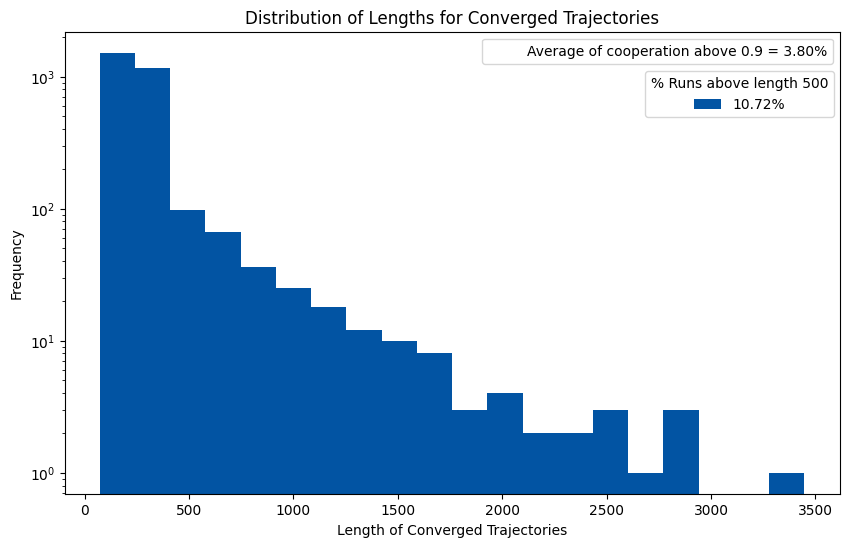

In [1128]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Plotting
plt.figure(figsize=(10, 6))
plt.hist(length_n, bins=20, log=True, color='#0254a3', label='10.72%')
plt.title('Distribution of Lengths for Converged Trajectories')
info_patch1 = plt.Line2D([0], [0], color='none', label='Average of cooperation above 0.9 = 3.80%')
first_legend = plt.legend(handles=[info_patch1], loc='upper right')
plt.gca().add_artist(first_legend)
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.legend(loc='upper left', bbox_to_anchor=(.74, .93), title="% Runs above length 500")
plt.savefig('distribution_full_obs.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI ensuring legend is included
plt.show()

In [1129]:
# Count the number of trajectories below length 520
below_520 = sum(1 for length in length_n if length < 500)

# Count the number of trajectories of length 520 or more
at_or_above_520 = len(length_n) - below_520

# Calculate percentage of each category
percentage_below_520 = (below_520 / len(length_n)) * 100
percentage_at_or_above_520 = (at_or_above_520 / len(length_n)) * 100

below_520, at_or_above_520, percentage_below_520, percentage_at_or_above_520


(2750, 229, 92.31285666330984, 7.687143336690165)

In [1130]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([ 164,  395,  787,  814,  964, 1240, 1302, 1352, 1652, 1792, 1812,
       1858, 1875, 2044, 2091, 2421, 2464, 2674, 2688, 2704, 2754])

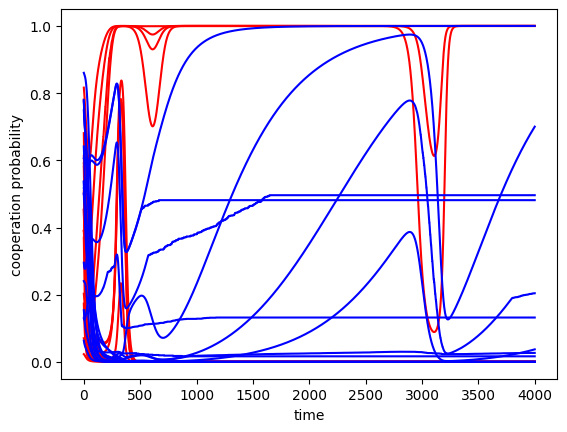

In [1131]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [1132]:
mae_7.obsdist(x)

Array([[0.0713696 , 0.05720941, 0.1173301 , 0.09521706, 0.07496566,
        0.07974649, 0.05425284, 0.03874275, 0.13240881, 0.06446216,
        0.02580883, 0.01470179, 0.06238207, 0.04628969, 0.03998982,
        0.02512289],
       [0.03568481, 0.0286047 , 0.1530149 , 0.12382175, 0.03748283,
        0.03987328, 0.09173564, 0.07861603, 0.06620439, 0.03223109,
        0.09201324, 0.04693288, 0.03119104, 0.02314485, 0.07118085,
        0.04826773]], dtype=float32)

Text(0, 0.5, 'average reward')

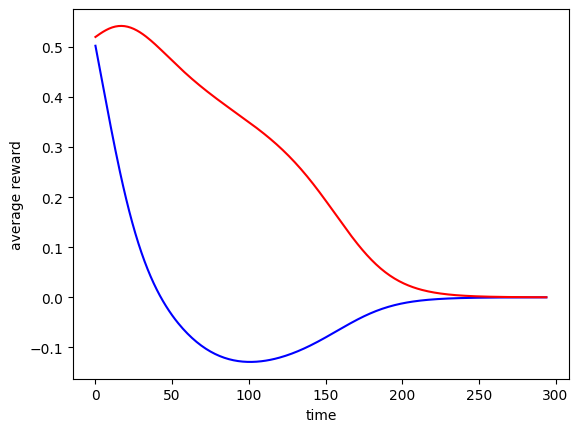

In [1133]:
Rti = np.array([mae_7.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

In [1134]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(2979, 2, 16, 2)

In [1135]:
finalRni = np.array([mae_7.Ri(Xisa) for Xisa in finalXnisa])

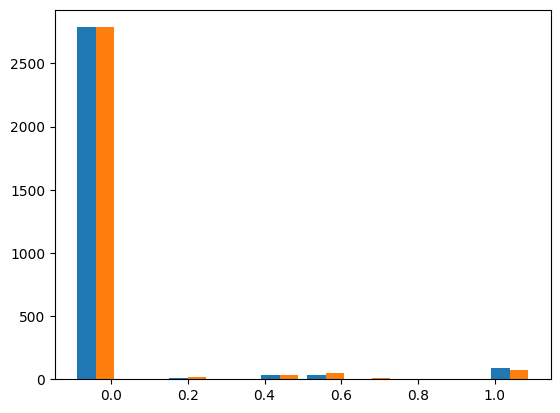

In [1136]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [1137]:
np.mean(finalRni[:,0] > 0.9) * 100
# 3.7449392712550607 0.5
# 4.518072289156627 0.75 4.048582995951417 3.831932773109244 = 4.13 (3.225806451612903) 3.861788617886179 3.2355915065722956
# 4.518072289156627 + 4.048582995951417 + 3.861788617886179 + 3.2355915065722956 = 3.91

##########
#0.85
#4.395973154362416

### 
#1.15
#3.18

3.1889895938234303

In [1139]:
np.mean(finalRni[:,1] > 0.9) * 100
# 2.631578947368421 0.5
# 3.91566265060241 0.75 3.54251012145749 2.8907563025210083 = 3.44 (2.0161290322580645) 3.556910569105691 2.3255813953488373

#####
#0.85
#3.2885906040268456
##
#1.15
#2.45

2.450486740516952

avg for run with 300 = 3.78 pretty close to my old val, but 
im suspecting the value might be in multiple initializations

In [1076]:
Rti_7 = Rti

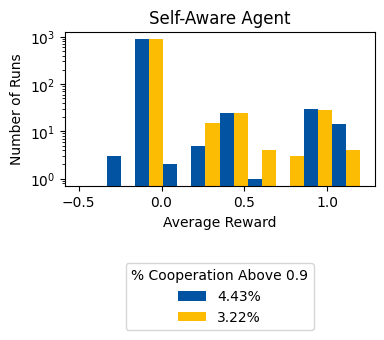

In [625]:
plt.figure(figsize=(4, 2)) 
plt.hist([(finalRni[:,0]), (finalRni[:,1])], color=['#0254a3', '#fcbc04'], label=['4.43%','3.22%'], range=(-.5, 1.2), rwidth=35, log=True)
plt.title('Self-Aware Agent')
plt.legend(loc='center', bbox_to_anchor=(.5, -0.72), title="% Cooperation Above 0.9")
plt.savefig('filename.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI
plt.xlabel('Average Reward');
plt.ylabel('Number of Runs');

### case6 but varying exploration

In [1140]:
memo_ipd_6 = HistoryEmbedded(env, h=(2,2,2))

In [1141]:
memo_ipd_6.Oset[0] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|d,c,.|',
                         'c,c,.|d,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|d,c,.|',
                         'c,d,.|d,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|d,c,.|',
                         'd,c,.|d,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|d,c,.|',
                         'd,d,.|d,d,.|']

In [1142]:
memo_ipd_6.Oset[1] =    ['c,c,.|c,c,.|',
                         'c,c,.|c,d,.|',
                         'c,c,.|.,c,.|',
                         'c,c,.|.,d,.|',
                         'c,d,.|c,c,.|',
                         'c,d,.|c,d,.|',
                         'c,d,.|.,c,.|',
                         'c,d,.|.,d,.|',
                         'd,c,.|c,c,.|',
                         'd,c,.|c,d,.|',
                         'd,c,.|.,c,.|',
                         'd,c,.|.,d,.|',
                         'd,d,.|c,c,.|',
                         'd,d,.|c,d,.|',
                         'd,d,.|.,c,.|',
                         'd,d,.|.,d,.|']

In [1143]:
memo_ipd_6.Oset

[['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|d,c,.|',
  'c,c,.|d,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|d,c,.|',
  'c,d,.|d,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|d,c,.|',
  'd,c,.|d,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|d,c,.|',
  'd,d,.|d,d,.|'],
 ['c,c,.|c,c,.|',
  'c,c,.|c,d,.|',
  'c,c,.|.,c,.|',
  'c,c,.|.,d,.|',
  'c,d,.|c,c,.|',
  'c,d,.|c,d,.|',
  'c,d,.|.,c,.|',
  'c,d,.|.,d,.|',
  'd,c,.|c,c,.|',
  'd,c,.|c,d,.|',
  'd,c,.|.,c,.|',
  'd,c,.|.,d,.|',
  'd,d,.|c,c,.|',
  'd,d,.|c,d,.|',
  'd,d,.|.,c,.|',
  'd,d,.|.,d,.|']]

In [1144]:
# Use the above function to define a new observation matrix and output the result into the agent
# previously modified
memo_ipd_6.O[0] = generate_obs_matrix_from_obs_set(memo_ipd_6.Oset[0])
memo_ipd_6.O[1] = generate_obs_matrix_from_obs_set(memo_ipd_6.Oset[1])

In [1145]:
# Checking the observation set
len(memo_ipd_6.Sset)

16

In [1146]:
memo_ipd_6.O

array([[[1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 1. , 0. , 0. ,
         0. , 0. , 0. , 0. ],
        [0

In [1147]:
# Modify state set, so it represents the current game
state_set_6 = []
for i in range(len(memo_ipd_6.Oset[0])):
    sub_set_6 = f"a0 = {memo_ipd_6.Oset[0][i]} a1 = {memo_ipd_6.Oset[1][i]}"
    state_set_6.append(sub_set_6)
state_set_6

['a0 = c,c,.|c,c,.| a1 = c,c,.|c,c,.|',
 'a0 = c,c,.|c,d,.| a1 = c,c,.|c,d,.|',
 'a0 = c,c,.|d,c,.| a1 = c,c,.|.,c,.|',
 'a0 = c,c,.|d,d,.| a1 = c,c,.|.,d,.|',
 'a0 = c,d,.|c,c,.| a1 = c,d,.|c,c,.|',
 'a0 = c,d,.|c,d,.| a1 = c,d,.|c,d,.|',
 'a0 = c,d,.|d,c,.| a1 = c,d,.|.,c,.|',
 'a0 = c,d,.|d,d,.| a1 = c,d,.|.,d,.|',
 'a0 = d,c,.|c,c,.| a1 = d,c,.|c,c,.|',
 'a0 = d,c,.|c,d,.| a1 = d,c,.|c,d,.|',
 'a0 = d,c,.|d,c,.| a1 = d,c,.|.,c,.|',
 'a0 = d,c,.|d,d,.| a1 = d,c,.|.,d,.|',
 'a0 = d,d,.|c,c,.| a1 = d,d,.|c,c,.|',
 'a0 = d,d,.|c,d,.| a1 = d,d,.|c,d,.|',
 'a0 = d,d,.|d,c,.| a1 = d,d,.|.,c,.|',
 'a0 = d,d,.|d,d,.| a1 = d,d,.|.,d,.|']

In [1733]:
# Generate agents
mae_6 = POstratAC(env=memo_ipd_6, learning_rates=0.1, discount_factors=0.9, choice_intensities=1.35)

In [1734]:
# Number of simulations to run
num_simulations = 1000

# Initialize storage for strategy time-series and convergence statuses
Xntisa = []  # Strategy time-series: n stands for simulation run
Cn = []  # Converged?

for i in range(num_simulations):
    print(f"\rSimulation {i+1}/{num_simulations}...", end='')
    x = mae_6.random_softmax_strategy()

    # Get the trajectory and final probability distribution
    Xtisa, fixpoinreach = mae_6.trajectory(x, Tmax=4000, tolerance=10e-6)

    Xntisa.append(Xtisa)
    Cn.append(fixpoinreach)

# Convert lists to numpy arrays for saving
Xntisa_array = np.array(Xntisa, dtype=object)
Cn_array = np.array(Cn, dtype=object)

# Save the data to files
np.save('wolf_strategy_time_series_1000_het_case6.npy', Xntisa_array)
np.save('wolf_convergence_status_1000_het_case6.npy', Cn_array)

print("\nData saved successfully.")

Simulation 1000/1000...
Data saved successfully.


#### Experiments

In [1735]:
# Assuming `Xntisa` and `Cn` are loaded or computed already
num_simulations = len(Cn)
num_simulations

1000

In [1736]:
# Summarize how many simulations converged
print("Number of converged simulations:", np.sum(Cn))

Number of converged simulations: 985


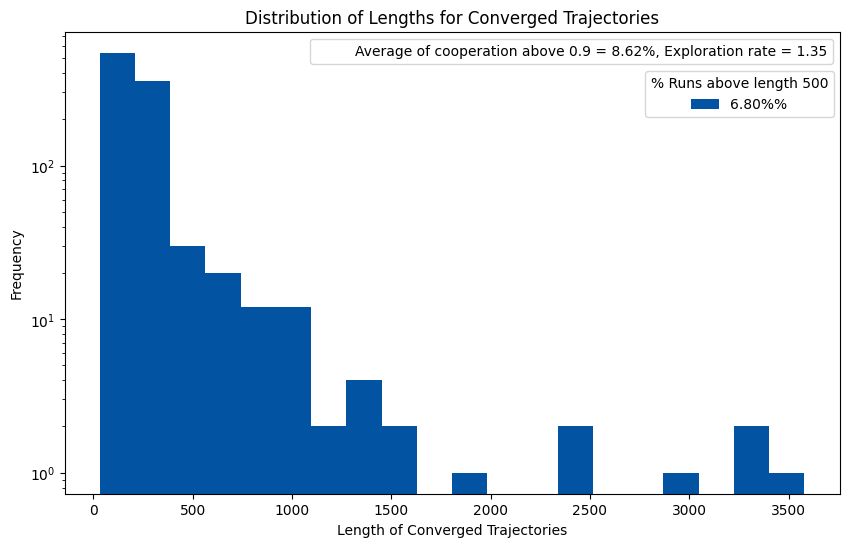

(918, 67, 93.19796954314721, 6.802030456852792)

In [1750]:
# Filter out the simulations that converged and extract the final strategy of each
finalXnisa = [Xntisa[n][-1] for n in range(num_simulations) if Cn[n]]
length_n = [len(Xntisa[n]) for n in range(num_simulations) if Cn[n]]

# Convert list of final strategies to a numpy array
finalXnisa = np.array(finalXnisa, dtype=object)

# Plotting
plt.figure(figsize=(10, 6))
plt.hist(length_n, bins=20, log=True, color='#0254a3', label='6.80%%')
plt.title('Distribution of Lengths for Converged Trajectories')
info_patch1 = plt.Line2D([0], [0], color='none', label='Average of cooperation above 0.9 = 8.62%, Exploration rate = 1.35')
first_legend = plt.legend(handles=[info_patch1], loc='upper right')
# first_legend_2 = plt.legend(handles=[info_patch2], loc='upper right')
plt.gca().add_artist(first_legend)
# plt.gca().add_artist(first_legend_2)
plt.xlabel('Length of Converged Trajectories')
plt.ylabel('Frequency')
plt.legend(loc='upper left', bbox_to_anchor=(.74, .93), title="% Runs above length 500")
plt.savefig('distribution_full_obs.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI ensuring legend is included
plt.show()

(918, 67, 93.19796954314721, 6.802030456852792)

In [1738]:
non_converged_runs = np.where(np.logical_not(Cn))[0]
non_converged_runs

array([105, 141, 175, 241, 353, 378, 385, 602, 665, 678, 710, 786, 877,
       896, 968])

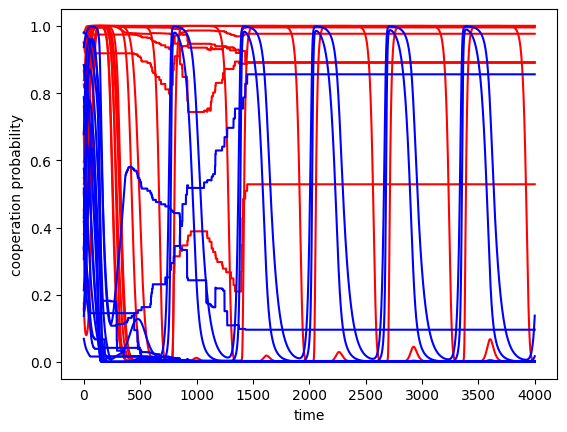

In [1739]:
if len(non_converged_runs) > 0:
    plt.plot(Xntisa[non_converged_runs[-1]][:, 1, :, 0], color='red', label='agent1')
    plt.plot(Xntisa[non_converged_runs[-1]][:, 0, :, 0], color='blue', label='agent0')
    plt.xlabel('time'); plt.ylabel('cooperation probability')

In [1740]:
mae_6.obsdist(x)

Array([[0.08257752, 0.05044324, 0.08034677, 0.04337825, 0.03046178,
        0.05752883, 0.06087409, 0.07423931, 0.07456142, 0.04946674,
        0.09717655, 0.0657014 , 0.0691451 , 0.0656652 , 0.04850877,
        0.04992504],
       [0.12275093, 0.07213236, 0.04017339, 0.02168914, 0.06089883,
        0.09464846, 0.03043705, 0.03711966, 0.12314972, 0.08231744,
        0.04858829, 0.03285072, 0.09339942, 0.0906277 , 0.02425439,
        0.02496252]], dtype=float32)

Text(0, 0.5, 'average reward')

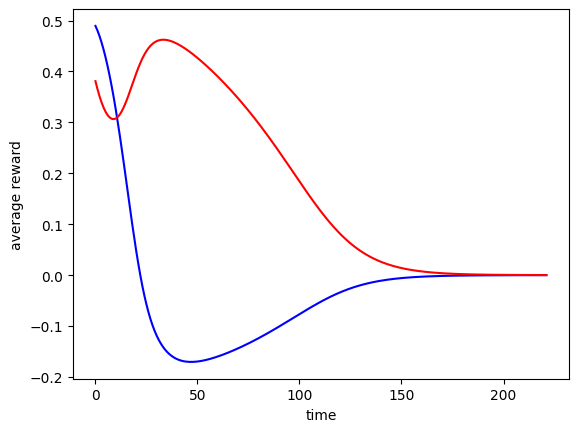

In [1741]:
Rti = np.array([mae_6.Ri(x) for x in Xtisa])
plt.plot(Rti[:, 0], color='blue', label='agent0')
plt.plot(Rti[:, 1], color='red', label='agent1')
plt.xlabel('time'); plt.ylabel('average reward')

In [1753]:
len(Rti[:, 1])

222

In [1779]:
def is_within_tolerance(value, target, tolerance):
    return abs(value - target) <= tolerance

def infer_agent_actions(rewards_agent0, rewards_agent1, R, T, S, P, tolerance):
    # Calculate the average payoff for the game based on the defined rewards
    average_payoff = (R + T + S + P) / 4

    # CC: Check whether both agents (mostly) cooperated
    if is_within_tolerance(rewards_agent0, R, tolerance) and  is_within_tolerance(rewards_agent1, R, tolerance):
        return 'C', 'C'
    # DD: Check whether both agents (mostly) defected
    elif is_within_tolerance(rewards_agent0, P, tolerance) and is_within_tolerance(rewards_agent1, P, tolerance):
        return 'D', 'D'
    # DC: Check whether a0 exploited a1
    elif is_within_tolerance(rewards_agent0, T, tolerance) or is_within_tolerance(rewards_agent0, R, tolerance) and is_within_tolerance(rewards_agent1, S, tolerance):
        return 'D', 'C'
    # CD: Check whether a1 exploited a0
    elif is_within_tolerance(rewards_agent1, T, tolerance) or is_within_tolerance(rewards_agent1, R, tolerance) and is_within_tolerance(rewards_agent0, S, tolerance):
        return 'C', 'D'
    # Ambiguous cases, cannot determine action
    elif is_within_tolerance(rewards_agent0, average_payoff, tolerance) or is_within_tolerance(rewards_agent1, average_payoff, tolerance):
        return None
    else:
        # If reward is not within tolerance of any payoff, action is undetermined
        return None
    
# Initialize lists to hold inferred actions
inferred_actions_agent0 = []
inferred_actions_agent1 = []

tolerance = 1.1

rewards_mean_agent0 = []
rewards_mean_agent1 = []
zero = 0
one = 0

for i in range(len(Rti[:, 0])):
    rewards_mean_agent0.append(Rti[:, 0][i].mean())
    # print(Rti[:, 0][i].mean())
    zero += Rti[:, 0][i].mean()
    rewards_mean_agent1.append(Rti[:, 1][i].mean())
    # print(Rti[:, 1][i].mean())
    one += Rti[:, 1][i].mean()
    # print('-')
    
print(zero)
print(one)

# Iterate over each reward and infer actions for both agents
for reward0, reward1 in zip(rewards_mean_agent0, rewards_mean_agent1):
    actions = infer_agent_actions(reward0, reward1, R=1.0, T=1.2, S=-0.5, P=0.0, tolerance=tolerance)
    if actions is None:
        inferred_actions_agent0.append(None)
        inferred_actions_agent1.append(None)
    else:
        inferred_actions_agent0.append(actions[0])
        inferred_actions_agent1.append(actions[1])

# Output the results
for i in range(len(inferred_actions_agent0)):
    print(f"Game {i}: Agent0 likely average action: {inferred_actions_agent0[i]}, Agent1 likely average action: {inferred_actions_agent1[i]}")

-5.539416231018549
40.12098242952925
Game 0: Agent0 likely average action: C, Agent1 likely average action: C
Game 1: Agent0 likely average action: C, Agent1 likely average action: C
Game 2: Agent0 likely average action: C, Agent1 likely average action: C
Game 3: Agent0 likely average action: C, Agent1 likely average action: C
Game 4: Agent0 likely average action: C, Agent1 likely average action: C
Game 5: Agent0 likely average action: C, Agent1 likely average action: C
Game 6: Agent0 likely average action: C, Agent1 likely average action: C
Game 7: Agent0 likely average action: C, Agent1 likely average action: C
Game 8: Agent0 likely average action: C, Agent1 likely average action: C
Game 9: Agent0 likely average action: C, Agent1 likely average action: C
Game 10: Agent0 likely average action: C, Agent1 likely average action: C
Game 11: Agent0 likely average action: C, Agent1 likely average action: C
Game 12: Agent0 likely average action: C, Agent1 likely average action: C
Game 13: Ag

In [1773]:
Rti_6 = Rti

In [1743]:
Rti_6.shape

(222, 2)

In [1744]:
finalXnisa = []
length_n = []
for n in range(num_simulations):
    if Cn[n]:
        finalXnisa.append(Xntisa[n][-1])
        length_n.append(len(Xntisa[n]))
finalXnisa = np.array(finalXnisa)
finalXnisa.shape

(985, 2, 16, 2)

In [1745]:
finalRni = np.array([mae_6.Ri(Xisa) for Xisa in finalXnisa])

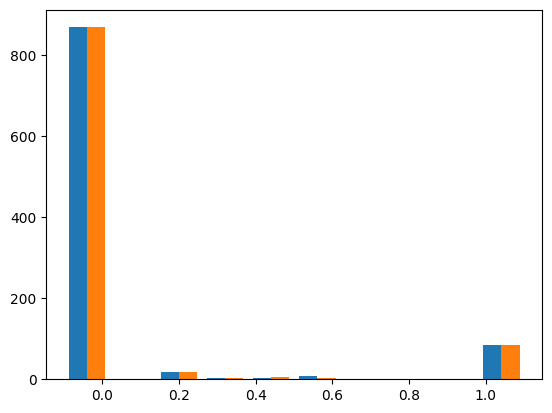

In [1746]:
plt.hist([finalRni[:,0], finalRni[:,1]], range=(-0.1,1.1));

**Percentage going to cooperation:**

In [1747]:
# Count the number of trajectories below length 520
below_520 = sum(1 for length in length_n if length < 500)

# Count the number of trajectories of length 520 or more
at_or_above_520 = len(length_n) - below_520

# Calculate percentage of each category
percentage_below_520 = (below_520 / len(length_n)) * 100
percentage_at_or_above_520 = (at_or_above_520 / len(length_n)) * 100

below_520, at_or_above_520, percentage_below_520, percentage_at_or_above_520


(918, 67, 93.19796954314721, 6.802030456852792)

In [1748]:
np.mean(finalRni[:,0] > 0.9) * 100
# 6.729066531748039 0.85 4000runs
# 5.482897384305835 0.75 4k [(3407, 544, 86.2313338395343, 13.768666160465706) 7.94735509997469]
# 7.784278809463241 1.15 [(3651, 304, 92.31352718078382, 7.686472819216182) 8.192161820480406]
# 6.826286296484972 1.25
# 1.05 7.8233927188226176
# 1 [8.029381965552178 (3628, 320, 91.89463019250253, 8.105369807497468)]
# 1.35 
    # 7.669021190716448 (927, 64, 93.54187689202826, 6.458123107971746)
    # 7.801418439716312=>(919, 68, 93.11043566362716, 6.889564336372847)
    # 7.028112449799197=(926, 70, 92.9718875502008, 7.028112449799197)
    # 8.37326607818411=>(3731, 234, 94.09836065573771, 5.901639344262295)
    # 8.924949290060852 (931, 55, 94.42190669371196, 5.578093306288032)
    # 9.219858156028367 (916, 71, 92.806484295846, 7.193515704154002)
    # 9.837728194726166 (780, 206, 79.10750507099391, 20.892494929006087)
# 7.786885245901639 (40, 936, 4.098360655737705, 95.90163934426229)
# 8.805668016194332 (796, 192, 80.5668016194332, 19.4331983805668)
# 8.859470468431772 (767, 215, 78.10590631364562, 21.89409368635438)

8.629441624365482

In [1749]:
np.mean(finalRni[:,1] > 0.9) * 100
# 7.032633442954718 0.85 4000 runs
# 5.6086519114688125 0.75 4k [(3407, 544, 86.2313338395343, 13.768666160465706) 8.14983548468742]
# 7.453574154159247 1.15 [(3651, 304, 92.31352718078382, 7.686472819216182) 7.812895069532237]
# 6.724401426388181 1.25
# 1.05 7.72011360702298
# 1 [8.105369807497468 (3628, 320, 91.89463019250253, 8.105369807497468)]
# 1.35 
    # 7.193515704154002 (919, 68, 93.11043566362716, 6.889564336372847)
    # 7.83132530120482=(926, 70, 92.9718875502008, 7.028112449799197)
    # 7.801418439716312 (916, 71, 92.806484295846, 7.193515704154002)
    # 8.072653884964682 (927, 64, 93.54187689202826, 6.458123107971746)
    # 8.02017654476671=>(3731, 234, 94.09836065573771, 5.901639344262295)
    # 8.620689655172415 (931, 55, 94.42190669371196, 5.578093306288032)
    # 10.851926977687627 (780, 206, 79.10750507099391, 20.892494929006087)
# 7.069672131147541 (40, 936, 4.098360655737705, 95.90163934426229)
# 8.19838056680162 (796, 192, 80.5668016194332, 19.4331983805668)
# 7.841140529531568 (767, 215, 78.10590631364562, 21.89409368635438)

# Though the exploration rate seems to affect the convergence of optimization functions
# with higher exploration rates bringing shorter optimization paths
# and lower exploration bringing longer
# the probability for cooperation don't vary according to the exploration rate at multi observability envs

8.629441624365482

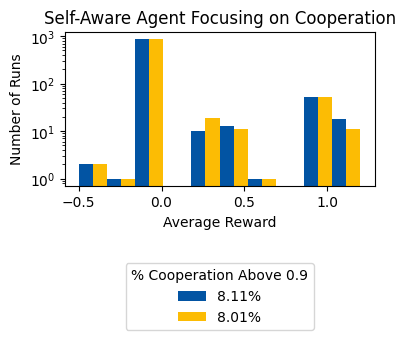

In [890]:
plt.figure(figsize=(4, 2)) 
plt.hist([(finalRni[:,0]), (finalRni[:,1])], color=['#0254a3', '#fcbc04'], label=['8.11%','8.01%'], range=(-.5, 1.2), rwidth=35, log=True)
plt.title('Self-Aware Agent Focusing on Cooperation')
plt.legend(loc='center', bbox_to_anchor=(.5, -0.72), title="% Cooperation Above 0.9")
plt.savefig('filename.png', dpi=300, bbox_inches='tight')  # Save the figure at 300 DPI
plt.xlabel('Average Reward');
plt.ylabel('Number of Runs');